In [3]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
'''for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))
'''
# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

"for dirname, _, filenames in os.walk('/kaggle/input'):\n    for filename in filenames:\n        print(os.path.join(dirname, filename))\n"

# Libraries

In [114]:
# Core libraries
import numpy as np
import pandas as pd
import math
import os, shutil
# Dataset download
import kagglehub
# Visualization
import matplotlib.pyplot as plt
import seaborn as sns

import random
from PIL import Image
from tqdm import tqdm  # for checking currupt images
import cv2 # for image quality
import random

from sklearn.feature_selection import mutual_info_classif, RFE, SelectKBest, f_classif
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.metrics import classification_report, accuracy_score, roc_auc_score, precision_score, recall_score, precision_score, confusion_matrix, roc_curve, auc

import torch
import torch.nn as nn
from torchvision import transforms, models  #PyTorch
from torch.utils.data import Dataset, DataLoader,WeightedRandomSampler
import torch.optim as optim
from torch.optim.lr_scheduler import ReduceLROnPlateau, StepLR, CosineAnnealingLR
import torch.nn.functional as F
import optuna

from torchvision.models import efficientnet_b0
from torchvision.models import densenet121

#documentation
!pip install python-docx
from docx import Document
from docx.shared import Inches, Pt
from docx.enum.text import WD_ALIGN_PARAGRAPH




# Load Dataset

In [4]:
# Download the dataset
path = kagglehub.dataset_download("navoneel/brain-mri-images-for-brain-tumor-detection")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/brain-mri-images-for-brain-tumor-detection


In [5]:
os.makedirs("results/tables", exist_ok=True)
os.makedirs("results/plots", exist_ok=True)

In [6]:
print(os.listdir(path))

['no', 'yes', 'brain_tumor_dataset']


In [7]:
# Define your dataset path
dataset_path = os.path.join(path, 'brain_tumor_dataset')

# Initialize list to hold image info
image_data = []


valid_extensions = ('.jpg', '.jpeg', '.png', '.bmp', '.tif', '.tiff')
# Loop through both folders
for label in ['yes', 'no']:
    folder_path = os.path.join(dataset_path, label)
    for filename in os.listdir(folder_path):
        if filename.lower().endswith(valid_extensions):
            image_data.append({
                'filename': filename.strip(),  # removes leading/trailing spaces
                'label': label,
                'path': os.path.join(folder_path, filename.strip())  # Add full path here
            })

# Convert to DataFrame
df = pd.DataFrame(image_data)

# Preview the first few rows
print(df.head())

# Save to CSV for reporting
head_table_path = "results/tables/image_data_head.csv"
df.head().to_csv(head_table_path, index=False)

print(f"✅ Image data head saved: {head_table_path}")


   filename label                                               path
0  Y115.JPG   yes  /kaggle/input/brain-mri-images-for-brain-tumor...
1  Y192.JPG   yes  /kaggle/input/brain-mri-images-for-brain-tumor...
2  Y162.jpg   yes  /kaggle/input/brain-mri-images-for-brain-tumor...
3    Y9.jpg   yes  /kaggle/input/brain-mri-images-for-brain-tumor...
4  Y108.jpg   yes  /kaggle/input/brain-mri-images-for-brain-tumor...
✅ Image data head saved: results/tables/image_data_head.csv


In [8]:
df.shape

(253, 3)

In [9]:
# Shuffle the dataframe
df = df.sample(frac=1, random_state=42).reset_index(drop=True)
# Preview the first few rows
print(df.head())

   filename label                                               path
0   N17.jpg    no  /kaggle/input/brain-mri-images-for-brain-tumor...
1  Y106.jpg   yes  /kaggle/input/brain-mri-images-for-brain-tumor...
2  Y164.JPG   yes  /kaggle/input/brain-mri-images-for-brain-tumor...
3  no 2.jpg    no  /kaggle/input/brain-mri-images-for-brain-tumor...
4   Y10.jpg   yes  /kaggle/input/brain-mri-images-for-brain-tumor...


In [10]:
# Encode diagnosis: B=0 (benign), M=1 (malignant)
#df_encoded = df.copy()
df["label"] = df["label"].map({"no":0, "yes":1})
# Preview the first few rows
print(df.head())

   filename  label                                               path
0   N17.jpg      0  /kaggle/input/brain-mri-images-for-brain-tumor...
1  Y106.jpg      1  /kaggle/input/brain-mri-images-for-brain-tumor...
2  Y164.JPG      1  /kaggle/input/brain-mri-images-for-brain-tumor...
3  no 2.jpg      0  /kaggle/input/brain-mri-images-for-brain-tumor...
4   Y10.jpg      1  /kaggle/input/brain-mri-images-for-brain-tumor...


# EDA (Exploratory Data Analysis)

**Class Distribution**

In [11]:
df['label'].value_counts()
# Save class distribution (diagnosis counts)
class_dist_path = "results/tables/class_distribution.csv"
df["label"].value_counts().to_csv(class_dist_path)

print(f"✅ Class distribution saved: {class_dist_path}")
print(df["label"].value_counts())

✅ Class distribution saved: results/tables/class_distribution.csv
label
1    155
0     98
Name: count, dtype: int64


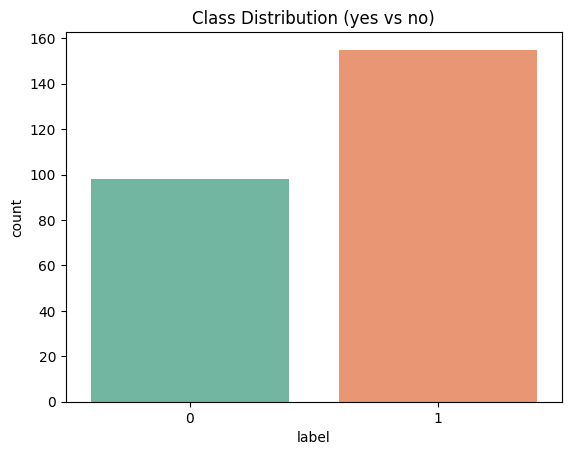

In [12]:
# Create the plots directory if it doesn't exist
os.makedirs("results/plots", exist_ok=True)

# Plot
sns.countplot(data=df, x="label", palette="Set2")
plt.title("Class Distribution (yes vs no)")
# Remove legend if you don't want it
plt.legend().remove()
# Save plot as PNG to 'plots' folder
plt.savefig("results/plots/class_distribution.png", dpi=300, bbox_inches="tight")

# Show plot
plt.show()

**Visualizing Random Samples**

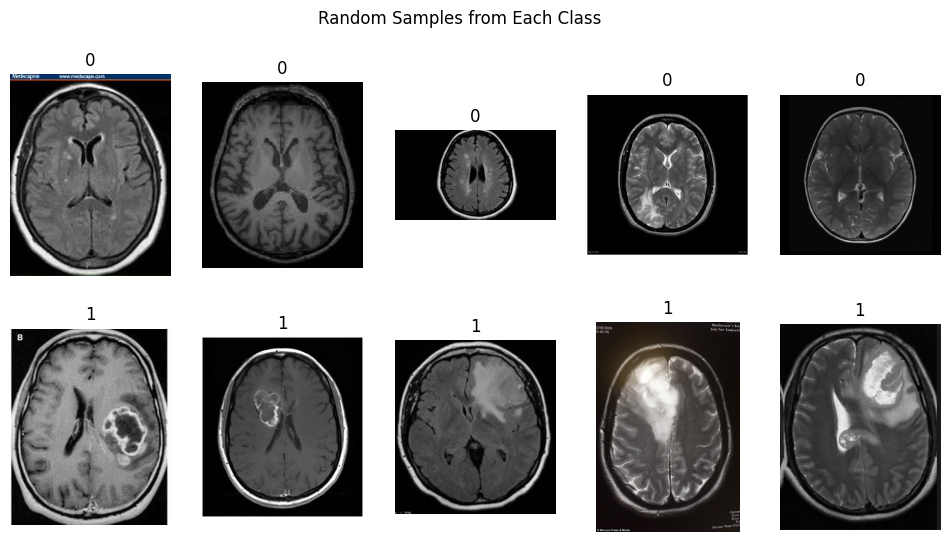

In [13]:
fig, axes = plt.subplots(2, 5, figsize=(12, 6))
labels = df['label'].unique()

for i, label in enumerate(labels):
    sample_df = df[df['label'] == label].sample(5, random_state=42)
    for j, file in enumerate(sample_df['path'].values):
        img = Image.open(file)
        axes[i, j].imshow(img, cmap='gray')
        axes[i, j].set_title(label)
        axes[i, j].axis('off')

plt.suptitle("Random Samples from Each Class")
plt.show()

**Analyzing different resolutions**

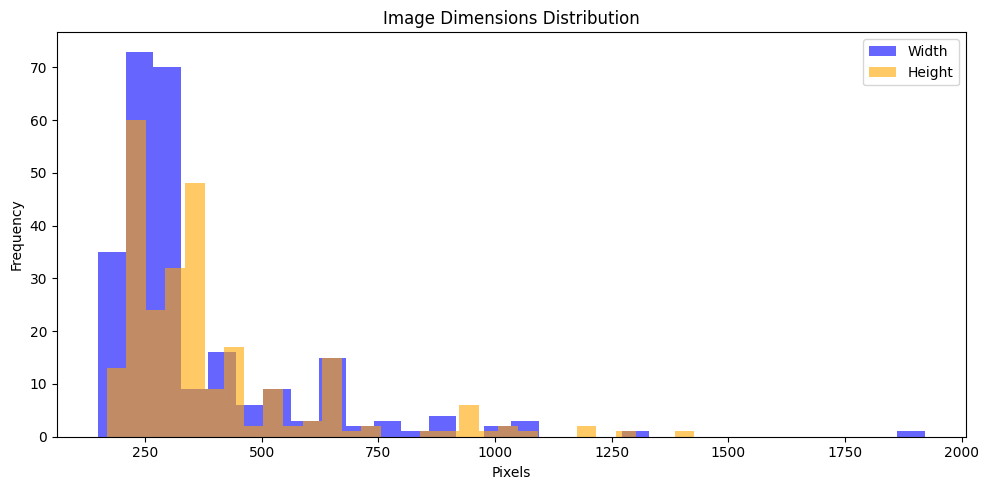

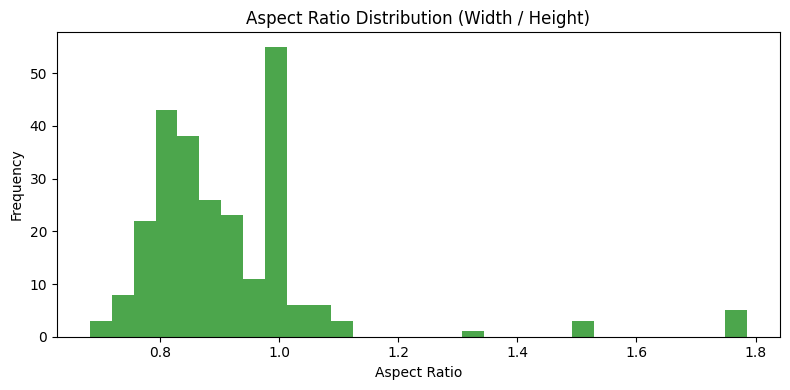

In [14]:
df['size'] = df['path'].apply(lambda x: Image.open(x).size)
df['width'], df['height'] = zip(*df['size'])
# Calculate aspect ratio
df['aspect_ratio'] = df['width'] / df['height']

plt.figure(figsize=(10, 5))

# Plot width distribution
plt.hist(df['width'], bins=30, alpha=0.6, color='blue', label='Width')

# Plot height distribution
plt.hist(df['height'], bins=30, alpha=0.6, color='orange', label='Height')

plt.title("Image Dimensions Distribution")
plt.xlabel("Pixels")
plt.ylabel("Frequency")
plt.legend()
plt.tight_layout()
plt.savefig("results/plots/image_dimensions_distribution.png", dpi=300, bbox_inches="tight")
plt.show()

# Plot aspect ratio distribution
plt.figure(figsize=(8, 4))
plt.hist(df['aspect_ratio'], bins=30, color='green', alpha=0.7)
plt.title("Aspect Ratio Distribution (Width / Height)")
plt.xlabel("Aspect Ratio")
plt.ylabel("Frequency")
plt.tight_layout()
plt.savefig("results/plots/aspect_ratio_distribution.png", dpi=300, bbox_inches="tight")
plt.show()


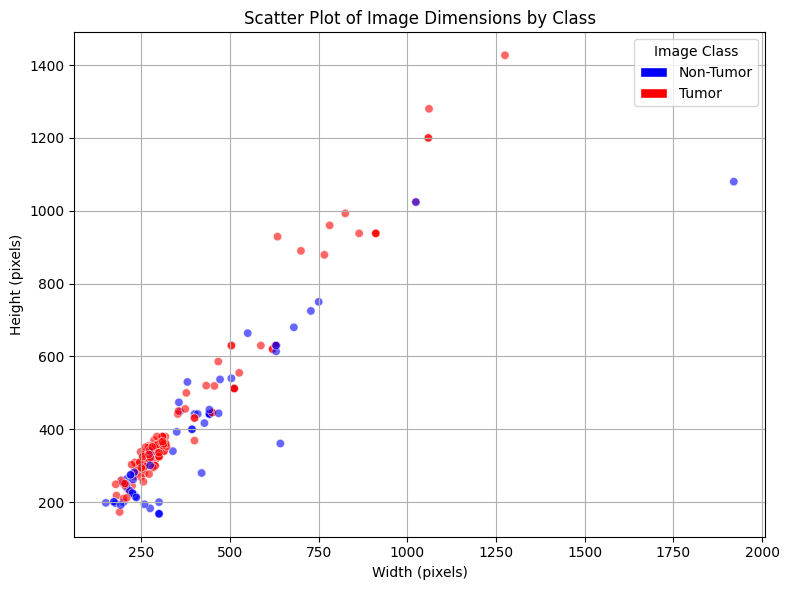

In [15]:
# Define color map based on label
colors = df['label'].map({0: 'blue', 1: 'red'})  # Non-tumor: blue, Tumor: red

# Scatter plot of width vs. height with color-coded labels
plt.figure(figsize=(8, 6))
scatter = plt.scatter(df['width'], df['height'], c=colors, alpha=0.6, edgecolors='w', linewidths=0.5)

# Create custom legend
from matplotlib.patches import Patch
legend_elements = [Patch(facecolor='blue', edgecolor='w', label='Non-Tumor'),
                   Patch(facecolor='red', edgecolor='w', label='Tumor')]
plt.legend(handles=legend_elements, title="Image Class")

plt.title("Scatter Plot of Image Dimensions by Class")
plt.xlabel("Width (pixels)")
plt.ylabel("Height (pixels)")
plt.grid(True)
plt.tight_layout()
plt.savefig("results/plots/image_dimensions_scatter_by_class.png", dpi=300, bbox_inches="tight")
plt.show()


In [16]:
df.shape

(253, 7)

**Analyzing brightness/contrast**


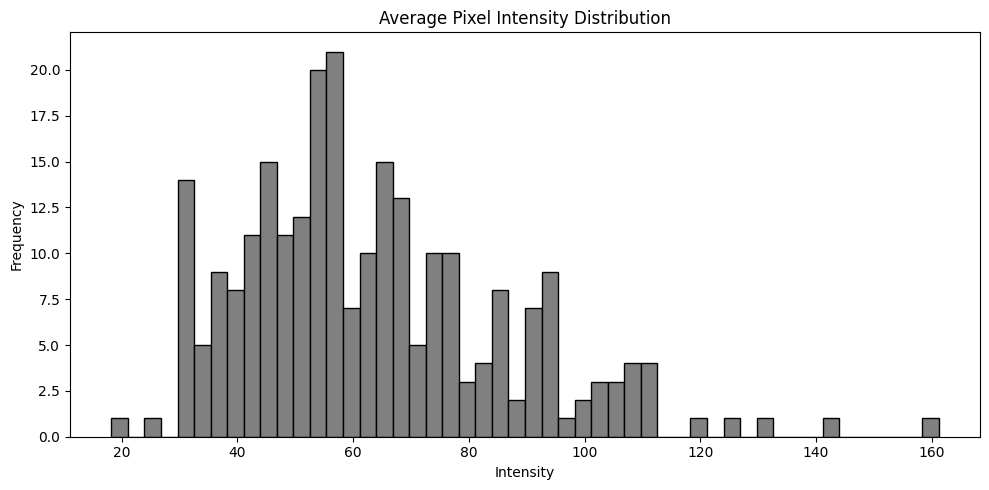

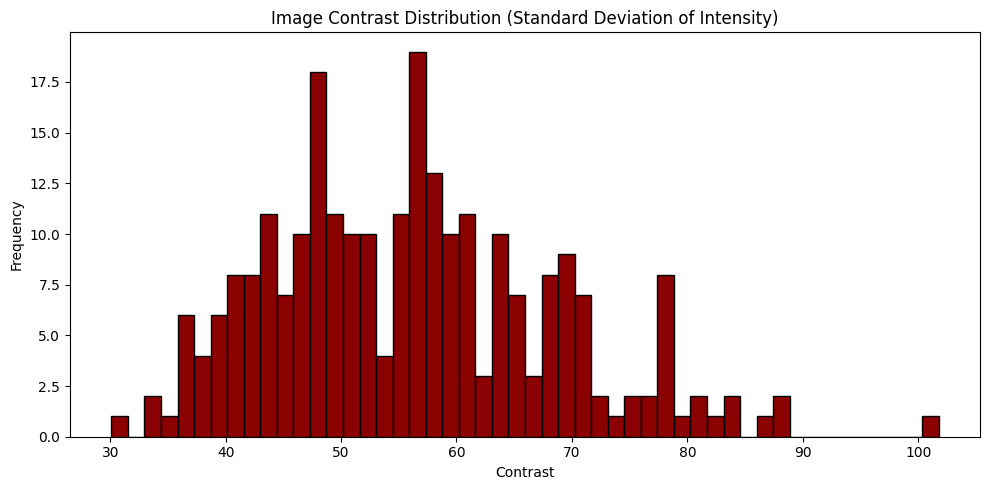

In [17]:
# Compute average intensity and contrast (standard deviation) for each image
df['avg_intensity'] = df['path'].apply(lambda x: np.array(Image.open(x).convert("L")).mean())
df['contrast'] = df['path'].apply(lambda x: np.array(Image.open(x).convert("L")).std())

# Plot average intensity distribution
plt.figure(figsize=(10, 5))
plt.hist(df['avg_intensity'], bins=50, color='gray', edgecolor='black')
plt.title("Average Pixel Intensity Distribution")
plt.xlabel("Intensity")
plt.ylabel("Frequency")
plt.tight_layout()
plt.savefig("results/plots/average_intensity_distribution.png", dpi=300, bbox_inches="tight")
plt.show()

# Plot contrast distribution
plt.figure(figsize=(10, 5))
plt.hist(df['contrast'], bins=50, color='darkred', edgecolor='black')
plt.title("Image Contrast Distribution (Standard Deviation of Intensity)")
plt.xlabel("Contrast")
plt.ylabel("Frequency")
plt.tight_layout()
plt.savefig("results/plots/image_contrast_distribution.png", dpi=300, bbox_inches="tight")
plt.show()


Removing low contrast (intensity) samples

In [18]:
intensity_threshold = 10
df = df[df['avg_intensity'] > intensity_threshold].reset_index(drop=True)

In [19]:
df.shape

(253, 9)

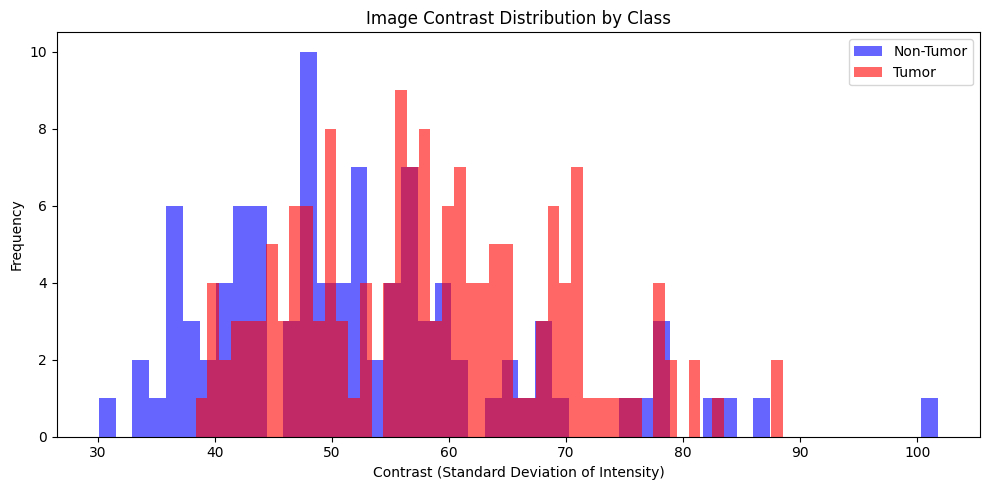

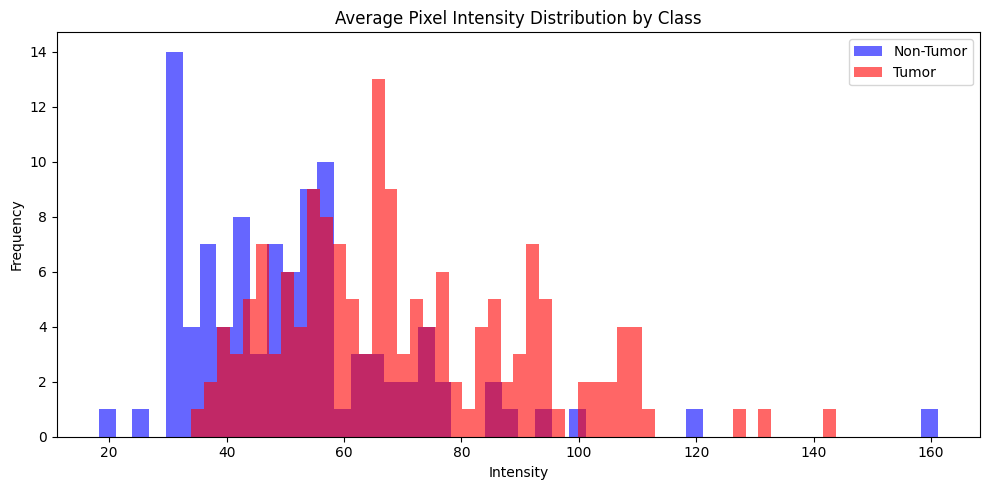

In [20]:
# Split data by class
tumor_df = df[df['label'] == 1]
non_tumor_df = df[df['label'] == 0]

# Plot contrast distribution per class
plt.figure(figsize=(10, 5))
plt.hist(non_tumor_df['contrast'], bins=50, alpha=0.6, color='blue', label='Non-Tumor')
plt.hist(tumor_df['contrast'], bins=50, alpha=0.6, color='red', label='Tumor')
plt.title("Image Contrast Distribution by Class")
plt.xlabel("Contrast (Standard Deviation of Intensity)")
plt.ylabel("Frequency")
plt.legend()
plt.tight_layout()
plt.savefig("results/plots/contrast_distribution_by_class.png", dpi=300, bbox_inches="tight")
plt.show()

# Plot intensity distribution per class
plt.figure(figsize=(10, 5))
plt.hist(non_tumor_df['avg_intensity'], bins=50, alpha=0.6, color='blue', label='Non-Tumor')
plt.hist(tumor_df['avg_intensity'], bins=50, alpha=0.6, color='red', label='Tumor')
plt.title("Average Pixel Intensity Distribution by Class")
plt.xlabel("Intensity")
plt.ylabel("Frequency")
plt.legend()
plt.tight_layout()
plt.savefig("results/plots/intensity_distribution_by_class.png", dpi=300, bbox_inches="tight")
plt.show()


**Removing currupt or dublicate samples**

In [21]:
bad_files = []
for path in tqdm(df['path']):
    try:
        img = Image.open(path)
        img.verify()  # verify is lightweight check
    except:
        bad_files.append(path)

print("Corrupted Images:", bad_files)

100%|██████████| 253/253 [00:00<00:00, 1424.85it/s]

Corrupted Images: []


**Analyzing Sharpness and noise**

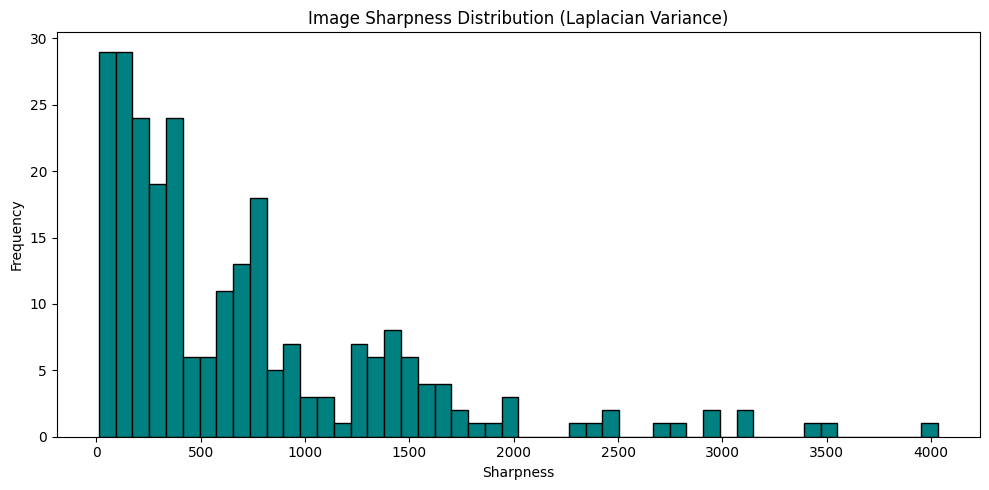

In [22]:
# Compute Laplacian variance for sharpness
def compute_sharpness(path):
    img = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    return cv2.Laplacian(img, cv2.CV_64F).var()

df['sharpness'] = df['path'].apply(compute_sharpness)

# Plot sharpness distribution
plt.figure(figsize=(10, 5))
plt.hist(df['sharpness'], bins=50, color='teal', edgecolor='black')
plt.title("Image Sharpness Distribution (Laplacian Variance)")
plt.xlabel("Sharpness")
plt.ylabel("Frequency")
plt.tight_layout()
plt.savefig("results/plots/image_sharpness_distribution.png", dpi=300, bbox_inches="tight")
plt.show()

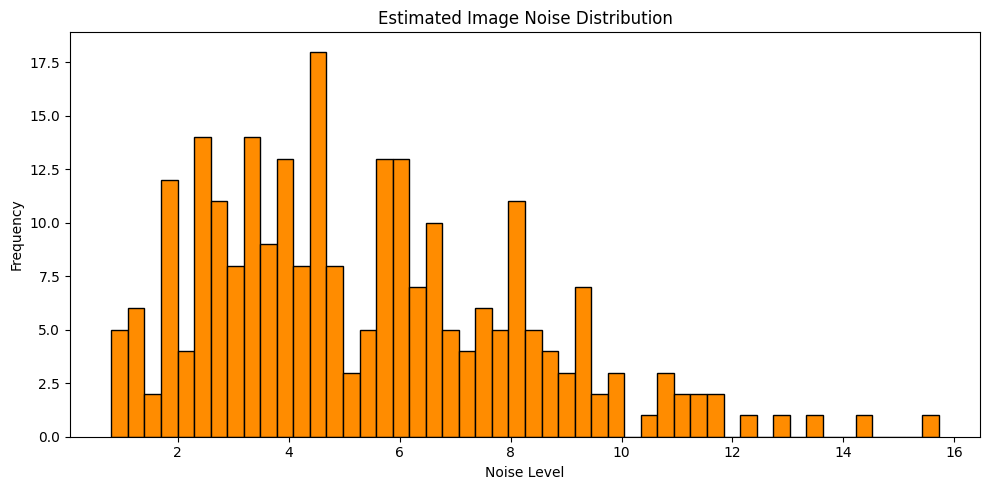

In [23]:
# Estimate noise level
def compute_noise(path):
    img = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    blurred = cv2.GaussianBlur(img, (3, 3), 0)
    noise = img.astype(np.float32) - blurred.astype(np.float32)
    return noise.std()

df['noise'] = df['path'].apply(compute_noise)

# Plot noise distribution
plt.figure(figsize=(10, 5))
plt.hist(df['noise'], bins=50, color='darkorange', edgecolor='black')
plt.title("Estimated Image Noise Distribution")
plt.xlabel("Noise Level")
plt.ylabel("Frequency")
plt.tight_layout()
plt.savefig("results/plots/image_noise_distribution.png", dpi=300, bbox_inches="tight")
plt.show()


**Removing blurry samples**

In [24]:
# Flag blurry images
blur_threshold = 100
df['is_blurry'] = df['sharpness'] < blur_threshold

# Count blurry images
num_blurry = df['is_blurry'].sum()
print(f"Blurry images detected: {num_blurry} out of {len(df)}")


Blurry images detected: 33 out of 253


In [25]:
df = df[~df['is_blurry']].reset_index(drop=True)

In [26]:
df.shape

(220, 12)

# Feature Selection Strategy

**Correlations**

In [27]:
def compute_correlations(df, target="label", threshold=0.9):
    corr_matrix = df.corr().abs()

    # 1. Redundant pairs
    upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
    redundant_features = [(col, row, upper.loc[row, col])
                          for col in upper.columns
                          for row in upper.index
                          if upper.loc[row, col] > threshold]
    # 2. Correlation with target
    corr_with_target = corr_matrix[target].drop(target).sort_values(ascending=False)

    return redundant_features, corr_with_target

In [28]:
# Step 1: Select only numeric columns
numeric_df = df.select_dtypes(include=[np.number])

# Step 2: Identify non-numeric columns
non_numeric_cols = df.columns.difference(numeric_df.columns)
print("Non-numeric columns:", non_numeric_cols.tolist())



Non-numeric columns: ['filename', 'is_blurry', 'path', 'size']


In [29]:
df_encoded= df.drop(columns=['filename', 'path', 'is_blurry', 'size'])  # Features
redundant, corr_with_target = compute_correlations(df_encoded)

In [30]:
# Convert redundant correlations to DataFrame for saving
redundant_df = pd.DataFrame(redundant, columns=["Feature_1", "Feature_2", "Correlation"])

print("Highly correlated feature pairs (>0.9):")
for f1, f2, val in redundant:
    print(f"{f1} ↔ {f2} : {val:.2f}")

# Save to CSV file
file_path = "results/tables/redundant_features.csv"
redundant_df.to_csv(file_path, index=False)

print(f"Saved highly correlated feature/redundant pairs to {file_path}")

Highly correlated feature pairs (>0.9):
height ↔ width : 0.95
noise ↔ sharpness : 0.97
Saved highly correlated feature/redundant pairs to results/tables/redundant_features.csv


In [31]:
# Print top 5 features predictive of diagnosis
print("\nTop 5 features predictive of diagnosis:")
print(corr_with_target.head(5))

# Create folder if it doesn't exist
os.makedirs("results/tables", exist_ok=True)

# Save top 5 features to CSV
top_5_df = corr_with_target.head(5)
file_path = "results/tables/top_5_predictive_features.csv"
top_5_df.to_csv(file_path)

print(f"Top 5 predictive features saved to {file_path}")

# Save top 5 feature data into X_top
top_5_features = top_5_df.index.tolist()
X_top = df[top_5_features]   # DataFrame with top features
top_features = X_top.columns  # Index of feature names
print(top_features)


Top 5 features predictive of diagnosis:
aspect_ratio     0.366690
avg_intensity    0.361950
sharpness        0.268316
noise            0.256700
height           0.255615
Name: label, dtype: float64
Top 5 predictive features saved to results/tables/top_5_predictive_features.csv
Index(['aspect_ratio', 'avg_intensity', 'sharpness', 'noise', 'height'], dtype='object')


**Mutual Information**

Captures nonlinear relationships between features and the target.

In [32]:
X = df.drop(columns=['label', 'filename', 'path', 'size', 'is_blurry'])
y = df['label']

In [33]:
mi_scores = mutual_info_classif(X, y, random_state=42)
mi_df = pd.DataFrame({'Feature': X.columns, 'MI Score': mi_scores})
mi_df = mi_df.sort_values(by='MI Score', ascending=False)
print(mi_df.head(10))

file_path = "results/tables/top_Mutual_info_classif.csv"
mi_df.to_csv(file_path)

print(f"Top Mutual Information {file_path}")


         Feature  MI Score
0          width  0.231094
1         height  0.206775
2   aspect_ratio  0.169858
3  avg_intensity  0.162464
4       contrast  0.131289
6          noise  0.097644
5      sharpness  0.038484
Top Mutual Information results/tables/top_Mutual_info_classif.csv


**Tree-Based Feature Importance**

In [34]:
model = RandomForestClassifier(random_state=42)
model.fit(X, y)

importances = pd.Series(model.feature_importances_, index=X.columns)
fi_df = importances.sort_values(ascending=False).reset_index()
fi_df.columns = ['Feature', 'Importance']
print(fi_df.head(10))

file_path = "results/tables/top_tree_based_feature.csv"
fi_df.to_csv(file_path)

print(f"Top Tree-Based Feature Importance {file_path}")


         Feature  Importance
0         height    0.202269
1  avg_intensity    0.163996
2   aspect_ratio    0.159070
3          width    0.153209
4          noise    0.117388
5      sharpness    0.102390
6       contrast    0.101678
Top Tree-Based Feature Importance results/tables/top_tree_based_feature.csv


**Recursive Feature Elimination (RFE)**

Find the best subset of features.

In [35]:
rfe = RFE(estimator=LogisticRegression(max_iter=1000), n_features_to_select=5)
rfe.fit(X, y)

selected_features = X.columns[rfe.support_]
print("Selected features via RFE:", selected_features.tolist())

file_path = "results/tables/top_recursive_feature_elimination.csv"
pd.DataFrame({'Selected Features': selected_features.tolist()}).to_csv(file_path, index=False)


print(f"Top Recursive Feature Elimination (RFE) {file_path}")

Selected features via RFE: ['width', 'height', 'aspect_ratio', 'avg_intensity', 'noise']
Top Recursive Feature Elimination (RFE) results/tables/top_recursive_feature_elimination.csv


**Univariate Statistical Tests (ANOVA F-test)**

Rank features by their discriminative power.

In [36]:
selector = SelectKBest(score_func=f_classif, k='all')
selector.fit(X, y)

anova_df = pd.DataFrame({'Feature': X.columns, 'F Score': selector.scores_})
anova_df = anova_df.sort_values(by='F Score', ascending=False)
print(anova_df.head(10))

file_path = "results/tables/top_univariate_statistical.csv"
anova_df.head(10).to_csv(file_path)

print(f"Univariate Statistical Tests {file_path}")

         Feature    F Score
2   aspect_ratio  33.866370
3  avg_intensity  32.865282
5      sharpness  16.912117
6          noise  15.378475
1         height  15.239672
4       contrast   9.062266
0          width   4.273227
Univariate Statistical Tests results/tables/top_univariate_statistical.csv


**Consensus Selection**

Compare top features across methods and select those that consistently rank high

In [38]:
# Combine top 5 from each method
top_mi = mi_df.head(5)['Feature']
top_rf = fi_df.head(5)['Feature']
top_rfe = pd.Series(selected_features)
top_anova = anova_df.head(5)['Feature']

consensus = pd.concat([top_mi, top_rf, top_rfe, top_anova]).value_counts()
print("Consensus top features:")
print(consensus.head(10))

# Convert consensus Series to DataFrame
consensus_df = consensus.reset_index()
consensus_df.columns = ['Feature', 'Count']

# Create folder if needed
os.makedirs("results/tables", exist_ok=True)

# Save to CSV
file_path = "results/tables/consensus_top_features.csv"
consensus_df.to_csv(file_path, index=False)

print(f"Consensus top features saved to {file_path}")


Consensus top features:
height           4
aspect_ratio     4
avg_intensity    4
width            3
noise            3
contrast         1
sharpness        1
Name: count, dtype: int64
Consensus top features saved to results/tables/consensus_top_features.csv


**Visualize Feature Space with PCA**

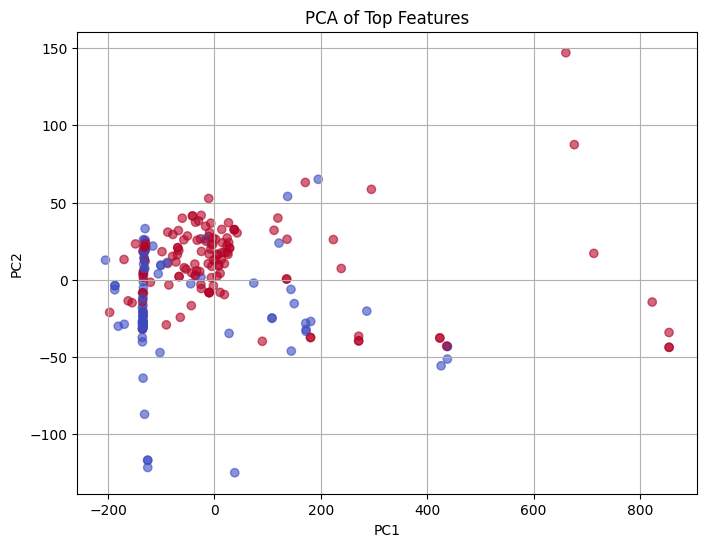

In [39]:
X_selected = df[consensus.head(5).index]  # Top 5 consensus features
y = df['label']

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_selected)

plt.figure(figsize=(8,6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y, cmap='coolwarm', alpha=0.6)
plt.title("PCA of Top Features")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.grid(True)
# Save figure to PNG file
plt.savefig("results/plots/pca_top_5_features.png", dpi=300, bbox_inches="tight")
plt.show()

**t-SNE for Nonlinear Embedding**

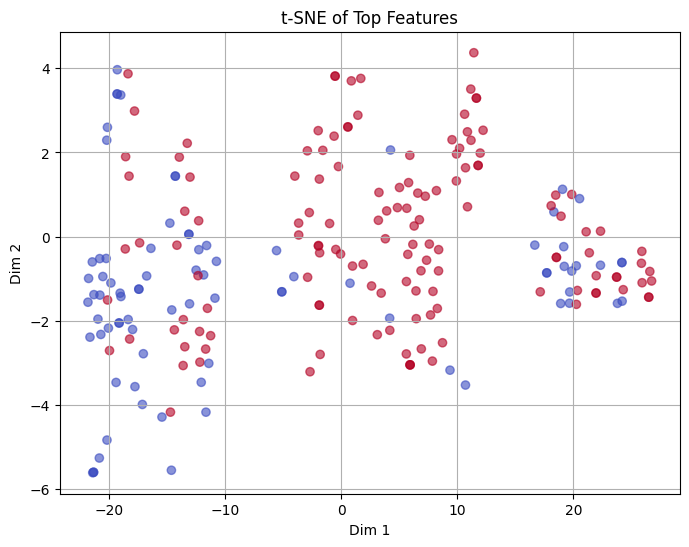

In [40]:
tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(X_selected)

plt.figure(figsize=(8,6))
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=y, cmap='coolwarm', alpha=0.6)
plt.title("t-SNE of Top Features")
plt.xlabel("Dim 1")
plt.ylabel("Dim 2")
plt.grid(True)
# Save the plot as PNG
plt.savefig("results/plots/tsne_projection.png", dpi=300, bbox_inches="tight")
plt.show()

**Attempting Logistic Regression**

In [41]:
X_train, X_test, y_train, y_test = train_test_split(X_selected, y, test_size=0.2, random_state=42)

model = LogisticRegression(max_iter=1000)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

print(classification_report(y_test, y_pred))

# Generate report as dictionary
report_dict = classification_report(y_test, y_pred, output_dict=True)

# Convert to DataFrame
report_df = pd.DataFrame(report_dict).transpose()

# Create folder if needed
os.makedirs("results/tables", exist_ok=True)

# Save to CSV
file_path = "results/tables/classification_report.csv"
report_df.to_csv(file_path)

print(f"Classification report saved as table to {file_path}")

              precision    recall  f1-score   support

           0       0.87      0.65      0.74        20
           1       0.76      0.92      0.83        24

    accuracy                           0.80        44
   macro avg       0.81      0.78      0.79        44
weighted avg       0.81      0.80      0.79        44

Classification report saved as table to results/tables/classification_report.csv


# Preprocessing the dataset

In [42]:
df.shape

(220, 12)

In [43]:
print(df.head())

   filename  label                                               path  \
0   N17.jpg      0  /kaggle/input/brain-mri-images-for-brain-tumor...   
1  Y106.jpg      1  /kaggle/input/brain-mri-images-for-brain-tumor...   
2  Y164.JPG      1  /kaggle/input/brain-mri-images-for-brain-tumor...   
3  no 2.jpg      0  /kaggle/input/brain-mri-images-for-brain-tumor...   
4   Y10.jpg      1  /kaggle/input/brain-mri-images-for-brain-tumor...   

         size  width  height  aspect_ratio  avg_intensity   contrast  \
0  (350, 393)    350     393      0.890585      51.371356  55.948235   
1  (200, 253)    200     253      0.790514      85.334209  62.232953   
2  (264, 336)    264     336      0.785714      66.842589  52.403183   
3  (232, 217)    232     217      1.069124      30.031265  48.113601   
4  (319, 360)    319     360      0.886111     109.885737  64.420857   

     sharpness     noise  is_blurry  
0   674.787867  6.249264      False  
1   601.218211  5.582723      False  
2   175.447025

# Step 1: DATA PREPARATION

In [44]:
def prepare_data(df):
    """Split data into train and test sets"""
    train_df_full, test_df = train_test_split(
        df, 
        stratify=df['label'], 
        test_size=0.2,
        random_state=42
    )
    
    print(f"Train set size: {len(train_df_full)}")
    print(f"Test set size: {len(test_df)}")
    print(f"Train label distribution:\n{train_df_full['label'].value_counts()}")
    print(f"Test label distribution:\n{test_df['label'].value_counts()}")
    
    # Save test_df for later use
    os.makedirs("results/data", exist_ok=True)
    test_df.to_csv("results/data/test_df.csv", index=False)
    train_df_full.to_csv("results/data/train_df_full.csv", index=False)
    print(f"\nSaved test_df to: results/data/test_df.csv")
    print(f"Saved train_df_full to: results/data/train_df_full.csv")
    
    return train_df_full, test_df


In [46]:
# Define transforms
train_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),   # flips image left-right
    transforms.RandomRotation(10),        # rotates image ±10 degrees
    transforms.RandomAffine(degrees=0, translate=(0.1, 0.1)),  # shifts image up/down/left/right
    transforms.ColorJitter(brightness=0.2, contrast=0.2),  # ±20% variation
    transforms.RandomResizedCrop(224, scale=(0.9, 1.0)), # crop between 90% and 100%
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485], std=[0.229])  # For grayscale
])

val_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485], std=[0.229])
])

# STEP 2: DATASET AND DATALOADER

In [47]:
class BrainTumorDataset(Dataset):
    """Custom Dataset for Brain Tumor MRI images"""
    def __init__(self, dataframe, transform=None):
        self.df = dataframe
        self.transform = transform

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        img_path = self.df.iloc[idx]['path']
        label = self.df.iloc[idx]['label']
        image = Image.open(img_path).convert("L")  # Grayscale
        
        if self.transform:
            image = self.transform(image)
        
        return image, label

In [51]:
def get_weighted_sampler(df):
    """Create weighted sampler for handling class imbalance"""
    class_counts = df['label'].value_counts().to_dict()
    weights = df['label'].apply(lambda x: 1.0 / class_counts[x])
    return WeightedRandomSampler(weights.values, num_samples=len(weights), replacement=True)


In [52]:
def get_dataloaders(df, train_transform, val_transform, batch_size, split_ratio=0.8, use_sampler=True, test_df=None):
    """Create train, validation, and optionally test dataloaders"""
    # Split into train and val
    train_df, val_df = train_test_split(df, stratify=df['label'], test_size=1 - split_ratio, random_state=42)
    
    # Create datasets
    train_dataset = BrainTumorDataset(train_df, transform=train_transform)
    val_dataset = BrainTumorDataset(val_df, transform=val_transform)
    
    # Weighted sampler for class imbalance
    if use_sampler:
        sampler = get_weighted_sampler(train_df)
        train_loader = DataLoader(train_dataset, batch_size=batch_size, sampler=sampler)
    else:
        train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
    
    # Optional test loader
    if test_df is not None:
        test_dataset = BrainTumorDataset(test_df, transform=val_transform)
        test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
    else:
        test_loader = None
    
    return train_loader, val_loader, test_loader, train_df, val_df

# STEP 3: MODEL BUILDING

In [54]:
def build_model(arch, dropout_rate):
    """Build model with specified architecture and dropout rate"""
    if arch == 'resnet50':
        model = models.resnet50(weights='IMAGENET1K_V1')
        model.conv1 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)
        in_features = model.fc.in_features
        model.fc = nn.Sequential(
            nn.Dropout(dropout_rate),
            nn.Linear(in_features, 1)
        )
    elif arch == 'efficientnet_b0':
        model = models.efficientnet_b0(weights='IMAGENET1K_V1')
        model.features[0][0] = nn.Conv2d(1, 32, kernel_size=3, stride=2, padding=1, bias=False)
        in_features = model.classifier[1].in_features
        model.classifier[1] = nn.Sequential(
            nn.Dropout(p=dropout_rate),
            nn.Linear(in_features, 1)
        )
    elif arch == 'densenet121':
        model = models.densenet121(weights='IMAGENET1K_V1')
        model.features.conv0 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)
        in_features = model.classifier.in_features
        model.classifier = nn.Sequential(
            nn.Dropout(dropout_rate),
            nn.Linear(in_features, 1)
        )
    else:
        raise ValueError("Unsupported architecture")
    
    return model


In [55]:
def get_optimizer(optimizer_type, model_parameters, lr, weight_decay):
    """Create optimizer based on type"""
    if optimizer_type == 'Adam':
        return torch.optim.Adam(model_parameters, lr=lr, weight_decay=weight_decay)
    elif optimizer_type == 'SGD':
        return torch.optim.SGD(model_parameters, lr=lr, momentum=0.9, weight_decay=weight_decay)
    elif optimizer_type == 'AdamW':
        return torch.optim.AdamW(model_parameters, lr=lr, weight_decay=weight_decay)
    else:
        raise ValueError(f"Unsupported optimizer: {optimizer_type}")



In [56]:
def get_scheduler(scheduler_type, optimizer):
    """Create learning rate scheduler based on type"""
    if scheduler_type == 'plateau':
        return ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2)
        #If you want to monitor learning rate changes
        #scheduler.get_last_lr() 
    elif scheduler_type == 'step':
        return StepLR(optimizer, step_size=5, gamma=0.5)
    elif scheduler_type == 'cosine':
        return CosineAnnealingLR(optimizer, T_max=10)
    else:
        raise ValueError(f"Unsupported scheduler: {scheduler_type}")

# STEP 4: TRAINING FUNCTION

In [57]:
def train_model(model, train_loader, val_loader, criterion, optimizer, scheduler, device, num_epochs=20, patience=5, save_name='best_model.pth'):
    """Train model with early stopping"""
    model.to(device)
    
    best_val_loss = float('inf')
    no_improve_epochs = 0
    
    train_losses, val_losses = [], []
    val_accuracies, val_aucs = [], []
    val_precisions, val_recalls = [], []
    
    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch+1}/{num_epochs}")
        
        # Training phase
        model.train()
        running_train_loss = 0
        for images, labels in tqdm(train_loader, desc="Training", leave=False):
            images = images.to(device)
            labels = labels.float().unsqueeze(1).to(device)
            
            outputs = model(images)
            loss = criterion(outputs, labels)
            
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            running_train_loss += loss.item()
        
        avg_train_loss = running_train_loss / len(train_loader)
        train_losses.append(avg_train_loss)
        
        # Validation phase
        model.eval()
        val_loss = 0
        all_preds, all_labels = [], []
        
        with torch.no_grad():
            for images, labels in tqdm(val_loader, desc="Validating", leave=False):
                images = images.to(device)
                labels = labels.float().unsqueeze(1).to(device)
                
                outputs = model(images)
                val_loss += criterion(outputs, labels).item()
                
                probs = torch.sigmoid(outputs).cpu().numpy()
                all_preds.extend(probs)
                all_labels.extend(labels.cpu().numpy())
        
        avg_val_loss = val_loss / len(val_loader)
        val_losses.append(avg_val_loss)
        
        # Metrics
        pred_labels = [1 if p > 0.5 else 0 for p in all_preds]
        val_acc = accuracy_score(all_labels, pred_labels)
        val_auc = roc_auc_score(all_labels, all_preds)
        val_precision = precision_score(all_labels, pred_labels, zero_division=0)
        val_recall = recall_score(all_labels, pred_labels, zero_division=0)
        
        val_accuracies.append(val_acc)
        val_aucs.append(val_auc)
        val_precisions.append(val_precision)
        val_recalls.append(val_recall)
        
        print(f"Epoch {epoch+1} Summary:")
        print(f"Train Loss: {avg_train_loss:.4f}")
        print(f"Val Loss: {avg_val_loss:.4f}, Accuracy: {val_acc:.4f}, AUC: {val_auc:.4f}, Precision: {val_precision:.4f}, Recall: {val_recall:.4f}")
        
        # Save best model
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            no_improve_epochs = 0
            torch.save(model.state_dict(), save_name)
            print(f"Saved new best model at epoch {epoch+1}")
        else:
            no_improve_epochs += 1
            print(f"No improvement for {no_improve_epochs} epoch(s)")
            if no_improve_epochs >= patience:
                print(f"Early stopping triggered at epoch {epoch+1}")
                break
        
        # Adjust learning rate
        if isinstance(scheduler, ReduceLROnPlateau):
            scheduler.step(avg_val_loss)
        else:
            scheduler.step()
    
    return train_losses, val_losses, val_accuracies, val_aucs, val_precisions, val_recalls

# STEP 5: HYPERPARAMETER#  OPTIMIZATION

In [60]:
def optimize_model(architecture_name, train_df_full, train_transform, val_transform, n_trials=20):
    """Optimize hyperparameters for a specific architecture"""
    print(f"Optimizing hyperparameters for {architecture_name}...")
    
    optuna_results = []
    
    def objective(trial):
        # Suggest hyperparameters
        lr = trial.suggest_float('lr', 1e-5, 1e-3, log=True)
        batch_size = trial.suggest_categorical('batch_size', [16, 32, 64])
        dropout_rate = trial.suggest_float('dropout_rate', 0.0, 0.5)
        weight_decay = trial.suggest_float('weight_decay', 1e-6, 1e-2, log=True)
        optimizer_type = trial.suggest_categorical('optimizer', ['Adam', 'SGD', 'AdamW'])
        scheduler_type = trial.suggest_categorical('scheduler', ['plateau', 'step', 'cosine'])
        
        # Build model
        model = build_model(architecture_name, dropout_rate)
        
        # Create dataloaders
        train_loader, val_loader, _, _, _ = get_dataloaders(
            df=train_df_full,
            train_transform=train_transform,
            val_transform=val_transform,
            batch_size=batch_size,
            split_ratio=0.8,
            test_df=None
        )
        
        # Setup training components
        criterion = nn.BCEWithLogitsLoss()
        optimizer = get_optimizer(optimizer_type, model.parameters(), lr, weight_decay)
        scheduler = get_scheduler(scheduler_type, optimizer)
        
        # Train
        train_losses, val_losses, val_accuracies, val_aucs, val_precisions, val_recalls = train_model(
            model, train_loader, val_loader, criterion, optimizer, scheduler,
            device=torch.device("cuda" if torch.cuda.is_available() else "cpu"),
            num_epochs=10,
            patience=3,
            save_name=f"trial_{architecture_name}_{trial.number}.pth"
        )
        
        # Log results
        trial_result = {
            'trial': trial.number,
            'arch': architecture_name,
            'lr': lr,
            'batch_size': batch_size,
            'dropout_rate': dropout_rate,
            'weight_decay': weight_decay,
            'optimizer': optimizer_type,
            'scheduler': scheduler_type,
            'val_loss': val_losses[-1],
            'accuracy': val_accuracies[-1],
            'auc': val_aucs[-1],
            'precision': val_precisions[-1],
            'recall': val_recalls[-1]
        }
        optuna_results.append(trial_result)
        
        # Return composite metric
        return 0.5 * max(val_aucs) + 0.5 * max(val_recalls)
    
    # Run optimization
    study = optuna.create_study(direction='maximize')
    study.optimize(objective, n_trials=n_trials)
    
    print(f"Best parameters for {architecture_name}:")
    print(study.best_trial.params)
    
    return study.best_trial.params, optuna_results


# STEP 6: MAIN EXECUTION PIPELINE

In [61]:
def run_pipeline(df, architectures=['resnet50', 'efficientnet_b0', 'densenet121'], n_trials=20):
    """Main pipeline to train and evaluate all models"""
    
    # Prepare data
    train_df_full, test_df = prepare_data(df)
    
    # Storage for results
    all_results = []
    all_optuna_results = []
    
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")
    
    # Process each architecture
    for arch in architectures:
        print(f"\n{'='*50}")
        print(f"Processing {arch.upper()}")
        print(f"{'='*50}")
        
        # Optimize hyperparameters
        best_params, arch_optuna_results = optimize_model(
            arch, train_df_full, train_transform, val_transform, n_trials=n_trials
        )
        all_optuna_results.extend(arch_optuna_results)
        
        # Train final model with best parameters
        print(f"Training final {arch} model with best parameters...")
        
        # Extract best parameters
        best_lr = best_params['lr']
        best_batch_size = best_params['batch_size']
        best_dropout = best_params['dropout_rate']
        best_weight_decay = best_params['weight_decay']
        best_optimizer = best_params['optimizer']
        best_scheduler = best_params['scheduler']
        
        # Build final model
        final_model = build_model(arch, best_dropout)
        
        # Create dataloaders
        train_loader, val_loader, test_loader, _, _ = get_dataloaders(
            df=train_df_full,
            train_transform=train_transform,
            val_transform=val_transform,
            batch_size=best_batch_size,
            split_ratio=0.8,
            test_df=test_df
        )
        
        # Setup training
        criterion = nn.BCEWithLogitsLoss()
        optimizer = get_optimizer(best_optimizer, final_model.parameters(), best_lr, best_weight_decay)
        scheduler = get_scheduler(best_scheduler, optimizer)
        
        # Train final model
        train_losses, val_losses, val_accuracies, val_aucs, val_precisions, val_recalls = train_model(
            final_model, train_loader, val_loader, criterion, optimizer, scheduler,
            device=device,
            num_epochs=20,
            patience=5,
            save_name=f"best_{arch}_model.pth"
        )
        
        # Evaluate on test set with comprehensive analysis
        print(f"Evaluating {arch} on test set...")
        
        final_model.load_state_dict(torch.load(f"best_{arch}_model.pth"))
        final_model.eval()
        final_model.to(device)
        
        # Run comprehensive evaluation
        eval_metrics = evaluate_and_save(
            model=final_model,
            model_name=arch,
            test_loader=test_loader,
            test_df=test_df,
            device=device,
            num_gradcam_samples=6
        )
        
        # Get basic metrics for comparison table
        all_preds = []
        all_labels = []
        
        with torch.no_grad():
            for images, labels in test_loader:
                images = images.to(device)
                labels = labels.float().unsqueeze(1).to(device)
                
                outputs = final_model(images)
                probs = torch.sigmoid(outputs).cpu().numpy()
                all_preds.extend(probs)
                all_labels.extend(labels.cpu().numpy())
        
        probs_arr, labels_arr = flatten_preds_labels(all_preds, all_labels)
        pred_labels = (probs_arr >= 0.5).astype(int)
        
        test_acc = accuracy_score(labels_arr, pred_labels)
        test_precision = precision_score(labels_arr, pred_labels, zero_division=0)
        test_recall = recall_score(labels_arr, pred_labels, zero_division=0)
        test_auc = roc_auc_score(labels_arr, probs_arr)
        
        print(f"\n{arch.upper()} Test Results:")
        print(f"Accuracy:  {test_acc:.4f}")
        print(f"Precision: {test_precision:.4f}")
        print(f"Recall:    {test_recall:.4f}")
        print(f"AUC:       {test_auc:.4f}")
        
        # Store results
        result = {
            'Model': arch,
            'Accuracy': test_acc,
            'Precision': test_precision,
            'Recall': test_recall,
            'AUC': test_auc,
            'Best_Params': str(best_params)
        }
        all_results.append(result)
    
    # Save results
    os.makedirs("results/tables", exist_ok=True)
    os.makedirs("results/plots", exist_ok=True)
    
    optuna_df = pd.DataFrame(all_optuna_results)
    optuna_df.to_csv("results/tables/all_optuna_trials.csv", index=False)
    
    results_df = pd.DataFrame(all_results)
    results_df.to_csv("results/tables/model_comparison.csv", index=False)
    
    # Generate combined ROC curve plot
    if roc_registry:
        roc_path = plot_and_save_combined_roc(roc_registry)
        print(f"\nSaved combined ROC curves: {roc_path}")
    
    print("\n" + "="*60)
    print("FINAL COMPARISON")
    print("="*60)
    print(results_df)
    print("\nAll results saved!")
    print("Optuna trials: results/tables/all_optuna_trials.csv")
    print("Final comparison: results/tables/model_comparison.csv")
    print("\nAdditional outputs per model:")
    print("- Confusion matrices: results/plots/confusion_matrix_*.png")
    print("- Classification reports: results/tables/classification_report_*.txt")
    print("- Error analysis: results/tables/error_analysis_*.csv")
    print("- False positives/negatives: results/tables/false_positives_*.csv")
    print("- Grad-CAM visualizations: results/plots/gradcam_*.png")
    print("- Combined ROC curves: results/plots/roc_curves_combined.png")
    
    return results_df

USAGE EXAMPLE

In [53]:
if __name__ == "__main__":
    # Load your dataframe
    # df = pd.read_csv('your_data.csv')
    # or use your existing df
    
    # Run the complete pipeline
    # results = run_pipeline(df, architectures=['resnet50', 'efficientnet_b0', 'densenet121'], n_trials=20)
    pass

# STEP 7: EVALUATION AND VISUALIZATION FUNCTIONS

In [62]:
# Global registry for ROC curves
roc_registry = {}

In [63]:
def flatten_preds_labels(all_probs, all_labels):
    """Flatten prediction and label arrays for consistent metric computation"""
    probs = np.vstack(all_probs).ravel() if len(all_probs) and np.array(all_probs[0]).ndim>0 else np.array(all_probs).ravel()
    labels = np.vstack(all_labels).ravel() if len(all_labels) and np.array(all_labels[0]).ndim>0 else np.array(all_labels).ravel()
    probs = probs.astype(float)
    labels = labels.astype(int)
    return probs, labels

In [64]:
def save_confusion_matrix(y_true, y_pred, model_name):
    """Generate and save confusion matrix"""
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(5,4))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
                xticklabels=["No Tumor", "Tumor"],
                yticklabels=["No Tumor", "Tumor"])
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.title(f"Confusion Matrix - {model_name}")
    outp = f"results/plots/confusion_matrix_{model_name}.png"
    plt.savefig(outp, bbox_inches="tight", dpi=150)
    plt.show()  # Display in notebook
    plt.close()
    return outp

In [65]:
def save_classification_report(y_true, y_pred, y_probs, model_name):
    """Generate and save classification report with AUC"""
    rep = classification_report(y_true, y_pred, target_names=["No Tumor","Tumor"], zero_division=0)
    
    # Calculate AUC
    auc_score = roc_auc_score(y_true, y_probs)
    
    # Add AUC to the report
    full_report = rep + f"\n\nAUC-ROC Score: {auc_score:.4f}\n"
    
    with open(f"results/tables/classification_report_{model_name}.txt", "w") as f:
        f.write(full_report)
    
    return full_report

In [66]:
def plot_and_save_combined_roc(registry, outpath="results/plots/roc_curves_combined.png"):
    """Plot ROC curves for all models on one figure"""
    plt.figure(figsize=(7,6))
    for name, (y_true, y_probs) in registry.items():
        fpr, tpr, _ = roc_curve(y_true, y_probs)
        roc_auc = auc(fpr, tpr)
        plt.plot(fpr, tpr, lw=2, label=f"{name} (AUC={roc_auc:.3f})")
    plt.plot([0,1],[0,1], linestyle="--", color="gray")
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title("ROC Curves (All Models)")
    plt.legend(loc="lower right")
    plt.savefig(outpath, bbox_inches="tight", dpi=150)
    plt.close()
    return outpath

# STEP 8: GRAD-CAM IMPLEMENTATION

In [67]:
def _get_last_conv_module(model, model_name):
    """Identify the last convolutional layer for Grad-CAM"""
    name = model_name.lower()
    
    # ResNet
    if 'resnet' in name:
        return getattr(model, 'layer4', None)
    
    # DenseNet
    if 'densenet' in name:
        feats = getattr(model, 'features', None)
        for m in reversed(list(feats.named_modules())):
            if isinstance(m[1], torch.nn.Conv2d):
                return m[1]
        return feats
    
    # EfficientNet
    if 'efficientnet' in name:
        feats = getattr(model, 'features', None)
        last = None
        for n, ch in feats.named_children():
            last = ch
        return last
    
    # Fallback: search for last Conv2d in model
    last_conv = None
    for n, m in model.named_modules():
        if isinstance(m, torch.nn.Conv2d):
            last_conv = m
    return last_conv

In [68]:
def compute_gradcam_for_image(model, model_name, pil_image, device):
    """Compute Grad-CAM heatmap for a single image"""
    model.eval()
    
    # Prepare input tensor (keep as 1 channel for grayscale models)
    preprocess = transforms.Compose([
        transforms.Resize((224,224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485], std=[0.229])
    ])
    x = preprocess(pil_image).unsqueeze(0).to(device)
    # Don't convert to 3 channels - models are modified for 1 channel input
    
    # Find target conv module & register hooks
    target_conv = _get_last_conv_module(model, model_name)
    if target_conv is None:
        raise RuntimeError("Could not identify last conv layer for Grad-CAM")
    
    activations = {}
    gradients = {}
    
    def forward_hook(module, input, output):
        activations['value'] = output.detach()
    
    def backward_hook(module, grad_in, grad_out):
        gradients['value'] = grad_out[0].detach()
    
    fh = target_conv.register_forward_hook(forward_hook)
    bh = target_conv.register_full_backward_hook(backward_hook)
    
    # Forward pass
    model.zero_grad()
    out = model(x)
    if out.numel() == 1:
        score = out.squeeze()
    else:
        pred_idx = out.argmax(dim=1).item()
        score = out[0, pred_idx]
    
    # Backward pass
    score.backward(retain_graph=True)
    
    # Get activations and gradients
    act = activations.get('value')
    grad = gradients.get('value')
    if act is None or grad is None:
        fh.remove(); bh.remove()
        raise RuntimeError("Grad-CAM failed to capture activations or gradients")
    
    # Compute weighted combination
    weights = torch.mean(grad, dim=(2,3), keepdim=True)
    gcam = torch.sum(weights * act, dim=1, keepdim=True)
    gcam = torch.relu(gcam)
    gcam = F.interpolate(gcam, size=(224,224), mode='bilinear', align_corners=False)
    gcam = gcam.squeeze().cpu().numpy()
    
    # Normalize
    gcam -= gcam.min()
    if gcam.max() > 0:
        gcam /= gcam.max()
    
    # Remove hooks
    fh.remove(); bh.remove()
    
    return gcam

In [69]:
def overlay_heatmap_on_image(pil_img, heatmap, alpha=0.5, cmap='jet'):
    """Overlay Grad-CAM heatmap on original image"""
    img = np.array(pil_img.resize((224,224)))
    if img.ndim == 2:
        base = np.stack([img]*3, axis=-1)
    else:
        base = img
    cmap_ = plt.get_cmap(cmap)
    hm = cmap_(heatmap)[:,:,:3] * 255.0
    overlay = (1-alpha) * base.astype(float) + alpha * hm.astype(float)
    overlay = np.clip(overlay, 0, 255).astype(np.uint8)
    return overlay

# STEP 9: COMPREHENSIVE EVALUATION FUNCTION

In [70]:
def evaluate_and_save(model, model_name, test_loader, test_df, device, num_gradcam_samples=6):
    """
    Comprehensive evaluation: metrics, confusion matrix, classification report,
    error analysis, false positives/negatives, and Grad-CAM visualizations
    """
    model.to(device)
    model.eval()
    
    print(f"\nEvaluating {model_name}...")
    
    # Collect predictions from test_loader
    all_probs = []
    all_labels = []
    
    with torch.no_grad():
        for images, labels in tqdm(test_loader, desc=f"Predicting {model_name}", leave=False):
            images = images.to(device)
            labels = labels.float().unsqueeze(1).to(device)
            out = model(images)
            probs = torch.sigmoid(out).cpu().numpy()
            all_probs.extend(probs)
            all_labels.extend(labels.cpu().numpy())
    
    probs_arr, labels_arr = flatten_preds_labels(all_probs, all_labels)
    pred_labels = (probs_arr >= 0.5).astype(int)
    
    # Save confusion matrix & classification report (with AUC)
    cm_path = save_confusion_matrix(labels_arr, pred_labels, model_name)
    rep = save_classification_report(labels_arr, pred_labels, probs_arr, model_name)
    print(f"Saved confusion matrix: {cm_path}")
    print(f"Classification report:\n{rep}")
    
    # Save ROC data for combined plotting later
    roc_registry[model_name] = (labels_arr, probs_arr)
    
    # Error analysis: iterate through test_df for detailed per-image analysis
    error_rows = []
    sample_for_gradcam = []
    
    with torch.no_grad():
        for i, row in tqdm(test_df.reset_index(drop=True).iterrows(), 
                          desc=f"Error analysis {model_name}", leave=False):
            img_path = row['path']
            true_label = int(row['label'])
            pil = Image.open(img_path).convert("L")
            
            # Transform and predict (keep as 1 channel, don't convert to 3)
            transform = transforms.Compose([
                transforms.Resize((224,224)), 
                transforms.ToTensor(),
                transforms.Normalize(mean=[0.485], std=[0.229])
            ])
            x = transform(pil).unsqueeze(0).to(device)
            
            out = model(x)
            prob = torch.sigmoid(out).item()
            pred = 1 if prob >= 0.5 else 0
            
            error_rows.append({
                'filename': os.path.basename(img_path),
                'path': img_path,
                'true_label': true_label,
                'pred_label': pred,
                'probability': prob
            })
            
            # Collect misclassified samples for Grad-CAM
            if pred != true_label:
                sample_for_gradcam.append((img_path, true_label, pred, prob))
    
    error_df = pd.DataFrame(error_rows)
    error_df.to_csv(f"results/tables/error_analysis_{model_name}.csv", index=False)
    print(f"Saved error analysis: results/tables/error_analysis_{model_name}.csv")
    print(f"\nError Analysis Summary (first 10 rows):")
    print(error_df.head(10))
    
    # Save false positives and false negatives
    false_pos = error_df[(error_df['true_label']==0) & (error_df['pred_label']==1)].sort_values('probability', ascending=False).head(10)
    false_neg = error_df[(error_df['true_label']==1) & (error_df['pred_label']==0)].sort_values('probability', ascending=True).head(10)
    false_pos.to_csv(f"results/tables/false_positives_{model_name}.csv", index=False)
    false_neg.to_csv(f"results/tables/false_negatives_{model_name}.csv", index=False)
    print(f"Saved false positives/negatives")
    print(f"\nFalse Positives ({len(false_pos)} cases):")
    if len(false_pos) > 0:
        print(false_pos[['filename', 'probability']])
    else:
        print("None")
    print(f"\nFalse Negatives ({len(false_neg)} cases):")
    if len(false_neg) > 0:
        print(false_neg[['filename', 'probability']])
    else:
        print("None")
    
    # Grad-CAM: choose samples (prefer misclassified)
    gradcam_samples = []
    mis_samples = sample_for_gradcam[:num_gradcam_samples]
    gradcam_samples.extend(mis_samples)
    
    # Add correctly classified samples if needed
    if len(gradcam_samples) < num_gradcam_samples:
        correct_df = error_df[error_df['true_label'] == error_df['pred_label']]
        picks = correct_df.sample(min(len(correct_df), num_gradcam_samples - len(gradcam_samples)), random_state=42)
        for _, r in picks.iterrows():
            gradcam_samples.append((r['path'], int(r['true_label']), int(r['pred_label']), r['probability']))
    
    # Grad-CAM: choose samples (prefer misclassified)
    gradcam_samples = []
    mis_samples = sample_for_gradcam[:num_gradcam_samples]
    gradcam_samples.extend(mis_samples)
    
    # Add correctly classified samples if needed
    if len(gradcam_samples) < num_gradcam_samples:
        correct_df = error_df[error_df['true_label'] == error_df['pred_label']]
        picks = correct_df.sample(min(len(correct_df), num_gradcam_samples - len(gradcam_samples)), random_state=42)
        for _, r in picks.iterrows():
            gradcam_samples.append((r['path'], int(r['true_label']), int(r['pred_label']), r['probability']))
    
    # Generate Grad-CAM visualizations
    os.makedirs("results/plots", exist_ok=True)
    print(f"\nGrad-CAM Visualizations:")
    
    # Create a figure to display all Grad-CAM images
    num_samples = len(gradcam_samples)
    if num_samples > 0:
        fig, axes = plt.subplots(2, 3, figsize=(15, 10))
        axes = axes.flatten()
        
        for idx, (img_path, true_lbl, pred_lbl, prob) in enumerate(gradcam_samples):
            if idx >= 6:  # Only show up to 6
                break
                
            pil = Image.open(img_path).convert("L")
            try:
                hm = compute_gradcam_for_image(model, model_name, pil, device)
                overlay = overlay_heatmap_on_image(pil, hm, alpha=0.5)
                out_name = f"results/plots/gradcam_{model_name}_{idx}_t{true_lbl}_p{pred_lbl}_{os.path.basename(img_path)}"
                plt.imsave(out_name, overlay)
                
                # Display in subplot
                axes[idx].imshow(overlay)
                axes[idx].axis('off')
                axes[idx].set_title(f"True: {true_lbl}, Pred: {pred_lbl}\nProb: {prob:.3f}", fontsize=10)
            except Exception as e:
                print(f"Grad-CAM failed for {img_path}: {e}")
                axes[idx].axis('off')
        
        # Hide unused subplots
        for idx in range(len(gradcam_samples), 6):
            axes[idx].axis('off')
        
        plt.suptitle(f"Grad-CAM Visualizations - {model_name}", fontsize=14, fontweight='bold')
        plt.tight_layout()
        plt.show()
        plt.close()
    
    print(f"Saved Grad-CAM images (up to {num_gradcam_samples} samples)")
    
    metrics = {
        'confusion_matrix': cm_path,
        'classification_report': f"results/tables/classification_report_{model_name}.txt",
        'error_csv': f"results/tables/error_analysis_{model_name}.csv",
        'false_pos': f"results/tables/false_positives_{model_name}.csv",
        'false_neg': f"results/tables/false_negatives_{model_name}.csv"
    }
    
    return metrics

Checking separatly

Dont run if running all the project


Evaluating efficientnet_b0...


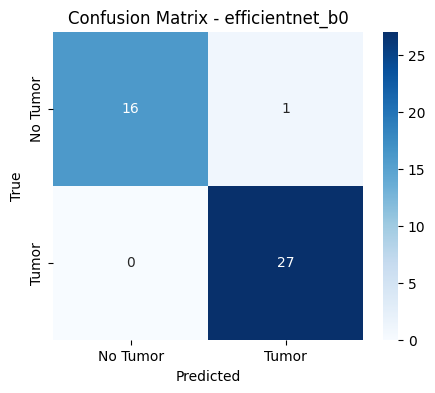

Saved confusion matrix: results/plots/confusion_matrix_efficientnet_b0.png
Classification report:
              precision    recall  f1-score   support

    No Tumor       1.00      0.94      0.97        17
       Tumor       0.96      1.00      0.98        27

    accuracy                           0.98        44
   macro avg       0.98      0.97      0.98        44
weighted avg       0.98      0.98      0.98        44


AUC-ROC Score: 1.0000



Saved error analysis: results/tables/error_analysis_efficientnet_b0.csv

Error Analysis Summary (first 10 rows):
    filename                                               path  true_label  \
0    N15.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
1   Y180.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
2   Y155.JPG  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
3     N3.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
4    Y99.JPG  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
5    N19.JPG  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
6    Y73.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
7    Y79.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
8  24 no.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
9    Y38.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   

   pred_label  pr

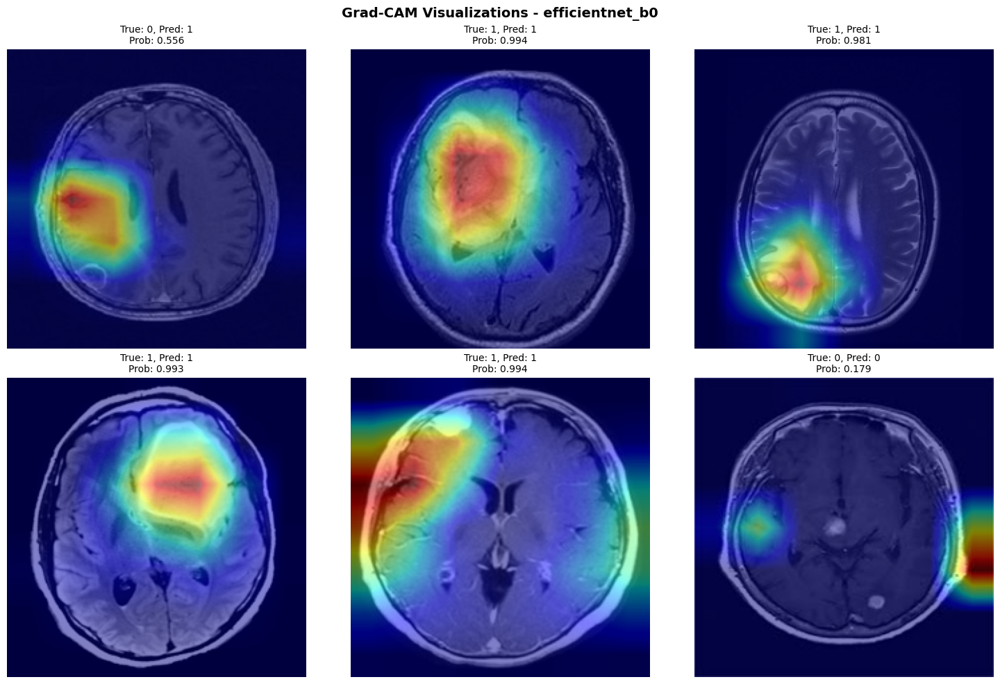

Saved Grad-CAM images (up to 6 samples)

Evaluating densenet121...


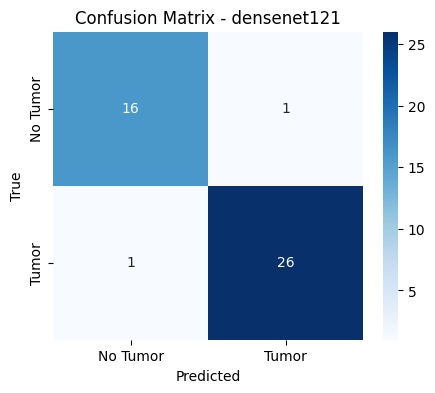

Saved confusion matrix: results/plots/confusion_matrix_densenet121.png
Classification report:
              precision    recall  f1-score   support

    No Tumor       0.94      0.94      0.94        17
       Tumor       0.96      0.96      0.96        27

    accuracy                           0.95        44
   macro avg       0.95      0.95      0.95        44
weighted avg       0.95      0.95      0.95        44


AUC-ROC Score: 0.9826



Saved error analysis: results/tables/error_analysis_densenet121.csv

Error Analysis Summary (first 10 rows):
    filename                                               path  true_label  \
0    N15.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
1   Y180.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
2   Y155.JPG  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
3     N3.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
4    Y99.JPG  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
5    N19.JPG  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
6    Y73.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
7    Y79.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
8  24 no.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
9    Y38.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   

   pred_label  probab

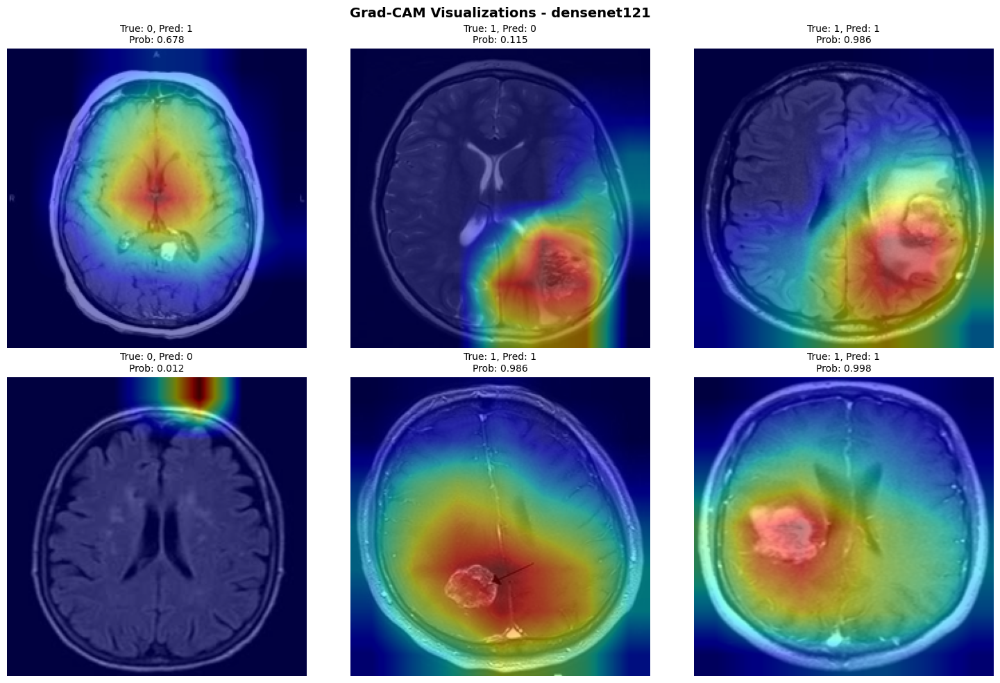

Saved Grad-CAM images (up to 6 samples)

Evaluating resnet50...


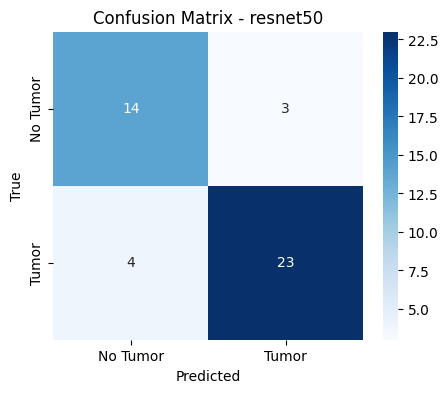

Saved confusion matrix: results/plots/confusion_matrix_resnet50.png
Classification report:
              precision    recall  f1-score   support

    No Tumor       0.78      0.82      0.80        17
       Tumor       0.88      0.85      0.87        27

    accuracy                           0.84        44
   macro avg       0.83      0.84      0.83        44
weighted avg       0.84      0.84      0.84        44


AUC-ROC Score: 0.9390



Saved error analysis: results/tables/error_analysis_resnet50.csv

Error Analysis Summary (first 10 rows):
    filename                                               path  true_label  \
0    N15.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
1   Y180.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
2   Y155.JPG  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
3     N3.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
4    Y99.JPG  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
5    N19.JPG  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
6    Y73.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
7    Y79.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
8  24 no.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
9    Y38.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   

   pred_label  probabili

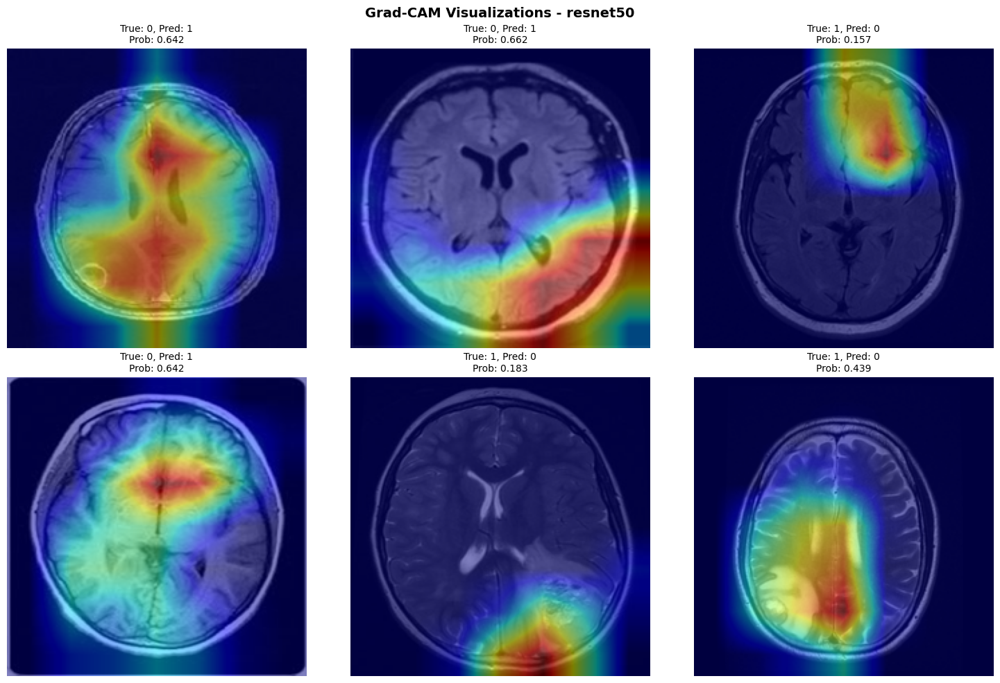

Saved Grad-CAM images (up to 6 samples)


In [89]:
# You already have everything in your pipeline code. Just run this:

# 1. Load your test data (you already have this from earlier)
# test_df is your test dataframe from the train/test split
train_df_full, test_df = train_test_split(
    df, 
    stratify=df['label'], 
    test_size=0.2,
    random_state=42
    )
os.makedirs("results/data", exist_ok=True)
test_df.to_csv("results/data/test_df.csv", index=False)
train_df_full.to_csv("results/data/train_df_full.csv", index=False)

# 2. Create test dataloader
test_dataset = BrainTumorDataset(test_df, transform=val_transform)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

# 3. Load a saved model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = build_model('efficientnet_b0', dropout_rate=0.0)  # or 'efficientnet_b0', 'densenet121'
model.load_state_dict(torch.load('/kaggle/input/best_efficientnet_b0_model/pytorch/default/1/best_efficientnet_b0_model.pth'))
model.to(device)

# 4. Run evaluation - this generates everything
metrics = evaluate_and_save(
    model=model,
    model_name='efficientnet_b0',
    test_loader=test_loader,
    test_df=test_df,
    device=device,
    num_gradcam_samples=6
)

# creates:
# - Confusion matrix
# - Classification report
# - Error analysis CSV
# - False positives/negatives tables
# - Grad-CAM visualizations

############# densenet121 

# 3. Load a saved model   densenet121
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = build_model('densenet121', dropout_rate=0.0)  # or 'efficientnet_b0', 'densenet121'
model.load_state_dict(torch.load('/kaggle/input/best_densenet121_model/pytorch/default/1/best_densenet121_model.pth'))
model.to(device)

# 4. Run evaluation - this generates everything
metrics = evaluate_and_save(
    model=model,
    model_name='densenet121',
    test_loader=test_loader,
    test_df=test_df,
    device=device,
    num_gradcam_samples=6
)
############# resnet50 

# 3. Load a saved model  
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = build_model('resnet50', dropout_rate=0.0)  # or 'efficientnet_b0', 'densenet121'
model.load_state_dict(torch.load('/kaggle/input/best_resnet50_model/pytorch/default/1/best_resnet50_model.pth'))
model.to(device)

# 4. Run evaluation - this generates everything
metrics = evaluate_and_save(
    model=model,
    model_name='resnet50',
    test_loader=test_loader,
    test_df=test_df,
    device=device,
    num_gradcam_samples=6
)



[I 2025-10-01 06:21:15,983] A new study created in memory with name: no-name-8051685c-5efd-4a1d-a34f-d4f501f1c0d1


Train set size: 176
Test set size: 44
Train label distribution:
label
1    110
0     66
Name: count, dtype: int64
Test label distribution:
label
1    27
0    17
Name: count, dtype: int64
Using device: cuda

Processing RESNET50
Optimizing hyperparameters for resnet50...

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6192
Val Loss: 0.6694, Accuracy: 0.6667, AUC: 0.7727, Precision: 0.7778, Recall: 0.6364
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.5037
Val Loss: 0.5655, Accuracy: 0.8056, AUC: 0.8442, Precision: 0.7778, Recall: 0.9545
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.2783
Val Loss: 0.5912, Accuracy: 0.7222, AUC: 0.8604, Precision: 0.7000, Recall: 0.9545
No improvement for 1 epoch(s)

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.2288
Val Loss: 0.6118, Accuracy: 0.7222, AUC: 0.8864, Precision: 0.6875, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 5/10


[I 2025-10-01 06:21:28,587] Trial 0 finished with value: 0.9545454545454546 and parameters: {'lr': 7.465586150916565e-05, 'batch_size': 32, 'dropout_rate': 0.3614677821622209, 'weight_decay': 5.173432748249275e-06, 'optimizer': 'Adam', 'scheduler': 'cosine'}. Best is trial 0 with value: 0.9545454545454546.


Epoch 5 Summary:
Train Loss: 0.1495
Val Loss: 0.7112, Accuracy: 0.7778, AUC: 0.9091, Precision: 0.7333, Recall: 1.0000
No improvement for 3 epoch(s)
Early stopping triggered at epoch 5

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6886
Val Loss: 0.6954, Accuracy: 0.5000, AUC: 0.4838, Precision: 0.6250, Recall: 0.4545
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.6912
Val Loss: 0.6948, Accuracy: 0.4722, AUC: 0.4383, Precision: 0.6154, Recall: 0.3636
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.6949
Val Loss: 0.6807, Accuracy: 0.4722, AUC: 0.5909, Precision: 0.5882, Recall: 0.4545
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.6872
Val Loss: 0.6777, Accuracy: 0.6667, AUC: 0.6299, Precision: 0.7500, Recall: 0.6818
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.6690
Val Loss: 0.6735, Accuracy: 0.6111, AUC: 0.6299, Precision: 0.7000, Recall: 0.6364
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.6645
Val Loss: 0.6721, Accuracy: 0.6389, AUC: 0.6429, Precision: 0.6957, Recall: 0.7273
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.6701
Val Loss: 0.6735, Accuracy: 0.6389, AUC: 0.6299, Precision: 0.6957, Recall: 0.7273
No improvement for 1 epoch(s)

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.6750
Val Loss: 0.6754, Accuracy: 0.5556, AUC: 0.6071, Precision: 0.6500, Recall: 0.5909
No improvement for 2 epoch(s)

Epoch 9/10


[I 2025-10-01 06:21:50,963] Trial 1 finished with value: 0.6850649350649352 and parameters: {'lr': 1.6688833085587853e-05, 'batch_size': 16, 'dropout_rate': 0.17880182122190047, 'weight_decay': 9.215923446706525e-05, 'optimizer': 'SGD', 'scheduler': 'step'}. Best is trial 0 with value: 0.9545454545454546.


Epoch 9 Summary:
Train Loss: 0.6691
Val Loss: 0.6787, Accuracy: 0.6111, AUC: 0.6006, Precision: 0.6667, Recall: 0.7273
No improvement for 3 epoch(s)
Early stopping triggered at epoch 9

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.7213
Val Loss: 4.5962, Accuracy: 0.6111, AUC: 0.8117, Precision: 0.6111, Recall: 1.0000
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.5194
Val Loss: 10.7180, Accuracy: 0.3889, AUC: 0.4870, Precision: 0.0000, Recall: 0.0000
No improvement for 1 epoch(s)

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.3639
Val Loss: 4.1994, Accuracy: 0.7222, AUC: 0.8149, Precision: 0.6875, Recall: 1.0000
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.4226
Val Loss: 2.3044, Accuracy: 0.6667, AUC: 0.7630, Precision: 0.6562, Recall: 0.9545
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.2995
Val Loss: 2.7592, Accuracy: 0.5278, AUC: 0.5714, Precision: 0.6000, Recall: 0.6818
No improvement for 1 epoch(s)

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.2762
Val Loss: 3.6053, Accuracy: 0.7778, AUC: 0.6916, Precision: 0.7333, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 7/10


[I 2025-10-01 06:22:08,694] Trial 2 finished with value: 0.9074675324675324 and parameters: {'lr': 0.000725759680574185, 'batch_size': 16, 'dropout_rate': 0.2767901812614587, 'weight_decay': 1.3426206809702167e-06, 'optimizer': 'AdamW', 'scheduler': 'plateau'}. Best is trial 0 with value: 0.9545454545454546.


Epoch 7 Summary:
Train Loss: 0.3984
Val Loss: 13.8030, Accuracy: 0.8056, AUC: 0.7565, Precision: 0.7586, Recall: 1.0000
No improvement for 3 epoch(s)
Early stopping triggered at epoch 7

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6505
Val Loss: 0.6457, Accuracy: 0.6667, AUC: 0.7695, Precision: 0.6471, Recall: 1.0000
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.5621
Val Loss: 0.6324, Accuracy: 0.7778, AUC: 0.8117, Precision: 0.7333, Recall: 1.0000
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.5099
Val Loss: 0.6188, Accuracy: 0.7222, AUC: 0.8084, Precision: 0.7143, Recall: 0.9091
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.4608
Val Loss: 0.6009, Accuracy: 0.7222, AUC: 0.8019, Precision: 0.7308, Recall: 0.8636
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.4771
Val Loss: 0.5733, Accuracy: 0.7500, AUC: 0.8117, Precision: 0.7407, Recall: 0.9091
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.3953
Val Loss: 0.5380, Accuracy: 0.7500, AUC: 0.8182, Precision: 0.7407, Recall: 0.9091
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.3233
Val Loss: 0.4854, Accuracy: 0.7778, AUC: 0.8409, Precision: 0.7692, Recall: 0.9091
Saved new best model at epoch 7

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.4022
Val Loss: 0.4437, Accuracy: 0.7778, AUC: 0.8799, Precision: 0.7692, Recall: 0.9091
Saved new best model at epoch 8

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.3193
Val Loss: 0.4092, Accuracy: 0.8056, AUC: 0.9091, Precision: 0.7778, Recall: 0.9545
Saved new best model at epoch 9

Epoch 10/10


Epoch 10 Summary:
Train Loss: 0.3101
Val Loss: 0.4037, Accuracy: 0.8056, AUC: 0.9058, Precision: 0.7778, Recall: 0.9545


[I 2025-10-01 06:22:35,503] Trial 3 finished with value: 0.9545454545454546 and parameters: {'lr': 2.3350143341712918e-05, 'batch_size': 64, 'dropout_rate': 0.03778084170294527, 'weight_decay': 5.55827588659444e-06, 'optimizer': 'Adam', 'scheduler': 'plateau'}. Best is trial 0 with value: 0.9545454545454546.


Saved new best model at epoch 10

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.4933
Val Loss: 1.7404, Accuracy: 0.7222, AUC: 0.8084, Precision: 0.6875, Recall: 1.0000
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.5851
Val Loss: 0.9746, Accuracy: 0.7500, AUC: 0.7435, Precision: 0.7826, Recall: 0.8182
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.4100
Val Loss: 1.5241, Accuracy: 0.8333, AUC: 0.8019, Precision: 0.7857, Recall: 1.0000
No improvement for 1 epoch(s)

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.2606
Val Loss: 0.7051, Accuracy: 0.7500, AUC: 0.7727, Precision: 0.7600, Recall: 0.8636
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.2646
Val Loss: 1.3261, Accuracy: 0.6944, AUC: 0.7906, Precision: 0.7391, Recall: 0.7727
No improvement for 1 epoch(s)

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.2311
Val Loss: 1.0245, Accuracy: 0.8056, AUC: 0.7597, Precision: 0.7778, Recall: 0.9545
No improvement for 2 epoch(s)

Epoch 7/10


[I 2025-10-01 06:22:53,450] Trial 4 finished with value: 0.9042207792207793 and parameters: {'lr': 0.00035226153914334833, 'batch_size': 16, 'dropout_rate': 0.043230662029895395, 'weight_decay': 0.0013082351924389728, 'optimizer': 'Adam', 'scheduler': 'cosine'}. Best is trial 0 with value: 0.9545454545454546.


Epoch 7 Summary:
Train Loss: 0.2210
Val Loss: 1.2145, Accuracy: 0.8056, AUC: 0.7987, Precision: 0.7778, Recall: 0.9545
No improvement for 3 epoch(s)
Early stopping triggered at epoch 7

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6355
Val Loss: 0.6616, Accuracy: 0.6667, AUC: 0.6916, Precision: 0.6562, Recall: 0.9545
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.5344
Val Loss: 0.6282, Accuracy: 0.6944, AUC: 0.7240, Precision: 0.6897, Recall: 0.9091
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.4386
Val Loss: 0.5439, Accuracy: 0.6944, AUC: 0.8344, Precision: 0.6897, Recall: 0.9091
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.3454
Val Loss: 0.4521, Accuracy: 0.7500, AUC: 0.8799, Precision: 0.7407, Recall: 0.9091
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.3651
Val Loss: 0.4061, Accuracy: 0.7778, AUC: 0.9188, Precision: 0.7692, Recall: 0.9091
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.2437
Val Loss: 0.4171, Accuracy: 0.7778, AUC: 0.9188, Precision: 0.7692, Recall: 0.9091
No improvement for 1 epoch(s)

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.2519
Val Loss: 0.4318, Accuracy: 0.8056, AUC: 0.9058, Precision: 0.8000, Recall: 0.9091
No improvement for 2 epoch(s)

Epoch 8/10


[I 2025-10-01 06:23:14,833] Trial 5 finished with value: 0.9366883116883118 and parameters: {'lr': 1.9656714738486366e-05, 'batch_size': 16, 'dropout_rate': 0.36505005659994494, 'weight_decay': 0.00015726103481772638, 'optimizer': 'Adam', 'scheduler': 'step'}. Best is trial 0 with value: 0.9545454545454546.


Epoch 8 Summary:
Train Loss: 0.2287
Val Loss: 0.4679, Accuracy: 0.8333, AUC: 0.9091, Precision: 0.8077, Recall: 0.9545
No improvement for 3 epoch(s)
Early stopping triggered at epoch 8

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6876
Val Loss: 0.6327, Accuracy: 0.6111, AUC: 0.6623, Precision: 0.6111, Recall: 1.0000
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.6239
Val Loss: 0.6340, Accuracy: 0.7222, AUC: 0.7597, Precision: 0.6875, Recall: 1.0000
No improvement for 1 epoch(s)

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.5897
Val Loss: 0.6135, Accuracy: 0.8333, AUC: 0.8344, Precision: 0.7857, Recall: 1.0000
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.5479
Val Loss: 0.5890, Accuracy: 0.8333, AUC: 0.8636, Precision: 0.7857, Recall: 1.0000
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.5000
Val Loss: 0.5651, Accuracy: 0.8333, AUC: 0.9091, Precision: 0.8077, Recall: 0.9545
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.4438
Val Loss: 0.5366, Accuracy: 0.8333, AUC: 0.9513, Precision: 0.8077, Recall: 0.9545
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.4442
Val Loss: 0.5296, Accuracy: 0.8333, AUC: 0.9513, Precision: 0.8077, Recall: 0.9545
Saved new best model at epoch 7

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.3819
Val Loss: 0.5037, Accuracy: 0.8333, AUC: 0.9545, Precision: 0.8077, Recall: 0.9545
Saved new best model at epoch 8

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.3175
Val Loss: 0.4702, Accuracy: 0.8056, AUC: 0.9545, Precision: 0.7778, Recall: 0.9545
Saved new best model at epoch 9

Epoch 10/10


Epoch 10 Summary:
Train Loss: 0.3742
Val Loss: 0.4489, Accuracy: 0.8056, AUC: 0.9448, Precision: 0.7778, Recall: 0.9545


[I 2025-10-01 06:23:42,442] Trial 6 finished with value: 0.9772727272727273 and parameters: {'lr': 1.3851653565283283e-05, 'batch_size': 32, 'dropout_rate': 0.4254947502220325, 'weight_decay': 3.087771001205846e-05, 'optimizer': 'Adam', 'scheduler': 'plateau'}. Best is trial 6 with value: 0.9772727272727273.


Saved new best model at epoch 10

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.5624
Val Loss: 1.1240, Accuracy: 0.8611, AUC: 0.7727, Precision: 0.8400, Recall: 0.9545
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.5170
Val Loss: 20.8554, Accuracy: 0.6944, AUC: 0.6429, Precision: 0.6667, Recall: 1.0000
No improvement for 1 epoch(s)

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.4597
Val Loss: 44.2735, Accuracy: 0.6111, AUC: 0.7143, Precision: 0.6111, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 4/10


[I 2025-10-01 06:23:53,554] Trial 7 finished with value: 0.8944805194805194 and parameters: {'lr': 0.0006668749190736642, 'batch_size': 16, 'dropout_rate': 0.35589861888584584, 'weight_decay': 3.267338374410414e-06, 'optimizer': 'Adam', 'scheduler': 'step'}. Best is trial 6 with value: 0.9772727272727273.


Epoch 4 Summary:
Train Loss: 0.4752
Val Loss: 6.1651, Accuracy: 0.7222, AUC: 0.7890, Precision: 0.6875, Recall: 1.0000
No improvement for 3 epoch(s)
Early stopping triggered at epoch 4

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.7073
Val Loss: 0.7448, Accuracy: 0.3889, AUC: 0.7662, Precision: 0.0000, Recall: 0.0000
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.6595
Val Loss: 0.6292, Accuracy: 0.7500, AUC: 0.7987, Precision: 0.7241, Recall: 0.9545
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.6032
Val Loss: 0.6101, Accuracy: 0.8056, AUC: 0.8636, Precision: 0.8261, Recall: 0.8636
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.5168
Val Loss: 0.5709, Accuracy: 0.8056, AUC: 0.8604, Precision: 0.8261, Recall: 0.8636
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.4757
Val Loss: 0.4970, Accuracy: 0.7500, AUC: 0.8701, Precision: 0.7407, Recall: 0.9091
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.4221
Val Loss: 0.4776, Accuracy: 0.7222, AUC: 0.8831, Precision: 0.7308, Recall: 0.8636
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.3772
Val Loss: 0.4777, Accuracy: 0.7500, AUC: 0.8669, Precision: 0.7407, Recall: 0.9091
No improvement for 1 epoch(s)

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.4130
Val Loss: 0.4725, Accuracy: 0.7778, AUC: 0.8701, Precision: 0.7692, Recall: 0.9091
Saved new best model at epoch 8

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.4201
Val Loss: 0.4399, Accuracy: 0.8056, AUC: 0.8929, Precision: 0.8000, Recall: 0.9091
Saved new best model at epoch 9

Epoch 10/10


Epoch 10 Summary:
Train Loss: 0.3450
Val Loss: 0.4329, Accuracy: 0.8056, AUC: 0.8994, Precision: 0.8000, Recall: 0.9091


[I 2025-10-01 06:24:21,255] Trial 8 finished with value: 0.926948051948052 and parameters: {'lr': 0.0005770093361693785, 'batch_size': 16, 'dropout_rate': 0.24394985920322254, 'weight_decay': 0.0004111795643024793, 'optimizer': 'SGD', 'scheduler': 'step'}. Best is trial 6 with value: 0.9772727272727273.


Saved new best model at epoch 10

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6689
Val Loss: 0.7711, Accuracy: 0.3889, AUC: 0.2240, Precision: 0.0000, Recall: 0.0000
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.6922
Val Loss: 0.7391, Accuracy: 0.3889, AUC: 0.4058, Precision: 0.0000, Recall: 0.0000
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.7048
Val Loss: 0.7169, Accuracy: 0.3611, AUC: 0.4221, Precision: 0.3333, Recall: 0.0455
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.6884
Val Loss: 0.7057, Accuracy: 0.3889, AUC: 0.4188, Precision: 0.5000, Recall: 0.2727
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.7019
Val Loss: 0.6977, Accuracy: 0.4167, AUC: 0.4351, Precision: 0.5294, Recall: 0.4091
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.6751
Val Loss: 0.6898, Accuracy: 0.5556, AUC: 0.5162, Precision: 0.6364, Recall: 0.6364
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.7117
Val Loss: 0.6864, Accuracy: 0.5278, AUC: 0.5617, Precision: 0.6190, Recall: 0.5909
Saved new best model at epoch 7

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.6777
Val Loss: 0.6840, Accuracy: 0.5833, AUC: 0.5617, Precision: 0.6842, Recall: 0.5909
Saved new best model at epoch 8

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.7157
Val Loss: 0.6877, Accuracy: 0.5556, AUC: 0.5552, Precision: 0.6667, Recall: 0.5455
No improvement for 1 epoch(s)

Epoch 10/10


[I 2025-10-01 06:24:48,942] Trial 9 finished with value: 0.599025974025974 and parameters: {'lr': 1.9207672485851118e-05, 'batch_size': 64, 'dropout_rate': 0.22741873513457678, 'weight_decay': 9.51651238183177e-05, 'optimizer': 'SGD', 'scheduler': 'cosine'}. Best is trial 6 with value: 0.9772727272727273.


Epoch 10 Summary:
Train Loss: 0.7076
Val Loss: 0.6923, Accuracy: 0.5556, AUC: 0.5162, Precision: 0.7143, Recall: 0.4545
No improvement for 2 epoch(s)

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6608
Val Loss: 0.6471, Accuracy: 0.8056, AUC: 0.8312, Precision: 0.7586, Recall: 1.0000
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.4646
Val Loss: 0.5842, Accuracy: 0.6667, AUC: 0.8247, Precision: 0.6471, Recall: 1.0000
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.3406
Val Loss: 0.5873, Accuracy: 0.6944, AUC: 0.8669, Precision: 0.6667, Recall: 1.0000
No improvement for 1 epoch(s)

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.2599
Val Loss: 0.7077, Accuracy: 0.6944, AUC: 0.8799, Precision: 0.6667, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 5/10


[I 2025-10-01 06:25:02,657] Trial 10 finished with value: 0.948051948051948 and parameters: {'lr': 6.893510522144804e-05, 'batch_size': 32, 'dropout_rate': 0.49645155839502836, 'weight_decay': 0.00992772419675688, 'optimizer': 'AdamW', 'scheduler': 'plateau'}. Best is trial 6 with value: 0.9772727272727273.


Epoch 5 Summary:
Train Loss: 0.2148
Val Loss: 0.8154, Accuracy: 0.7778, AUC: 0.8961, Precision: 0.7333, Recall: 1.0000
No improvement for 3 epoch(s)
Early stopping triggered at epoch 5

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6033
Val Loss: 0.7500, Accuracy: 0.4722, AUC: 0.7208, Precision: 0.8000, Recall: 0.1818
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.4191
Val Loss: 0.5331, Accuracy: 0.7778, AUC: 0.8864, Precision: 0.7692, Recall: 0.9091
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.3636
Val Loss: 0.6903, Accuracy: 0.6944, AUC: 0.9675, Precision: 0.6667, Recall: 1.0000
No improvement for 1 epoch(s)

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.2940
Val Loss: 0.8999, Accuracy: 0.7500, AUC: 0.9643, Precision: 0.7097, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 5/10


[I 2025-10-01 06:25:16,445] Trial 11 finished with value: 0.9837662337662337 and parameters: {'lr': 7.37632382713534e-05, 'batch_size': 32, 'dropout_rate': 0.4783915502161968, 'weight_decay': 1.5243056421769568e-05, 'optimizer': 'Adam', 'scheduler': 'cosine'}. Best is trial 11 with value: 0.9837662337662337.


Epoch 5 Summary:
Train Loss: 0.2105
Val Loss: 0.7289, Accuracy: 0.8056, AUC: 0.9610, Precision: 0.7586, Recall: 1.0000
No improvement for 3 epoch(s)
Early stopping triggered at epoch 5

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.5634
Val Loss: 0.8542, Accuracy: 0.5000, AUC: 0.7890, Precision: 1.0000, Recall: 0.1818
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.3811
Val Loss: 0.7390, Accuracy: 0.7222, AUC: 0.7727, Precision: 0.7727, Recall: 0.7727
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.1986
Val Loss: 1.3591, Accuracy: 0.7778, AUC: 0.8084, Precision: 0.7500, Recall: 0.9545
No improvement for 1 epoch(s)

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.2618
Val Loss: 1.1083, Accuracy: 0.8056, AUC: 0.8052, Precision: 0.7586, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 5/10


[I 2025-10-01 06:25:30,256] Trial 12 finished with value: 0.9090909090909091 and parameters: {'lr': 0.00018325474154230517, 'batch_size': 32, 'dropout_rate': 0.4951214317784089, 'weight_decay': 2.1884583468997688e-05, 'optimizer': 'Adam', 'scheduler': 'cosine'}. Best is trial 11 with value: 0.9837662337662337.


Epoch 5 Summary:
Train Loss: 0.1394
Val Loss: 1.1146, Accuracy: 0.8056, AUC: 0.8182, Precision: 0.7778, Recall: 0.9545
No improvement for 3 epoch(s)
Early stopping triggered at epoch 5

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6756
Val Loss: 0.6987, Accuracy: 0.4444, AUC: 0.7565, Precision: 0.7500, Recall: 0.1364
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.5217
Val Loss: 0.6226, Accuracy: 0.7500, AUC: 0.7727, Precision: 0.7407, Recall: 0.9091
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.4314
Val Loss: 0.5604, Accuracy: 0.7500, AUC: 0.8831, Precision: 0.7241, Recall: 0.9545
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.3062
Val Loss: 0.5405, Accuracy: 0.7222, AUC: 0.8539, Precision: 0.7000, Recall: 0.9545
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.3244
Val Loss: 0.5571, Accuracy: 0.7222, AUC: 0.8539, Precision: 0.7000, Recall: 0.9545
No improvement for 1 epoch(s)

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.2007
Val Loss: 0.5675, Accuracy: 0.7222, AUC: 0.8799, Precision: 0.7000, Recall: 0.9545
No improvement for 2 epoch(s)

Epoch 7/10


[I 2025-10-01 06:25:49,699] Trial 13 finished with value: 0.9545454545454546 and parameters: {'lr': 4.126446966691887e-05, 'batch_size': 32, 'dropout_rate': 0.41173732909059435, 'weight_decay': 1.701444403421835e-05, 'optimizer': 'Adam', 'scheduler': 'plateau'}. Best is trial 11 with value: 0.9837662337662337.


Epoch 7 Summary:
Train Loss: 0.1909
Val Loss: 0.6191, Accuracy: 0.8056, AUC: 0.9091, Precision: 0.7586, Recall: 1.0000
No improvement for 3 epoch(s)
Early stopping triggered at epoch 7

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.5900
Val Loss: 0.6008, Accuracy: 0.6667, AUC: 0.7695, Precision: 0.6471, Recall: 1.0000
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.4096
Val Loss: 0.7760, Accuracy: 0.6111, AUC: 0.8474, Precision: 0.6111, Recall: 1.0000
No improvement for 1 epoch(s)

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.2024
Val Loss: 1.0253, Accuracy: 0.6389, AUC: 0.8312, Precision: 0.6286, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 4/10


[I 2025-10-01 06:26:00,825] Trial 14 finished with value: 0.9253246753246753 and parameters: {'lr': 0.0001441977035805589, 'batch_size': 32, 'dropout_rate': 0.4203597161169562, 'weight_decay': 2.3254868118587078e-05, 'optimizer': 'Adam', 'scheduler': 'cosine'}. Best is trial 11 with value: 0.9837662337662337.


Epoch 4 Summary:
Train Loss: 0.1768
Val Loss: 1.0724, Accuracy: 0.7500, AUC: 0.8506, Precision: 0.7097, Recall: 1.0000
No improvement for 3 epoch(s)
Early stopping triggered at epoch 4

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6521
Val Loss: 0.6956, Accuracy: 0.3889, AUC: 0.6234, Precision: 0.5000, Recall: 0.2727
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.5887
Val Loss: 0.6617, Accuracy: 0.7500, AUC: 0.7630, Precision: 0.7407, Recall: 0.9091
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.5658
Val Loss: 0.6206, Accuracy: 0.7222, AUC: 0.8539, Precision: 0.6875, Recall: 1.0000
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.5374
Val Loss: 0.5919, Accuracy: 0.7500, AUC: 0.8571, Precision: 0.7097, Recall: 1.0000
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.4567
Val Loss: 0.5490, Accuracy: 0.7222, AUC: 0.8831, Precision: 0.6875, Recall: 1.0000
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.4727
Val Loss: 0.5060, Accuracy: 0.8333, AUC: 0.8994, Precision: 0.7857, Recall: 1.0000
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.4338
Val Loss: 0.4650, Accuracy: 0.8056, AUC: 0.9058, Precision: 0.7778, Recall: 0.9545
Saved new best model at epoch 7

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.4140
Val Loss: 0.4296, Accuracy: 0.8056, AUC: 0.9091, Precision: 0.7778, Recall: 0.9545
Saved new best model at epoch 8

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.3892
Val Loss: 0.4117, Accuracy: 0.7778, AUC: 0.9091, Precision: 0.7692, Recall: 0.9091
Saved new best model at epoch 9

Epoch 10/10


Epoch 10 Summary:
Train Loss: 0.3094
Val Loss: 0.4037, Accuracy: 0.7778, AUC: 0.9058, Precision: 0.7692, Recall: 0.9091


[I 2025-10-01 06:26:30,064] Trial 15 finished with value: 0.9545454545454546 and parameters: {'lr': 1.1304841245544256e-05, 'batch_size': 32, 'dropout_rate': 0.43045105659956806, 'weight_decay': 1.993696505758754e-05, 'optimizer': 'AdamW', 'scheduler': 'plateau'}. Best is trial 11 with value: 0.9837662337662337.


Saved new best model at epoch 10

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6548
Val Loss: 0.7269, Accuracy: 0.5278, AUC: 0.5552, Precision: 0.8571, Recall: 0.2727
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.4901
Val Loss: 0.6657, Accuracy: 0.7222, AUC: 0.7435, Precision: 0.7500, Recall: 0.8182
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.4068
Val Loss: 0.6506, Accuracy: 0.6944, AUC: 0.7370, Precision: 0.6774, Recall: 0.9545
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.3505
Val Loss: 0.6161, Accuracy: 0.6944, AUC: 0.7987, Precision: 0.6774, Recall: 0.9545
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.3024
Val Loss: 0.5986, Accuracy: 0.7500, AUC: 0.8442, Precision: 0.7241, Recall: 0.9545
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.2110
Val Loss: 0.6030, Accuracy: 0.7778, AUC: 0.8474, Precision: 0.7500, Recall: 0.9545
No improvement for 1 epoch(s)

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.2565
Val Loss: 0.6094, Accuracy: 0.8056, AUC: 0.8636, Precision: 0.7586, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 8/10


[I 2025-10-01 06:26:52,404] Trial 16 finished with value: 0.9415584415584415 and parameters: {'lr': 4.181362614275326e-05, 'batch_size': 32, 'dropout_rate': 0.30495082323895606, 'weight_decay': 6.179420764741082e-05, 'optimizer': 'Adam', 'scheduler': 'cosine'}. Best is trial 11 with value: 0.9837662337662337.


Epoch 8 Summary:
Train Loss: 0.3743
Val Loss: 0.6313, Accuracy: 0.8056, AUC: 0.8831, Precision: 0.7586, Recall: 1.0000
No improvement for 3 epoch(s)
Early stopping triggered at epoch 8

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.5285
Val Loss: 1.0943, Accuracy: 0.6111, AUC: 0.8052, Precision: 0.6111, Recall: 1.0000
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.3024
Val Loss: 1.8483, Accuracy: 0.6111, AUC: 0.8506, Precision: 0.6111, Recall: 1.0000
No improvement for 1 epoch(s)

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.1943
Val Loss: 2.7607, Accuracy: 0.6111, AUC: 0.8701, Precision: 0.6111, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 4/10


[I 2025-10-01 06:27:03,411] Trial 17 finished with value: 0.935064935064935 and parameters: {'lr': 0.0002342113584812514, 'batch_size': 32, 'dropout_rate': 0.13508578658128012, 'weight_decay': 0.00036967179664629013, 'optimizer': 'Adam', 'scheduler': 'plateau'}. Best is trial 11 with value: 0.9837662337662337.


Epoch 4 Summary:
Train Loss: 0.1868
Val Loss: 2.4536, Accuracy: 0.6667, AUC: 0.8295, Precision: 0.6471, Recall: 1.0000
No improvement for 3 epoch(s)
Early stopping triggered at epoch 4

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.7190
Val Loss: 0.6882, Accuracy: 0.5833, AUC: 0.5519, Precision: 0.6667, Recall: 0.6364
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.5742
Val Loss: 0.6809, Accuracy: 0.5833, AUC: 0.7208, Precision: 0.8889, Recall: 0.3636
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.5066
Val Loss: 0.6393, Accuracy: 0.7222, AUC: 0.8701, Precision: 0.7000, Recall: 0.9545
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.5528
Val Loss: 0.6155, Accuracy: 0.7222, AUC: 0.9026, Precision: 0.6875, Recall: 1.0000
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.4187
Val Loss: 0.6068, Accuracy: 0.6389, AUC: 0.8669, Precision: 0.6286, Recall: 1.0000
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.3397
Val Loss: 0.5992, Accuracy: 0.6389, AUC: 0.8669, Precision: 0.6286, Recall: 1.0000
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.3750
Val Loss: 0.5861, Accuracy: 0.6667, AUC: 0.8636, Precision: 0.6471, Recall: 1.0000
Saved new best model at epoch 7

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.3703
Val Loss: 0.5512, Accuracy: 0.6944, AUC: 0.8669, Precision: 0.6667, Recall: 1.0000
Saved new best model at epoch 8

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.3299
Val Loss: 0.5318, Accuracy: 0.6944, AUC: 0.9026, Precision: 0.6774, Recall: 0.9545
Saved new best model at epoch 9

Epoch 10/10


Epoch 10 Summary:
Train Loss: 0.3750
Val Loss: 0.5007, Accuracy: 0.6944, AUC: 0.9123, Precision: 0.6774, Recall: 0.9545


[I 2025-10-01 06:27:31,741] Trial 18 finished with value: 0.9561688311688312 and parameters: {'lr': 3.501462242720103e-05, 'batch_size': 64, 'dropout_rate': 0.46154395848968405, 'weight_decay': 1.0899872305823229e-06, 'optimizer': 'AdamW', 'scheduler': 'cosine'}. Best is trial 11 with value: 0.9837662337662337.


Saved new best model at epoch 10

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.7033
Val Loss: 0.6748, Accuracy: 0.5556, AUC: 0.2338, Precision: 0.5882, Recall: 0.9091
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.6881
Val Loss: 0.7032, Accuracy: 0.4722, AUC: 0.1623, Precision: 0.5517, Recall: 0.7273
No improvement for 1 epoch(s)

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.6943
Val Loss: 0.7265, Accuracy: 0.3611, AUC: 0.2662, Precision: 0.4615, Recall: 0.2727
No improvement for 2 epoch(s)

Epoch 4/10


[I 2025-10-01 06:27:42,632] Trial 19 finished with value: 0.650974025974026 and parameters: {'lr': 8.610278676575103e-05, 'batch_size': 32, 'dropout_rate': 0.30605460139331375, 'weight_decay': 4.2805795238147185e-05, 'optimizer': 'SGD', 'scheduler': 'plateau'}. Best is trial 11 with value: 0.9837662337662337.


Epoch 4 Summary:
Train Loss: 0.7020
Val Loss: 0.7212, Accuracy: 0.4167, AUC: 0.3929, Precision: 0.5333, Recall: 0.3636
No improvement for 3 epoch(s)
Early stopping triggered at epoch 4
Best parameters for resnet50:
{'lr': 7.37632382713534e-05, 'batch_size': 32, 'dropout_rate': 0.4783915502161968, 'weight_decay': 1.5243056421769568e-05, 'optimizer': 'Adam', 'scheduler': 'cosine'}
Training final resnet50 model with best parameters...

Epoch 1/20


Epoch 1 Summary:
Train Loss: 0.5874
Val Loss: 0.6613, Accuracy: 0.6944, AUC: 0.6883, Precision: 0.6897, Recall: 0.9091
Saved new best model at epoch 1

Epoch 2/20


Epoch 2 Summary:
Train Loss: 0.4453
Val Loss: 0.6222, Accuracy: 0.7500, AUC: 0.7630, Precision: 0.7407, Recall: 0.9091
Saved new best model at epoch 2

Epoch 3/20


Epoch 3 Summary:
Train Loss: 0.3519
Val Loss: 0.6346, Accuracy: 0.7500, AUC: 0.8312, Precision: 0.7407, Recall: 0.9091
No improvement for 1 epoch(s)

Epoch 4/20


Epoch 4 Summary:
Train Loss: 0.2206
Val Loss: 0.7141, Accuracy: 0.8333, AUC: 0.8929, Precision: 0.7857, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 5/20


Epoch 5 Summary:
Train Loss: 0.1917
Val Loss: 0.9274, Accuracy: 0.7778, AUC: 0.9058, Precision: 0.7333, Recall: 1.0000
No improvement for 3 epoch(s)

Epoch 6/20


Epoch 6 Summary:
Train Loss: 0.1579
Val Loss: 0.8808, Accuracy: 0.8056, AUC: 0.8734, Precision: 0.7778, Recall: 0.9545
No improvement for 4 epoch(s)

Epoch 7/20


Epoch 7 Summary:
Train Loss: 0.1171
Val Loss: 0.8529, Accuracy: 0.8333, AUC: 0.8571, Precision: 0.8077, Recall: 0.9545
No improvement for 5 epoch(s)
Early stopping triggered at epoch 7
Evaluating resnet50 on test set...

Evaluating resnet50...


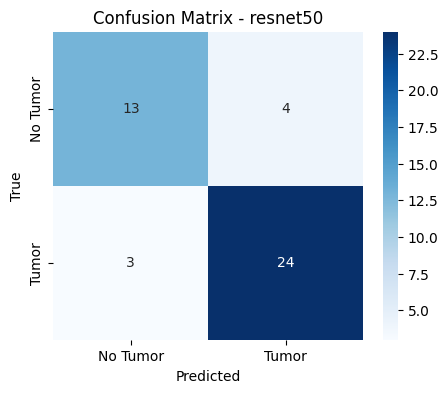

Saved confusion matrix: results/plots/confusion_matrix_resnet50.png
Classification report:
              precision    recall  f1-score   support

    No Tumor       0.81      0.76      0.79        17
       Tumor       0.86      0.89      0.87        27

    accuracy                           0.84        44
   macro avg       0.83      0.83      0.83        44
weighted avg       0.84      0.84      0.84        44


AUC-ROC Score: 0.8824



Saved error analysis: results/tables/error_analysis_resnet50.csv

Error Analysis Summary (first 10 rows):
    filename                                               path  true_label  \
0    N15.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
1   Y180.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
2   Y155.JPG  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
3     N3.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
4    Y99.JPG  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
5    N19.JPG  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
6    Y73.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
7    Y79.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
8  24 no.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
9    Y38.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   

   pred_label  probabili

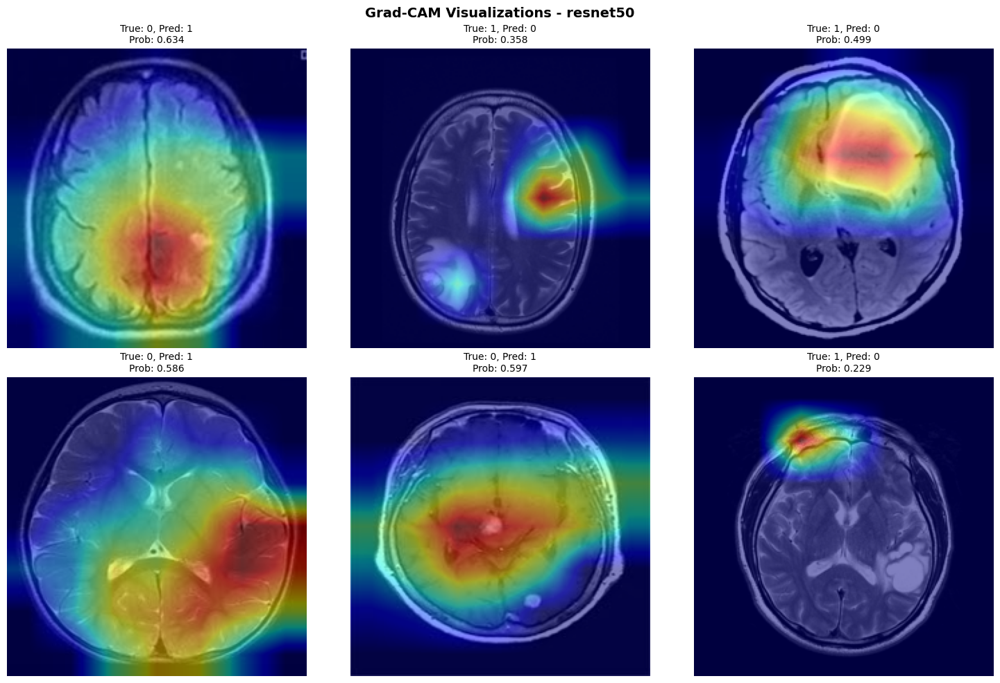

Saved Grad-CAM images (up to 6 samples)


[I 2025-10-01 06:28:04,490] A new study created in memory with name: no-name-f4292a8e-2b7d-4522-8eb5-b5aee641b292



RESNET50 Test Results:
Accuracy:  0.8409
Precision: 0.8571
Recall:    0.8889
AUC:       0.8824

Processing EFFICIENTNET_B0
Optimizing hyperparameters for efficientnet_b0...

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.7125
Val Loss: 0.7052, Accuracy: 0.5000, AUC: 0.5130, Precision: 0.5833, Recall: 0.6364
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.6506
Val Loss: 0.6711, Accuracy: 0.6111, AUC: 0.6916, Precision: 0.6429, Recall: 0.8182
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.6288
Val Loss: 0.6549, Accuracy: 0.6667, AUC: 0.7532, Precision: 0.6562, Recall: 0.9545
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.5822
Val Loss: 0.6422, Accuracy: 0.7500, AUC: 0.7045, Precision: 0.7097, Recall: 1.0000
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.5664
Val Loss: 0.6115, Accuracy: 0.7222, AUC: 0.7695, Precision: 0.7000, Recall: 0.9545
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.5511
Val Loss: 0.5929, Accuracy: 0.7500, AUC: 0.7955, Precision: 0.7241, Recall: 0.9545
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.5171
Val Loss: 0.5811, Accuracy: 0.7500, AUC: 0.8019, Precision: 0.7241, Recall: 0.9545
Saved new best model at epoch 7

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.5237
Val Loss: 0.5728, Accuracy: 0.7500, AUC: 0.8474, Precision: 0.7241, Recall: 0.9545
Saved new best model at epoch 8

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.5110
Val Loss: 0.5702, Accuracy: 0.7500, AUC: 0.8506, Precision: 0.7241, Recall: 0.9545
Saved new best model at epoch 9

Epoch 10/10


[I 2025-10-01 06:28:21,383] Trial 0 finished with value: 0.9253246753246753 and parameters: {'lr': 3.51903543048081e-05, 'batch_size': 16, 'dropout_rate': 0.05219561327144029, 'weight_decay': 0.0027178775945479942, 'optimizer': 'AdamW', 'scheduler': 'cosine'}. Best is trial 0 with value: 0.9253246753246753.


Epoch 10 Summary:
Train Loss: 0.5127
Val Loss: 0.5724, Accuracy: 0.7778, AUC: 0.8474, Precision: 0.7500, Recall: 0.9545
No improvement for 1 epoch(s)

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.7225
Val Loss: 0.6617, Accuracy: 0.6111, AUC: 0.4253, Precision: 0.6111, Recall: 1.0000
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.7018
Val Loss: 0.6404, Accuracy: 0.6111, AUC: 0.5260, Precision: 0.6111, Recall: 1.0000
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.7131
Val Loss: 0.6527, Accuracy: 0.5833, AUC: 0.5357, Precision: 0.6000, Recall: 0.9545
No improvement for 1 epoch(s)

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.7523
Val Loss: 0.6587, Accuracy: 0.5833, AUC: 0.5260, Precision: 0.6061, Recall: 0.9091
No improvement for 2 epoch(s)

Epoch 5/10


[I 2025-10-01 06:28:29,567] Trial 1 finished with value: 0.7678571428571429 and parameters: {'lr': 1.6031384000383154e-05, 'batch_size': 32, 'dropout_rate': 0.44010106352691636, 'weight_decay': 0.0006681950234722474, 'optimizer': 'SGD', 'scheduler': 'cosine'}. Best is trial 0 with value: 0.9253246753246753.


Epoch 5 Summary:
Train Loss: 0.7162
Val Loss: 0.6595, Accuracy: 0.4722, AUC: 0.4740, Precision: 0.5484, Recall: 0.7727
No improvement for 3 epoch(s)
Early stopping triggered at epoch 5

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6821
Val Loss: 0.6709, Accuracy: 0.5556, AUC: 0.4481, Precision: 0.5882, Recall: 0.9091
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.6730
Val Loss: 0.7042, Accuracy: 0.5278, AUC: 0.3539, Precision: 0.5862, Recall: 0.7727
No improvement for 1 epoch(s)

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.6699
Val Loss: 0.7007, Accuracy: 0.4167, AUC: 0.4091, Precision: 0.5172, Recall: 0.6818
No improvement for 2 epoch(s)

Epoch 4/10


[I 2025-10-01 06:28:36,085] Trial 2 finished with value: 0.6818181818181818 and parameters: {'lr': 1.5322161364906707e-05, 'batch_size': 32, 'dropout_rate': 0.012997024117931244, 'weight_decay': 0.0006668598774535113, 'optimizer': 'AdamW', 'scheduler': 'cosine'}. Best is trial 0 with value: 0.9253246753246753.


Epoch 4 Summary:
Train Loss: 0.6776
Val Loss: 0.6983, Accuracy: 0.5556, AUC: 0.4545, Precision: 0.6154, Recall: 0.7273
No improvement for 3 epoch(s)
Early stopping triggered at epoch 4

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6858
Val Loss: 0.7084, Accuracy: 0.4722, AUC: 0.4221, Precision: 0.5882, Recall: 0.4545
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.6627
Val Loss: 0.6994, Accuracy: 0.4722, AUC: 0.4610, Precision: 0.5882, Recall: 0.4545
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.6593
Val Loss: 0.6855, Accuracy: 0.5556, AUC: 0.5844, Precision: 0.6875, Recall: 0.5000
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.6600
Val Loss: 0.6712, Accuracy: 0.6944, AUC: 0.7435, Precision: 0.7619, Recall: 0.7273
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.6482
Val Loss: 0.6572, Accuracy: 0.7500, AUC: 0.7662, Precision: 0.7600, Recall: 0.8636
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.6371
Val Loss: 0.6526, Accuracy: 0.6667, AUC: 0.7403, Precision: 0.6786, Recall: 0.8636
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.6047
Val Loss: 0.6497, Accuracy: 0.6389, AUC: 0.7305, Precision: 0.6452, Recall: 0.9091
Saved new best model at epoch 7

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.6031
Val Loss: 0.6432, Accuracy: 0.6667, AUC: 0.7565, Precision: 0.6562, Recall: 0.9545
Saved new best model at epoch 8

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.5868
Val Loss: 0.6424, Accuracy: 0.6944, AUC: 0.7597, Precision: 0.6774, Recall: 0.9545
Saved new best model at epoch 9

Epoch 10/10


[I 2025-10-01 06:28:52,854] Trial 3 finished with value: 0.8603896103896105 and parameters: {'lr': 3.478477542402124e-05, 'batch_size': 64, 'dropout_rate': 0.41850353856321537, 'weight_decay': 0.001890227179012317, 'optimizer': 'AdamW', 'scheduler': 'plateau'}. Best is trial 0 with value: 0.9253246753246753.


Epoch 10 Summary:
Train Loss: 0.5949
Val Loss: 0.6432, Accuracy: 0.6667, AUC: 0.7273, Precision: 0.6562, Recall: 0.9545
No improvement for 1 epoch(s)

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6938
Val Loss: 0.7104, Accuracy: 0.5833, AUC: 0.3149, Precision: 0.6000, Recall: 0.9545
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.6642
Val Loss: 0.7258, Accuracy: 0.4722, AUC: 0.3831, Precision: 0.5517, Recall: 0.7273
No improvement for 1 epoch(s)

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.6583
Val Loss: 0.7010, Accuracy: 0.5278, AUC: 0.4610, Precision: 0.5862, Recall: 0.7727
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.6289
Val Loss: 0.6629, Accuracy: 0.6389, AUC: 0.5909, Precision: 0.6364, Recall: 0.9545
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.5847
Val Loss: 0.6301, Accuracy: 0.6389, AUC: 0.7338, Precision: 0.6452, Recall: 0.9091
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.5800
Val Loss: 0.6214, Accuracy: 0.7222, AUC: 0.7825, Precision: 0.7143, Recall: 0.9091
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.5523
Val Loss: 0.6270, Accuracy: 0.6944, AUC: 0.7565, Precision: 0.6774, Recall: 0.9545
No improvement for 1 epoch(s)

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.5776
Val Loss: 0.6272, Accuracy: 0.7222, AUC: 0.7208, Precision: 0.7000, Recall: 0.9545
No improvement for 2 epoch(s)

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.5729
Val Loss: 0.6204, Accuracy: 0.6944, AUC: 0.7143, Precision: 0.6774, Recall: 0.9545
Saved new best model at epoch 9

Epoch 10/10


[I 2025-10-01 06:29:09,709] Trial 4 finished with value: 0.8685064935064936 and parameters: {'lr': 5.6275692205785616e-05, 'batch_size': 32, 'dropout_rate': 0.3874035783105845, 'weight_decay': 2.531096315609883e-06, 'optimizer': 'AdamW', 'scheduler': 'cosine'}. Best is trial 0 with value: 0.9253246753246753.


Epoch 10 Summary:
Train Loss: 0.5591
Val Loss: 0.6191, Accuracy: 0.6944, AUC: 0.7338, Precision: 0.6897, Recall: 0.9091
Saved new best model at epoch 10

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6188
Val Loss: 0.6425, Accuracy: 0.8056, AUC: 0.8409, Precision: 0.8947, Recall: 0.7727
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.4559
Val Loss: 0.5949, Accuracy: 0.6389, AUC: 0.8149, Precision: 0.6667, Recall: 0.8182
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.3489
Val Loss: 0.6060, Accuracy: 0.7222, AUC: 0.8149, Precision: 0.7308, Recall: 0.8636
No improvement for 1 epoch(s)

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.2410
Val Loss: 0.6249, Accuracy: 0.7778, AUC: 0.8766, Precision: 0.7692, Recall: 0.9091
No improvement for 2 epoch(s)

Epoch 5/10


[I 2025-10-01 06:29:17,927] Trial 5 finished with value: 0.948051948051948 and parameters: {'lr': 0.00028192722815170647, 'batch_size': 32, 'dropout_rate': 0.20522019064540803, 'weight_decay': 0.00015280600306859398, 'optimizer': 'AdamW', 'scheduler': 'step'}. Best is trial 5 with value: 0.948051948051948.


Epoch 5 Summary:
Train Loss: 0.2478
Val Loss: 0.7371, Accuracy: 0.8889, AUC: 0.9416, Precision: 0.8750, Recall: 0.9545
No improvement for 3 epoch(s)
Early stopping triggered at epoch 5

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6895
Val Loss: 0.7056, Accuracy: 0.3611, AUC: 0.5844, Precision: 0.3333, Recall: 0.0455
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.6580
Val Loss: 0.6939, Accuracy: 0.5556, AUC: 0.6818, Precision: 0.8750, Recall: 0.3182
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.6034
Val Loss: 0.6932, Accuracy: 0.6389, AUC: 0.6851, Precision: 0.6800, Recall: 0.7727
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.5897
Val Loss: 0.6864, Accuracy: 0.6667, AUC: 0.6331, Precision: 0.6667, Recall: 0.9091
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.5181
Val Loss: 0.6487, Accuracy: 0.6944, AUC: 0.6623, Precision: 0.6774, Recall: 0.9545
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.5355
Val Loss: 0.6288, Accuracy: 0.6944, AUC: 0.7078, Precision: 0.6667, Recall: 1.0000
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.4970
Val Loss: 0.6038, Accuracy: 0.7222, AUC: 0.7468, Precision: 0.6875, Recall: 1.0000
Saved new best model at epoch 7

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.4641
Val Loss: 0.5811, Accuracy: 0.7500, AUC: 0.7987, Precision: 0.7097, Recall: 1.0000
Saved new best model at epoch 8

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.4680
Val Loss: 0.5572, Accuracy: 0.7500, AUC: 0.8442, Precision: 0.7097, Recall: 1.0000
Saved new best model at epoch 9

Epoch 10/10


[I 2025-10-01 06:29:35,057] Trial 6 finished with value: 0.9431818181818181 and parameters: {'lr': 6.208663149771029e-05, 'batch_size': 32, 'dropout_rate': 0.24537559069546033, 'weight_decay': 0.00046493230493589987, 'optimizer': 'AdamW', 'scheduler': 'step'}. Best is trial 5 with value: 0.948051948051948.


Epoch 10 Summary:
Train Loss: 0.4423
Val Loss: 0.5033, Accuracy: 0.8333, AUC: 0.8864, Precision: 0.7857, Recall: 1.0000
Saved new best model at epoch 10

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6959
Val Loss: 0.7147, Accuracy: 0.3889, AUC: 0.5260, Precision: 0.5000, Recall: 0.0455
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.7023
Val Loss: 0.7051, Accuracy: 0.4722, AUC: 0.4968, Precision: 0.6667, Recall: 0.2727
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.6533
Val Loss: 0.7014, Accuracy: 0.4722, AUC: 0.4805, Precision: 0.6154, Recall: 0.3636
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.6750
Val Loss: 0.6967, Accuracy: 0.5278, AUC: 0.4773, Precision: 0.6316, Recall: 0.5455
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.6569
Val Loss: 0.6968, Accuracy: 0.5833, AUC: 0.5065, Precision: 0.6667, Recall: 0.6364
No improvement for 1 epoch(s)

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.6424
Val Loss: 0.6919, Accuracy: 0.5000, AUC: 0.5487, Precision: 0.6000, Recall: 0.5455
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.6433
Val Loss: 0.6863, Accuracy: 0.5278, AUC: 0.5649, Precision: 0.6190, Recall: 0.5909
Saved new best model at epoch 7

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.6495
Val Loss: 0.6778, Accuracy: 0.6389, AUC: 0.6071, Precision: 0.6800, Recall: 0.7727
Saved new best model at epoch 8

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.6557
Val Loss: 0.6658, Accuracy: 0.6667, AUC: 0.7045, Precision: 0.6923, Recall: 0.8182
Saved new best model at epoch 9

Epoch 10/10


[I 2025-10-01 06:29:51,750] Trial 7 finished with value: 0.7954545454545454 and parameters: {'lr': 2.2788719474541023e-05, 'batch_size': 64, 'dropout_rate': 0.22401802284288796, 'weight_decay': 2.371121804917918e-06, 'optimizer': 'AdamW', 'scheduler': 'cosine'}. Best is trial 5 with value: 0.948051948051948.


Epoch 10 Summary:
Train Loss: 0.6575
Val Loss: 0.6595, Accuracy: 0.7222, AUC: 0.7273, Precision: 0.7308, Recall: 0.8636
Saved new best model at epoch 10

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6575
Val Loss: 0.7209, Accuracy: 0.5000, AUC: 0.6494, Precision: 0.7500, Recall: 0.2727
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.5383
Val Loss: 0.7079, Accuracy: 0.5278, AUC: 0.6558, Precision: 0.8571, Recall: 0.2727
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.4554
Val Loss: 0.6346, Accuracy: 0.6667, AUC: 0.7760, Precision: 0.8571, Recall: 0.5455
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.3742
Val Loss: 0.5801, Accuracy: 0.6944, AUC: 0.8636, Precision: 0.8235, Recall: 0.6364
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.3501
Val Loss: 0.5325, Accuracy: 0.8611, AUC: 0.8799, Precision: 0.8696, Recall: 0.9091
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.2696
Val Loss: 0.5166, Accuracy: 0.8333, AUC: 0.8669, Precision: 0.8333, Recall: 0.9091
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.3172
Val Loss: 0.5382, Accuracy: 0.8333, AUC: 0.8442, Precision: 0.8333, Recall: 0.9091
No improvement for 1 epoch(s)

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.2087
Val Loss: 0.5194, Accuracy: 0.8333, AUC: 0.8669, Precision: 0.8333, Recall: 0.9091
No improvement for 2 epoch(s)

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.1996
Val Loss: 0.5139, Accuracy: 0.8333, AUC: 0.8961, Precision: 0.8333, Recall: 0.9091
Saved new best model at epoch 9

Epoch 10/10


[I 2025-10-01 06:30:08,397] Trial 8 finished with value: 0.9253246753246753 and parameters: {'lr': 0.00023416415432424075, 'batch_size': 32, 'dropout_rate': 0.26610737487742747, 'weight_decay': 0.0017433709630460487, 'optimizer': 'Adam', 'scheduler': 'cosine'}. Best is trial 5 with value: 0.948051948051948.


Epoch 10 Summary:
Train Loss: 0.2856
Val Loss: 0.5105, Accuracy: 0.8611, AUC: 0.8896, Precision: 0.8400, Recall: 0.9545
Saved new best model at epoch 10

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6972
Val Loss: 0.6610, Accuracy: 0.6389, AUC: 0.6104, Precision: 0.6452, Recall: 0.9091
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.6950
Val Loss: 0.6666, Accuracy: 0.6944, AUC: 0.6266, Precision: 0.6667, Recall: 1.0000
No improvement for 1 epoch(s)

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.6962
Val Loss: 0.6849, Accuracy: 0.4722, AUC: 0.5455, Precision: 0.5556, Recall: 0.6818
No improvement for 2 epoch(s)

Epoch 4/10


[I 2025-10-01 06:30:14,757] Trial 9 finished with value: 0.8133116883116883 and parameters: {'lr': 1.4501809044236623e-05, 'batch_size': 16, 'dropout_rate': 0.37115662807412, 'weight_decay': 0.0040886869737916075, 'optimizer': 'SGD', 'scheduler': 'plateau'}. Best is trial 5 with value: 0.948051948051948.


Epoch 4 Summary:
Train Loss: 0.6834
Val Loss: 0.6749, Accuracy: 0.5556, AUC: 0.5942, Precision: 0.6364, Recall: 0.6364
No improvement for 3 epoch(s)
Early stopping triggered at epoch 4

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.4516
Val Loss: 0.7306, Accuracy: 0.7222, AUC: 0.7987, Precision: 0.7143, Recall: 0.9091
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.3091
Val Loss: 1.4488, Accuracy: 0.7222, AUC: 0.8831, Precision: 0.6875, Recall: 1.0000
No improvement for 1 epoch(s)

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.2737
Val Loss: 1.0082, Accuracy: 0.8889, AUC: 0.9545, Precision: 0.8462, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 4/10


[I 2025-10-01 06:30:21,286] Trial 10 finished with value: 0.9772727272727273 and parameters: {'lr': 0.0009642128449507995, 'batch_size': 16, 'dropout_rate': 0.12174549508564612, 'weight_decay': 4.646761117417878e-05, 'optimizer': 'Adam', 'scheduler': 'step'}. Best is trial 10 with value: 0.9772727272727273.


Epoch 4 Summary:
Train Loss: 0.2393
Val Loss: 1.2778, Accuracy: 0.8889, AUC: 0.9318, Precision: 0.8462, Recall: 1.0000
No improvement for 3 epoch(s)
Early stopping triggered at epoch 4

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.4914
Val Loss: 0.7121, Accuracy: 0.5000, AUC: 0.7273, Precision: 0.8333, Recall: 0.2273
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.3362
Val Loss: 0.7385, Accuracy: 0.6667, AUC: 0.8214, Precision: 0.6471, Recall: 1.0000
No improvement for 1 epoch(s)

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.2383
Val Loss: 0.7636, Accuracy: 0.7778, AUC: 0.9221, Precision: 0.7333, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 4/10


[I 2025-10-01 06:30:27,887] Trial 11 finished with value: 0.961038961038961 and parameters: {'lr': 0.0007783444777758689, 'batch_size': 16, 'dropout_rate': 0.13570537071417815, 'weight_decay': 3.265660387902835e-05, 'optimizer': 'Adam', 'scheduler': 'step'}. Best is trial 10 with value: 0.9772727272727273.


Epoch 4 Summary:
Train Loss: 0.1902
Val Loss: 0.7142, Accuracy: 0.9167, AUC: 0.9058, Precision: 0.9130, Recall: 0.9545
No improvement for 3 epoch(s)
Early stopping triggered at epoch 4

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.5110
Val Loss: 0.6901, Accuracy: 0.6111, AUC: 0.8409, Precision: 1.0000, Recall: 0.3636
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.2913
Val Loss: 0.5573, Accuracy: 0.6944, AUC: 0.7825, Precision: 0.7895, Recall: 0.6818
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.2596
Val Loss: 0.9254, Accuracy: 0.7500, AUC: 0.8961, Precision: 0.7097, Recall: 1.0000
No improvement for 1 epoch(s)

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.2460
Val Loss: 1.2806, Accuracy: 0.7222, AUC: 0.9026, Precision: 0.6875, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 5/10


[I 2025-10-01 06:30:36,021] Trial 12 finished with value: 0.9642857142857143 and parameters: {'lr': 0.0009657264710138077, 'batch_size': 16, 'dropout_rate': 0.1264440025154315, 'weight_decay': 1.6050386011009256e-05, 'optimizer': 'Adam', 'scheduler': 'step'}. Best is trial 10 with value: 0.9772727272727273.


Epoch 5 Summary:
Train Loss: 0.2411
Val Loss: 0.9429, Accuracy: 0.8333, AUC: 0.9286, Precision: 0.7857, Recall: 1.0000
No improvement for 3 epoch(s)
Early stopping triggered at epoch 5

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.4926
Val Loss: 0.7487, Accuracy: 0.5278, AUC: 0.8539, Precision: 1.0000, Recall: 0.2273
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.2331
Val Loss: 0.7482, Accuracy: 0.7222, AUC: 0.8182, Precision: 0.7727, Recall: 0.7727
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.2777
Val Loss: 0.8686, Accuracy: 0.8056, AUC: 0.9578, Precision: 0.7586, Recall: 1.0000
No improvement for 1 epoch(s)

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.1877
Val Loss: 1.3021, Accuracy: 0.7778, AUC: 0.9026, Precision: 0.7333, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.1765
Val Loss: 0.5707, Accuracy: 0.8056, AUC: 0.9643, Precision: 0.7586, Recall: 1.0000
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.1532
Val Loss: 0.3790, Accuracy: 0.8611, AUC: 0.9318, Precision: 0.8400, Recall: 0.9545
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.1084
Val Loss: 0.3543, Accuracy: 0.8889, AUC: 0.9351, Precision: 0.8462, Recall: 1.0000
Saved new best model at epoch 7

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.1321
Val Loss: 0.3406, Accuracy: 0.8611, AUC: 0.9578, Precision: 0.8148, Recall: 1.0000
Saved new best model at epoch 8

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.0618
Val Loss: 0.3272, Accuracy: 0.8611, AUC: 0.9675, Precision: 0.8148, Recall: 1.0000
Saved new best model at epoch 9

Epoch 10/10


[I 2025-10-01 06:30:52,223] Trial 13 finished with value: 0.9902597402597403 and parameters: {'lr': 0.0006778142722953375, 'batch_size': 16, 'dropout_rate': 0.10872400837690926, 'weight_decay': 1.570602200598932e-05, 'optimizer': 'Adam', 'scheduler': 'step'}. Best is trial 13 with value: 0.9902597402597403.


Epoch 10 Summary:
Train Loss: 0.0397
Val Loss: 0.2820, Accuracy: 0.8611, AUC: 0.9805, Precision: 0.8148, Recall: 1.0000
Saved new best model at epoch 10

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.5350
Val Loss: 0.7561, Accuracy: 0.4444, AUC: 0.7468, Precision: 1.0000, Recall: 0.0909
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.3136
Val Loss: 0.6403, Accuracy: 0.6111, AUC: 0.8149, Precision: 0.8333, Recall: 0.4545
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.2636
Val Loss: 0.5449, Accuracy: 0.7500, AUC: 0.9383, Precision: 0.9333, Recall: 0.6364
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.1360
Val Loss: 0.4148, Accuracy: 0.8056, AUC: 0.9513, Precision: 0.8947, Recall: 0.7727
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.1433
Val Loss: 0.5498, Accuracy: 0.7778, AUC: 0.9383, Precision: 0.7692, Recall: 0.9091
No improvement for 1 epoch(s)

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.2353
Val Loss: 0.6266, Accuracy: 0.8056, AUC: 0.9513, Precision: 0.7778, Recall: 0.9545
No improvement for 2 epoch(s)

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.1146
Val Loss: 0.3617, Accuracy: 0.8889, AUC: 0.9513, Precision: 0.9091, Recall: 0.9091
Saved new best model at epoch 7

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.1427
Val Loss: 0.3692, Accuracy: 0.9167, AUC: 0.9513, Precision: 0.9130, Recall: 0.9545
No improvement for 1 epoch(s)

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.1377
Val Loss: 0.4219, Accuracy: 0.8889, AUC: 0.9773, Precision: 0.8462, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 10/10


[I 2025-10-01 06:31:08,281] Trial 14 finished with value: 0.9886363636363636 and parameters: {'lr': 0.0004072545676969992, 'batch_size': 16, 'dropout_rate': 0.10616203204033606, 'weight_decay': 1.799852239797878e-05, 'optimizer': 'Adam', 'scheduler': 'step'}. Best is trial 13 with value: 0.9902597402597403.


Epoch 10 Summary:
Train Loss: 0.0704
Val Loss: 0.4608, Accuracy: 0.8889, AUC: 0.9773, Precision: 0.8462, Recall: 1.0000
No improvement for 3 epoch(s)
Early stopping triggered at epoch 10

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6269
Val Loss: 0.6287, Accuracy: 0.6667, AUC: 0.7273, Precision: 0.7273, Recall: 0.7273
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.3692
Val Loss: 0.4513, Accuracy: 0.7778, AUC: 0.9156, Precision: 0.7692, Recall: 0.9091
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.1860
Val Loss: 0.6050, Accuracy: 0.8611, AUC: 0.9221, Precision: 0.8400, Recall: 0.9545
No improvement for 1 epoch(s)

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.2300
Val Loss: 0.7151, Accuracy: 0.8611, AUC: 0.9123, Precision: 0.8400, Recall: 0.9545
No improvement for 2 epoch(s)

Epoch 5/10


[I 2025-10-01 06:31:16,317] Trial 15 finished with value: 0.948051948051948 and parameters: {'lr': 0.0003752091534380123, 'batch_size': 16, 'dropout_rate': 0.05272261817191537, 'weight_decay': 8.69729959989308e-06, 'optimizer': 'Adam', 'scheduler': 'step'}. Best is trial 13 with value: 0.9902597402597403.


Epoch 5 Summary:
Train Loss: 0.2783
Val Loss: 0.7818, Accuracy: 0.8333, AUC: 0.9416, Precision: 0.8077, Recall: 0.9545
No improvement for 3 epoch(s)
Early stopping triggered at epoch 5

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6685
Val Loss: 0.6829, Accuracy: 0.6389, AUC: 0.6753, Precision: 0.6957, Recall: 0.7273
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.5032
Val Loss: 0.6388, Accuracy: 0.7222, AUC: 0.7403, Precision: 0.6875, Recall: 1.0000
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.3991
Val Loss: 0.5692, Accuracy: 0.6944, AUC: 0.7987, Precision: 0.6897, Recall: 0.9091
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.3379
Val Loss: 0.4995, Accuracy: 0.7222, AUC: 0.8799, Precision: 0.7000, Recall: 0.9545
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.2642
Val Loss: 0.4325, Accuracy: 0.7778, AUC: 0.9416, Precision: 0.7500, Recall: 0.9545
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.2436
Val Loss: 0.4721, Accuracy: 0.8333, AUC: 0.9416, Precision: 0.7857, Recall: 1.0000
No improvement for 1 epoch(s)

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.2103
Val Loss: 0.5298, Accuracy: 0.8611, AUC: 0.8994, Precision: 0.8148, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 8/10


[I 2025-10-01 06:31:29,622] Trial 16 finished with value: 0.9707792207792207 and parameters: {'lr': 0.00017841209745761633, 'batch_size': 16, 'dropout_rate': 0.30578505853755483, 'weight_decay': 6.211109766932001e-06, 'optimizer': 'Adam', 'scheduler': 'step'}. Best is trial 13 with value: 0.9902597402597403.


Epoch 8 Summary:
Train Loss: 0.1580
Val Loss: 0.5349, Accuracy: 0.8889, AUC: 0.9091, Precision: 0.8462, Recall: 1.0000
No improvement for 3 epoch(s)
Early stopping triggered at epoch 8

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.5991
Val Loss: 0.6265, Accuracy: 0.6389, AUC: 0.6136, Precision: 0.6552, Recall: 0.8636
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.4432
Val Loss: 0.5698, Accuracy: 0.7222, AUC: 0.7760, Precision: 0.7308, Recall: 0.8636
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.2832
Val Loss: 0.6077, Accuracy: 0.7222, AUC: 0.8409, Precision: 0.7143, Recall: 0.9091
No improvement for 1 epoch(s)

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.1953
Val Loss: 0.7524, Accuracy: 0.8611, AUC: 0.9026, Precision: 0.8400, Recall: 0.9545
No improvement for 2 epoch(s)

Epoch 5/10


[I 2025-10-01 06:31:37,748] Trial 17 finished with value: 0.9642857142857143 and parameters: {'lr': 0.0005263561171118873, 'batch_size': 16, 'dropout_rate': 0.16582730379263372, 'weight_decay': 1.3588300241678265e-06, 'optimizer': 'Adam', 'scheduler': 'step'}. Best is trial 13 with value: 0.9902597402597403.


Epoch 5 Summary:
Train Loss: 0.1287
Val Loss: 0.5973, Accuracy: 0.9444, AUC: 0.9286, Precision: 0.9167, Recall: 1.0000
No improvement for 3 epoch(s)
Early stopping triggered at epoch 5

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6711
Val Loss: 0.6905, Accuracy: 0.5556, AUC: 0.6234, Precision: 0.7500, Recall: 0.4091
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.5961
Val Loss: 0.7025, Accuracy: 0.5000, AUC: 0.5455, Precision: 0.8333, Recall: 0.2273
No improvement for 1 epoch(s)

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.5324
Val Loss: 0.7024, Accuracy: 0.5278, AUC: 0.6364, Precision: 1.0000, Recall: 0.2273
No improvement for 2 epoch(s)

Epoch 4/10


[I 2025-10-01 06:31:44,210] Trial 18 finished with value: 0.5811688311688311 and parameters: {'lr': 0.00012178486249598144, 'batch_size': 64, 'dropout_rate': 0.07699532249754526, 'weight_decay': 0.00011736546583628979, 'optimizer': 'Adam', 'scheduler': 'plateau'}. Best is trial 13 with value: 0.9902597402597403.


Epoch 4 Summary:
Train Loss: 0.5164
Val Loss: 0.6934, Accuracy: 0.4722, AUC: 0.7532, Precision: 1.0000, Recall: 0.1364
No improvement for 3 epoch(s)
Early stopping triggered at epoch 4

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6926
Val Loss: 0.6833, Accuracy: 0.5556, AUC: 0.4481, Precision: 0.5882, Recall: 0.9091
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.6644
Val Loss: 0.6605, Accuracy: 0.6944, AUC: 0.6981, Precision: 0.6774, Recall: 0.9545
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.6666
Val Loss: 0.6635, Accuracy: 0.6111, AUC: 0.5844, Precision: 0.6250, Recall: 0.9091
No improvement for 1 epoch(s)

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.6389
Val Loss: 0.6281, Accuracy: 0.6944, AUC: 0.8247, Precision: 0.6774, Recall: 0.9545
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.6084
Val Loss: 0.6068, Accuracy: 0.7778, AUC: 0.8734, Precision: 0.7500, Recall: 0.9545
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.5875
Val Loss: 0.6054, Accuracy: 0.7222, AUC: 0.8149, Precision: 0.7308, Recall: 0.8636
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.5868
Val Loss: 0.6017, Accuracy: 0.7222, AUC: 0.8084, Precision: 0.7308, Recall: 0.8636
Saved new best model at epoch 7

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.6025
Val Loss: 0.6004, Accuracy: 0.7222, AUC: 0.7890, Precision: 0.7308, Recall: 0.8636
Saved new best model at epoch 8

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.5724
Val Loss: 0.6040, Accuracy: 0.7222, AUC: 0.7922, Precision: 0.7500, Recall: 0.8182
No improvement for 1 epoch(s)

Epoch 10/10


[I 2025-10-01 06:32:00,757] Trial 19 finished with value: 0.913961038961039 and parameters: {'lr': 0.0005026442415793639, 'batch_size': 16, 'dropout_rate': 0.18104484251862865, 'weight_decay': 3.9824831836760745e-05, 'optimizer': 'SGD', 'scheduler': 'step'}. Best is trial 13 with value: 0.9902597402597403.


Epoch 10 Summary:
Train Loss: 0.5829
Val Loss: 0.6004, Accuracy: 0.7778, AUC: 0.7825, Precision: 0.7692, Recall: 0.9091
Saved new best model at epoch 10
Best parameters for efficientnet_b0:
{'lr': 0.0006778142722953375, 'batch_size': 16, 'dropout_rate': 0.10872400837690926, 'weight_decay': 1.570602200598932e-05, 'optimizer': 'Adam', 'scheduler': 'step'}
Training final efficientnet_b0 model with best parameters...

Epoch 1/20


Epoch 1 Summary:
Train Loss: 0.5195
Val Loss: 0.8628, Accuracy: 0.3889, AUC: 0.9058, Precision: 0.0000, Recall: 0.0000
Saved new best model at epoch 1

Epoch 2/20


Epoch 2 Summary:
Train Loss: 0.3406
Val Loss: 0.5920, Accuracy: 0.8889, AUC: 0.9091, Precision: 0.9500, Recall: 0.8636
Saved new best model at epoch 2

Epoch 3/20


Epoch 3 Summary:
Train Loss: 0.1900
Val Loss: 0.6405, Accuracy: 0.9167, AUC: 0.9513, Precision: 0.8800, Recall: 1.0000
No improvement for 1 epoch(s)

Epoch 4/20


Epoch 4 Summary:
Train Loss: 0.1875
Val Loss: 0.4628, Accuracy: 0.9444, AUC: 0.9610, Precision: 0.9167, Recall: 1.0000
Saved new best model at epoch 4

Epoch 5/20


Epoch 5 Summary:
Train Loss: 0.1670
Val Loss: 0.6255, Accuracy: 0.8611, AUC: 0.9318, Precision: 0.8400, Recall: 0.9545
No improvement for 1 epoch(s)

Epoch 6/20


Epoch 6 Summary:
Train Loss: 0.1307
Val Loss: 0.6241, Accuracy: 0.8889, AUC: 0.9481, Precision: 0.8462, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 7/20


Epoch 7 Summary:
Train Loss: 0.0805
Val Loss: 0.6759, Accuracy: 0.8889, AUC: 0.9578, Precision: 0.8462, Recall: 1.0000
No improvement for 3 epoch(s)

Epoch 8/20


Epoch 8 Summary:
Train Loss: 0.0983
Val Loss: 0.4820, Accuracy: 0.9167, AUC: 0.9545, Precision: 0.8800, Recall: 1.0000
No improvement for 4 epoch(s)

Epoch 9/20


Epoch 9 Summary:
Train Loss: 0.1142
Val Loss: 0.4259, Accuracy: 0.8611, AUC: 0.9513, Precision: 0.8400, Recall: 0.9545
Saved new best model at epoch 9

Epoch 10/20


Epoch 10 Summary:
Train Loss: 0.0716
Val Loss: 0.4937, Accuracy: 0.8611, AUC: 0.9545, Precision: 0.8148, Recall: 1.0000
No improvement for 1 epoch(s)

Epoch 11/20


Epoch 11 Summary:
Train Loss: 0.0496
Val Loss: 0.3434, Accuracy: 0.8611, AUC: 0.9578, Precision: 0.8400, Recall: 0.9545
Saved new best model at epoch 11

Epoch 12/20


Epoch 12 Summary:
Train Loss: 0.0368
Val Loss: 0.4047, Accuracy: 0.8889, AUC: 0.9708, Precision: 0.8462, Recall: 1.0000
No improvement for 1 epoch(s)

Epoch 13/20


Epoch 13 Summary:
Train Loss: 0.0376
Val Loss: 0.3904, Accuracy: 0.8889, AUC: 0.9870, Precision: 0.8462, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 14/20


Epoch 14 Summary:
Train Loss: 0.0270
Val Loss: 0.5333, Accuracy: 0.9167, AUC: 0.9740, Precision: 0.8800, Recall: 1.0000
No improvement for 3 epoch(s)

Epoch 15/20


Epoch 15 Summary:
Train Loss: 0.0122
Val Loss: 0.7379, Accuracy: 0.8611, AUC: 0.9610, Precision: 0.8148, Recall: 1.0000
No improvement for 4 epoch(s)

Epoch 16/20


Epoch 16 Summary:
Train Loss: 0.0166
Val Loss: 0.6413, Accuracy: 0.9167, AUC: 0.9708, Precision: 0.8800, Recall: 1.0000
No improvement for 5 epoch(s)
Early stopping triggered at epoch 16
Evaluating efficientnet_b0 on test set...

Evaluating efficientnet_b0...


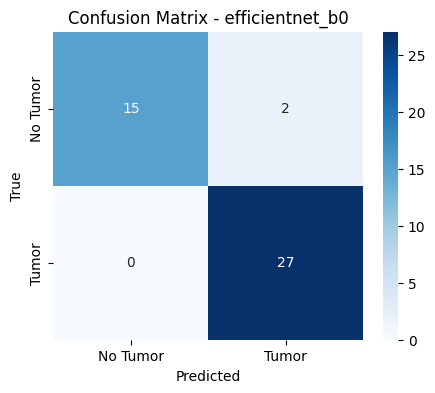

Saved confusion matrix: results/plots/confusion_matrix_efficientnet_b0.png
Classification report:
              precision    recall  f1-score   support

    No Tumor       1.00      0.88      0.94        17
       Tumor       0.93      1.00      0.96        27

    accuracy                           0.95        44
   macro avg       0.97      0.94      0.95        44
weighted avg       0.96      0.95      0.95        44


AUC-ROC Score: 0.9913



Saved error analysis: results/tables/error_analysis_efficientnet_b0.csv

Error Analysis Summary (first 10 rows):
    filename                                               path  true_label  \
0    N15.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
1   Y180.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
2   Y155.JPG  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
3     N3.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
4    Y99.JPG  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
5    N19.JPG  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
6    Y73.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
7    Y79.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
8  24 no.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
9    Y38.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   

   pred_label  pr

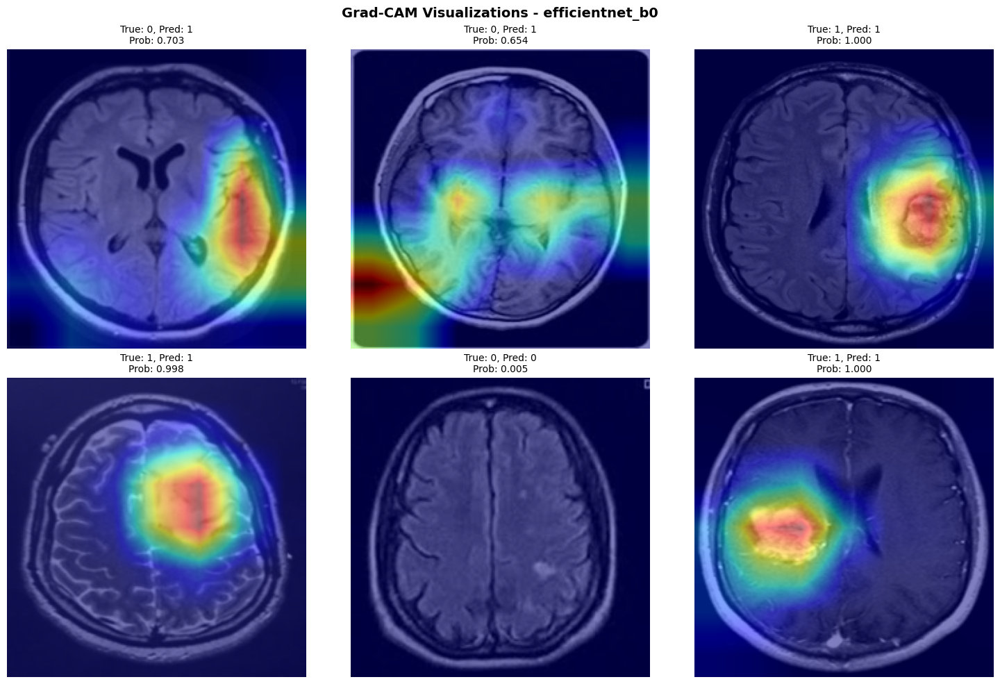

Saved Grad-CAM images (up to 6 samples)


[I 2025-10-01 06:32:29,101] A new study created in memory with name: no-name-0e4dc8c5-dcc3-464d-886f-0c231824cc3d



EFFICIENTNET_B0 Test Results:
Accuracy:  0.9545
Precision: 0.9310
Recall:    1.0000
AUC:       0.9913

Processing DENSENET121
Optimizing hyperparameters for densenet121...


Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 171MB/s]



Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6368
Val Loss: 0.6957, Accuracy: 0.5556, AUC: 0.3994, Precision: 0.6000, Recall: 0.8182
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.5439
Val Loss: 0.6638, Accuracy: 0.6111, AUC: 0.6818, Precision: 0.6818, Recall: 0.6818
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.4647
Val Loss: 0.6271, Accuracy: 0.6944, AUC: 0.7305, Precision: 0.7200, Recall: 0.8182
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.4847
Val Loss: 0.5886, Accuracy: 0.6944, AUC: 0.7792, Precision: 0.7200, Recall: 0.8182
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.3735
Val Loss: 0.5584, Accuracy: 0.7222, AUC: 0.7922, Precision: 0.7500, Recall: 0.8182
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.4113
Val Loss: 0.5362, Accuracy: 0.7222, AUC: 0.8052, Precision: 0.7500, Recall: 0.8182
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.3666
Val Loss: 0.5239, Accuracy: 0.7222, AUC: 0.8117, Precision: 0.7500, Recall: 0.8182
Saved new best model at epoch 7

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.4683
Val Loss: 0.5200, Accuracy: 0.7500, AUC: 0.8084, Precision: 0.7826, Recall: 0.8182
Saved new best model at epoch 8

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.3719
Val Loss: 0.5101, Accuracy: 0.7500, AUC: 0.8247, Precision: 0.7826, Recall: 0.8182
Saved new best model at epoch 9

Epoch 10/10


[I 2025-10-01 06:32:56,042] Trial 0 finished with value: 0.823051948051948 and parameters: {'lr': 6.530184251792857e-05, 'batch_size': 64, 'dropout_rate': 0.23929809329408608, 'weight_decay': 3.838935069689216e-06, 'optimizer': 'AdamW', 'scheduler': 'cosine'}. Best is trial 0 with value: 0.823051948051948.


Epoch 10 Summary:
Train Loss: 0.3455
Val Loss: 0.5063, Accuracy: 0.7778, AUC: 0.8279, Precision: 0.8182, Recall: 0.8182
Saved new best model at epoch 10

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.7290
Val Loss: 0.6350, Accuracy: 0.6111, AUC: 0.6981, Precision: 0.6111, Recall: 1.0000
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.6299
Val Loss: 0.5903, Accuracy: 0.6389, AUC: 0.8214, Precision: 0.6286, Recall: 1.0000
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.5720
Val Loss: 0.5561, Accuracy: 0.7222, AUC: 0.8312, Precision: 0.7000, Recall: 0.9545
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.5518
Val Loss: 0.5349, Accuracy: 0.7778, AUC: 0.8149, Precision: 0.7500, Recall: 0.9545
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.5481
Val Loss: 0.5214, Accuracy: 0.7778, AUC: 0.8279, Precision: 0.7500, Recall: 0.9545
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.4749
Val Loss: 0.5219, Accuracy: 0.7500, AUC: 0.8344, Precision: 0.7407, Recall: 0.9091
No improvement for 1 epoch(s)

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.5140
Val Loss: 0.5174, Accuracy: 0.7500, AUC: 0.8247, Precision: 0.7407, Recall: 0.9091
Saved new best model at epoch 7

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.4376
Val Loss: 0.5148, Accuracy: 0.7500, AUC: 0.8214, Precision: 0.7407, Recall: 0.9091
Saved new best model at epoch 8

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.4329
Val Loss: 0.5060, Accuracy: 0.7778, AUC: 0.8247, Precision: 0.7692, Recall: 0.9091
Saved new best model at epoch 9

Epoch 10/10


[I 2025-10-01 06:33:21,613] Trial 1 finished with value: 0.9172077922077921 and parameters: {'lr': 1.4485701842465887e-05, 'batch_size': 16, 'dropout_rate': 0.2799478585752687, 'weight_decay': 0.00034992251398313976, 'optimizer': 'Adam', 'scheduler': 'step'}. Best is trial 1 with value: 0.9172077922077921.


Epoch 10 Summary:
Train Loss: 0.4543
Val Loss: 0.5070, Accuracy: 0.7500, AUC: 0.8149, Precision: 0.7407, Recall: 0.9091
No improvement for 1 epoch(s)

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6051
Val Loss: 0.5617, Accuracy: 0.7500, AUC: 0.7500, Precision: 0.7241, Recall: 0.9545
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.3477
Val Loss: 1.2817, Accuracy: 0.6389, AUC: 0.7532, Precision: 0.6286, Recall: 1.0000
No improvement for 1 epoch(s)

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.4221
Val Loss: 1.2955, Accuracy: 0.6389, AUC: 0.7890, Precision: 0.6286, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 4/10


[I 2025-10-01 06:33:32,095] Trial 2 finished with value: 0.9058441558441559 and parameters: {'lr': 0.0007374871140350487, 'batch_size': 64, 'dropout_rate': 0.4161470674633596, 'weight_decay': 0.0032491667963428367, 'optimizer': 'Adam', 'scheduler': 'cosine'}. Best is trial 1 with value: 0.9172077922077921.


Epoch 4 Summary:
Train Loss: 0.2416
Val Loss: 1.1972, Accuracy: 0.6944, AUC: 0.8117, Precision: 0.6667, Recall: 1.0000
No improvement for 3 epoch(s)
Early stopping triggered at epoch 4

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6951
Val Loss: 0.6560, Accuracy: 0.6389, AUC: 0.7565, Precision: 0.6452, Recall: 0.9091
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.7423
Val Loss: 0.6474, Accuracy: 0.5833, AUC: 0.6818, Precision: 0.6061, Recall: 0.9091
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.7550
Val Loss: 0.6322, Accuracy: 0.6389, AUC: 0.7370, Precision: 0.6286, Recall: 1.0000
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.7474
Val Loss: 0.6249, Accuracy: 0.6389, AUC: 0.7695, Precision: 0.6364, Recall: 0.9545
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.7617
Val Loss: 0.6286, Accuracy: 0.6944, AUC: 0.7370, Precision: 0.6774, Recall: 0.9545
No improvement for 1 epoch(s)

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.7263
Val Loss: 0.6347, Accuracy: 0.6944, AUC: 0.7240, Precision: 0.6774, Recall: 0.9545
No improvement for 2 epoch(s)

Epoch 7/10


[I 2025-10-01 06:33:50,145] Trial 3 finished with value: 0.8847402597402598 and parameters: {'lr': 1.85053843423463e-05, 'batch_size': 64, 'dropout_rate': 0.040733816018173274, 'weight_decay': 3.880871338301797e-06, 'optimizer': 'SGD', 'scheduler': 'plateau'}. Best is trial 1 with value: 0.9172077922077921.


Epoch 7 Summary:
Train Loss: 0.7483
Val Loss: 0.6436, Accuracy: 0.6667, AUC: 0.6981, Precision: 0.6562, Recall: 0.9545
No improvement for 3 epoch(s)
Early stopping triggered at epoch 7

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6700
Val Loss: 0.6468, Accuracy: 0.6111, AUC: 0.5552, Precision: 0.6111, Recall: 1.0000
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.6472
Val Loss: 0.6175, Accuracy: 0.6667, AUC: 0.6656, Precision: 0.6562, Recall: 0.9545
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.5363
Val Loss: 0.5756, Accuracy: 0.7500, AUC: 0.7922, Precision: 0.7241, Recall: 0.9545
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.4524
Val Loss: 0.5604, Accuracy: 0.7500, AUC: 0.8279, Precision: 0.7097, Recall: 1.0000
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.4104
Val Loss: 0.5208, Accuracy: 0.7778, AUC: 0.8539, Precision: 0.7692, Recall: 0.9091
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.3746
Val Loss: 0.4965, Accuracy: 0.8056, AUC: 0.8766, Precision: 0.7778, Recall: 0.9545
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.3414
Val Loss: 0.5122, Accuracy: 0.8056, AUC: 0.8701, Precision: 0.7586, Recall: 1.0000
No improvement for 1 epoch(s)

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.2499
Val Loss: 0.4872, Accuracy: 0.7778, AUC: 0.8896, Precision: 0.7917, Recall: 0.8636
Saved new best model at epoch 8

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.2493
Val Loss: 0.4845, Accuracy: 0.7778, AUC: 0.8831, Precision: 0.8182, Recall: 0.8182
Saved new best model at epoch 9

Epoch 10/10


[I 2025-10-01 06:34:15,336] Trial 4 finished with value: 0.9448051948051948 and parameters: {'lr': 0.0006613830366462573, 'batch_size': 16, 'dropout_rate': 0.22433433087599847, 'weight_decay': 0.0019083548137958186, 'optimizer': 'SGD', 'scheduler': 'step'}. Best is trial 4 with value: 0.9448051948051948.


Epoch 10 Summary:
Train Loss: 0.3534
Val Loss: 0.4613, Accuracy: 0.7778, AUC: 0.8896, Precision: 0.8182, Recall: 0.8182
Saved new best model at epoch 10

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.7146
Val Loss: 0.7646, Accuracy: 0.3611, AUC: 0.5065, Precision: 0.0000, Recall: 0.0000
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.7241
Val Loss: 0.7352, Accuracy: 0.4444, AUC: 0.5032, Precision: 0.6667, Recall: 0.1818
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.6469
Val Loss: 0.7209, Accuracy: 0.4444, AUC: 0.5519, Precision: 0.6667, Recall: 0.1818
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.6588
Val Loss: 0.6957, Accuracy: 0.5833, AUC: 0.6266, Precision: 0.8182, Recall: 0.4091
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.6457
Val Loss: 0.6743, Accuracy: 0.6667, AUC: 0.6818, Precision: 0.8571, Recall: 0.5455
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.6452
Val Loss: 0.6656, Accuracy: 0.6667, AUC: 0.6818, Precision: 0.8571, Recall: 0.5455
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.6430
Val Loss: 0.6564, Accuracy: 0.6667, AUC: 0.7208, Precision: 0.8125, Recall: 0.5909
Saved new best model at epoch 7

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.6138
Val Loss: 0.6388, Accuracy: 0.6944, AUC: 0.7727, Precision: 0.7619, Recall: 0.7273
Saved new best model at epoch 8

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.6108
Val Loss: 0.6122, Accuracy: 0.8611, AUC: 0.8442, Precision: 0.8400, Recall: 0.9545
Saved new best model at epoch 9

Epoch 10/10


[I 2025-10-01 06:34:41,731] Trial 5 finished with value: 0.9107142857142857 and parameters: {'lr': 0.0001545728039046272, 'batch_size': 64, 'dropout_rate': 0.3263151742461108, 'weight_decay': 1.1963849410115576e-06, 'optimizer': 'SGD', 'scheduler': 'plateau'}. Best is trial 4 with value: 0.9448051948051948.


Epoch 10 Summary:
Train Loss: 0.5926
Val Loss: 0.5904, Accuracy: 0.8333, AUC: 0.8669, Precision: 0.8077, Recall: 0.9545
Saved new best model at epoch 10

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6086
Val Loss: 0.6236, Accuracy: 0.6111, AUC: 0.7597, Precision: 0.6176, Recall: 0.9545
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.4373
Val Loss: 0.6468, Accuracy: 0.6667, AUC: 0.7727, Precision: 0.6562, Recall: 0.9545
No improvement for 1 epoch(s)

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.3686
Val Loss: 0.8225, Accuracy: 0.6389, AUC: 0.7662, Precision: 0.6364, Recall: 0.9545
No improvement for 2 epoch(s)

Epoch 4/10


[I 2025-10-01 06:34:52,092] Trial 6 finished with value: 0.9188311688311688 and parameters: {'lr': 0.0003695244642124054, 'batch_size': 64, 'dropout_rate': 0.4651726629048866, 'weight_decay': 7.56989116098196e-06, 'optimizer': 'AdamW', 'scheduler': 'plateau'}. Best is trial 4 with value: 0.9448051948051948.


Epoch 4 Summary:
Train Loss: 0.2316
Val Loss: 0.8995, Accuracy: 0.6667, AUC: 0.8377, Precision: 0.6471, Recall: 1.0000
No improvement for 3 epoch(s)
Early stopping triggered at epoch 4

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.7023
Val Loss: 0.7516, Accuracy: 0.3333, AUC: 0.3604, Precision: 0.3750, Recall: 0.1364
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.6462
Val Loss: 0.7315, Accuracy: 0.3333, AUC: 0.3701, Precision: 0.4167, Recall: 0.2273
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.6106
Val Loss: 0.7100, Accuracy: 0.4444, AUC: 0.3701, Precision: 0.5455, Recall: 0.5455
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.5743
Val Loss: 0.6767, Accuracy: 0.6111, AUC: 0.5487, Precision: 0.6538, Recall: 0.7727
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.5852
Val Loss: 0.6410, Accuracy: 0.6389, AUC: 0.6786, Precision: 0.6552, Recall: 0.8636
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.5701
Val Loss: 0.6208, Accuracy: 0.6944, AUC: 0.7208, Precision: 0.6774, Recall: 0.9545
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.5892
Val Loss: 0.6006, Accuracy: 0.6667, AUC: 0.7727, Precision: 0.6562, Recall: 0.9545
Saved new best model at epoch 7

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.5628
Val Loss: 0.5887, Accuracy: 0.7222, AUC: 0.7857, Precision: 0.7000, Recall: 0.9545
Saved new best model at epoch 8

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.5082
Val Loss: 0.5793, Accuracy: 0.7222, AUC: 0.7922, Precision: 0.7000, Recall: 0.9545
Saved new best model at epoch 9

Epoch 10/10


[I 2025-10-01 06:35:18,673] Trial 7 finished with value: 0.8782467532467533 and parameters: {'lr': 2.1179624970668216e-05, 'batch_size': 64, 'dropout_rate': 0.4370190956831212, 'weight_decay': 0.0015964607279038623, 'optimizer': 'Adam', 'scheduler': 'cosine'}. Best is trial 4 with value: 0.9448051948051948.


Epoch 10 Summary:
Train Loss: 0.5368
Val Loss: 0.5717, Accuracy: 0.7222, AUC: 0.8019, Precision: 0.7000, Recall: 0.9545
Saved new best model at epoch 10

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.5211
Val Loss: 0.5620, Accuracy: 0.6389, AUC: 0.7630, Precision: 0.6552, Recall: 0.8636
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.3591
Val Loss: 1.3469, Accuracy: 0.6667, AUC: 0.8344, Precision: 0.6471, Recall: 1.0000
No improvement for 1 epoch(s)

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.2102
Val Loss: 2.4940, Accuracy: 0.6111, AUC: 0.8539, Precision: 0.6111, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 4/10


[I 2025-10-01 06:35:28,830] Trial 8 finished with value: 0.935064935064935 and parameters: {'lr': 0.000859445328734858, 'batch_size': 64, 'dropout_rate': 0.48948908357654597, 'weight_decay': 4.024041014911457e-05, 'optimizer': 'AdamW', 'scheduler': 'plateau'}. Best is trial 4 with value: 0.9448051948051948.


Epoch 4 Summary:
Train Loss: 0.2908
Val Loss: 2.1936, Accuracy: 0.6389, AUC: 0.8701, Precision: 0.6286, Recall: 1.0000
No improvement for 3 epoch(s)
Early stopping triggered at epoch 4

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.7139
Val Loss: 0.7727, Accuracy: 0.3611, AUC: 0.5422, Precision: 0.0000, Recall: 0.0000
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.6624
Val Loss: 0.7584, Accuracy: 0.3889, AUC: 0.6623, Precision: 0.0000, Recall: 0.0000
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.6208
Val Loss: 0.7137, Accuracy: 0.4167, AUC: 0.7240, Precision: 0.6667, Recall: 0.0909
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.5447
Val Loss: 0.6529, Accuracy: 0.5556, AUC: 0.7630, Precision: 0.8000, Recall: 0.3636
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.5629
Val Loss: 0.6024, Accuracy: 0.6389, AUC: 0.7435, Precision: 0.7143, Recall: 0.6818
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.5156
Val Loss: 0.5618, Accuracy: 0.7500, AUC: 0.7987, Precision: 0.7600, Recall: 0.8636
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.5315
Val Loss: 0.5739, Accuracy: 0.7778, AUC: 0.8052, Precision: 0.7917, Recall: 0.8636
No improvement for 1 epoch(s)

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.5019
Val Loss: 0.5787, Accuracy: 0.7222, AUC: 0.7987, Precision: 0.7500, Recall: 0.8182
No improvement for 2 epoch(s)

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.4964
Val Loss: 0.5533, Accuracy: 0.7500, AUC: 0.8279, Precision: 0.7600, Recall: 0.8636
Saved new best model at epoch 9

Epoch 10/10


[I 2025-10-01 06:35:53,411] Trial 9 finished with value: 0.8457792207792207 and parameters: {'lr': 1.3456396198988401e-05, 'batch_size': 16, 'dropout_rate': 0.38394645934117566, 'weight_decay': 3.6905822611724994e-05, 'optimizer': 'AdamW', 'scheduler': 'step'}. Best is trial 4 with value: 0.9448051948051948.


Epoch 10 Summary:
Train Loss: 0.4915
Val Loss: 0.5379, Accuracy: 0.7222, AUC: 0.8084, Precision: 0.7500, Recall: 0.8182
Saved new best model at epoch 10

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6878
Val Loss: 0.7803, Accuracy: 0.3889, AUC: 0.7727, Precision: 0.0000, Recall: 0.0000
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.6824
Val Loss: 0.7656, Accuracy: 0.5556, AUC: 0.7305, Precision: 0.8750, Recall: 0.3182
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.6716
Val Loss: 0.7507, Accuracy: 0.5556, AUC: 0.6136, Precision: 0.6875, Recall: 0.5000
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.6731
Val Loss: 0.7238, Accuracy: 0.5556, AUC: 0.5714, Precision: 0.6250, Recall: 0.6818
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.6463
Val Loss: 0.6910, Accuracy: 0.6111, AUC: 0.6494, Precision: 0.6176, Recall: 0.9545
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.6133
Val Loss: 0.6882, Accuracy: 0.6667, AUC: 0.7110, Precision: 0.6562, Recall: 0.9545
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.6078
Val Loss: 0.6807, Accuracy: 0.7222, AUC: 0.7305, Precision: 0.7308, Recall: 0.8636
Saved new best model at epoch 7

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.5810
Val Loss: 0.6708, Accuracy: 0.6944, AUC: 0.7045, Precision: 0.6897, Recall: 0.9091
Saved new best model at epoch 8

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.5804
Val Loss: 0.6540, Accuracy: 0.7222, AUC: 0.7370, Precision: 0.7143, Recall: 0.9091
Saved new best model at epoch 9

Epoch 10/10


[I 2025-10-01 06:36:19,473] Trial 10 finished with value: 0.8636363636363636 and parameters: {'lr': 0.00018814495211752914, 'batch_size': 32, 'dropout_rate': 0.15554335806755143, 'weight_decay': 0.008654330159503457, 'optimizer': 'SGD', 'scheduler': 'step'}. Best is trial 4 with value: 0.9448051948051948.


Epoch 10 Summary:
Train Loss: 0.5720
Val Loss: 0.6439, Accuracy: 0.6944, AUC: 0.7403, Precision: 0.7200, Recall: 0.8182
Saved new best model at epoch 10

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.7126
Val Loss: 0.7214, Accuracy: 0.3889, AUC: 0.5844, Precision: 0.5000, Recall: 0.1818
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.5758
Val Loss: 0.7082, Accuracy: 0.6111, AUC: 0.6656, Precision: 0.7500, Recall: 0.5455
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.4899
Val Loss: 0.5916, Accuracy: 0.6944, AUC: 0.8247, Precision: 0.7895, Recall: 0.6818
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.4344
Val Loss: 0.5548, Accuracy: 0.8056, AUC: 0.7987, Precision: 0.7778, Recall: 0.9545
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.4278
Val Loss: 0.5530, Accuracy: 0.8056, AUC: 0.8182, Precision: 0.7778, Recall: 0.9545
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.4535
Val Loss: 0.5183, Accuracy: 0.7500, AUC: 0.8669, Precision: 0.7407, Recall: 0.9091
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.3434
Val Loss: 0.5101, Accuracy: 0.7778, AUC: 0.8766, Precision: 0.7917, Recall: 0.8636
Saved new best model at epoch 7

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.2864
Val Loss: 0.5187, Accuracy: 0.7778, AUC: 0.8734, Precision: 0.7917, Recall: 0.8636
No improvement for 1 epoch(s)

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.2780
Val Loss: 0.4698, Accuracy: 0.8056, AUC: 0.9058, Precision: 0.8000, Recall: 0.9091
Saved new best model at epoch 9

Epoch 10/10


[I 2025-10-01 06:36:44,809] Trial 11 finished with value: 0.9301948051948052 and parameters: {'lr': 0.0009495410050212571, 'batch_size': 16, 'dropout_rate': 0.19242802341887028, 'weight_decay': 0.0001409714557806174, 'optimizer': 'SGD', 'scheduler': 'step'}. Best is trial 4 with value: 0.9448051948051948.


Epoch 10 Summary:
Train Loss: 0.2634
Val Loss: 0.5096, Accuracy: 0.7500, AUC: 0.9026, Precision: 0.7407, Recall: 0.9091
No improvement for 1 epoch(s)

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.5128
Val Loss: 0.5907, Accuracy: 0.6944, AUC: 0.9221, Precision: 0.6667, Recall: 1.0000
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.2809
Val Loss: 0.9204, Accuracy: 0.7222, AUC: 0.7955, Precision: 0.7000, Recall: 0.9545
No improvement for 1 epoch(s)

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.1909
Val Loss: 1.3973, Accuracy: 0.6389, AUC: 0.7955, Precision: 0.6286, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 4/10


[I 2025-10-01 06:36:55,359] Trial 12 finished with value: 0.961038961038961 and parameters: {'lr': 0.0004067720017867115, 'batch_size': 32, 'dropout_rate': 0.09040885942931726, 'weight_decay': 3.381981868746812e-05, 'optimizer': 'AdamW', 'scheduler': 'plateau'}. Best is trial 12 with value: 0.961038961038961.


Epoch 4 Summary:
Train Loss: 0.1505
Val Loss: 1.6650, Accuracy: 0.7778, AUC: 0.8766, Precision: 0.7333, Recall: 1.0000
No improvement for 3 epoch(s)
Early stopping triggered at epoch 4

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.5760
Val Loss: 0.5751, Accuracy: 0.8333, AUC: 0.8279, Precision: 0.8077, Recall: 0.9545
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.4229
Val Loss: 0.8415, Accuracy: 0.6944, AUC: 0.8506, Precision: 0.6667, Recall: 1.0000
No improvement for 1 epoch(s)

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.2693
Val Loss: 1.4926, Accuracy: 0.6111, AUC: 0.8409, Precision: 0.6111, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 4/10


[I 2025-10-01 06:37:05,905] Trial 13 finished with value: 0.9253246753246753 and parameters: {'lr': 0.00041151111982890286, 'batch_size': 32, 'dropout_rate': 0.06914823976872313, 'weight_decay': 0.0005857381979203505, 'optimizer': 'AdamW', 'scheduler': 'plateau'}. Best is trial 12 with value: 0.961038961038961.


Epoch 4 Summary:
Train Loss: 0.2798
Val Loss: 1.6847, Accuracy: 0.6389, AUC: 0.8344, Precision: 0.6364, Recall: 0.9545
No improvement for 3 epoch(s)
Early stopping triggered at epoch 4

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.7104
Val Loss: 0.6109, Accuracy: 0.6111, AUC: 0.6981, Precision: 0.6111, Recall: 1.0000
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.6406
Val Loss: 0.6238, Accuracy: 0.6389, AUC: 0.7273, Precision: 0.6364, Recall: 0.9545
No improvement for 1 epoch(s)

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.6314
Val Loss: 0.6158, Accuracy: 0.6667, AUC: 0.7045, Precision: 0.6667, Recall: 0.9091
No improvement for 2 epoch(s)

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.6131
Val Loss: 0.5952, Accuracy: 0.6389, AUC: 0.7175, Precision: 0.6552, Recall: 0.8636
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.5432
Val Loss: 0.6422, Accuracy: 0.7222, AUC: 0.7792, Precision: 0.8000, Recall: 0.7273
No improvement for 1 epoch(s)

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.5177
Val Loss: 0.6467, Accuracy: 0.6944, AUC: 0.7760, Precision: 0.7619, Recall: 0.7273
No improvement for 2 epoch(s)

Epoch 7/10


[I 2025-10-01 06:37:23,964] Trial 14 finished with value: 0.9025974025974026 and parameters: {'lr': 0.000427465071197716, 'batch_size': 32, 'dropout_rate': 0.12558675095906985, 'weight_decay': 3.331820809700548e-05, 'optimizer': 'SGD', 'scheduler': 'step'}. Best is trial 12 with value: 0.961038961038961.


Epoch 7 Summary:
Train Loss: 0.5426
Val Loss: 0.6032, Accuracy: 0.6944, AUC: 0.8052, Precision: 0.7619, Recall: 0.7273
No improvement for 3 epoch(s)
Early stopping triggered at epoch 7

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.5952
Val Loss: 0.6525, Accuracy: 0.6389, AUC: 0.5909, Precision: 0.6957, Recall: 0.7273
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.5001
Val Loss: 0.6008, Accuracy: 0.7500, AUC: 0.8052, Precision: 0.7600, Recall: 0.8636
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.4458
Val Loss: 0.5884, Accuracy: 0.8056, AUC: 0.8604, Precision: 0.7778, Recall: 0.9545
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.3426
Val Loss: 0.5897, Accuracy: 0.7778, AUC: 0.8636, Precision: 0.7500, Recall: 0.9545
No improvement for 1 epoch(s)

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.3730
Val Loss: 0.6328, Accuracy: 0.7778, AUC: 0.8994, Precision: 0.7333, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 6/10


[I 2025-10-01 06:37:39,657] Trial 15 finished with value: 0.9626623376623377 and parameters: {'lr': 5.98445701649989e-05, 'batch_size': 32, 'dropout_rate': 0.08675715113271967, 'weight_decay': 0.0001538129782091453, 'optimizer': 'AdamW', 'scheduler': 'plateau'}. Best is trial 15 with value: 0.9626623376623377.


Epoch 6 Summary:
Train Loss: 0.2270
Val Loss: 0.6159, Accuracy: 0.7778, AUC: 0.9253, Precision: 0.7333, Recall: 1.0000
No improvement for 3 epoch(s)
Early stopping triggered at epoch 6

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6061
Val Loss: 0.7046, Accuracy: 0.4722, AUC: 0.6591, Precision: 0.7143, Recall: 0.2273
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.4565
Val Loss: 0.5982, Accuracy: 0.7222, AUC: 0.7500, Precision: 0.7143, Recall: 0.9091
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.4067
Val Loss: 0.5756, Accuracy: 0.6667, AUC: 0.8344, Precision: 0.6562, Recall: 0.9545
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.3393
Val Loss: 0.6001, Accuracy: 0.6667, AUC: 0.8896, Precision: 0.6562, Recall: 0.9545
No improvement for 1 epoch(s)

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.2793
Val Loss: 0.6806, Accuracy: 0.6667, AUC: 0.9058, Precision: 0.6471, Recall: 1.0000
No improvement for 2 epoch(s)

Epoch 6/10


[I 2025-10-01 06:37:55,274] Trial 16 finished with value: 0.9594155844155845 and parameters: {'lr': 5.318023422878837e-05, 'batch_size': 32, 'dropout_rate': 0.005540608710053602, 'weight_decay': 0.0001363283365809493, 'optimizer': 'AdamW', 'scheduler': 'plateau'}. Best is trial 15 with value: 0.9626623376623377.


Epoch 6 Summary:
Train Loss: 0.2342
Val Loss: 0.7480, Accuracy: 0.6667, AUC: 0.9188, Precision: 0.6471, Recall: 1.0000
No improvement for 3 epoch(s)
Early stopping triggered at epoch 6

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6371
Val Loss: 0.6571, Accuracy: 0.6389, AUC: 0.6818, Precision: 0.6452, Recall: 0.9091
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.5458
Val Loss: 0.6128, Accuracy: 0.7500, AUC: 0.8247, Precision: 0.7097, Recall: 1.0000
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.4736
Val Loss: 0.5778, Accuracy: 0.8056, AUC: 0.8669, Precision: 0.7586, Recall: 1.0000
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.4015
Val Loss: 0.5481, Accuracy: 0.7778, AUC: 0.9026, Precision: 0.7333, Recall: 1.0000
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.3905
Val Loss: 0.5439, Accuracy: 0.7778, AUC: 0.9123, Precision: 0.7333, Recall: 1.0000
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.3694
Val Loss: 0.5413, Accuracy: 0.8056, AUC: 0.9058, Precision: 0.7778, Recall: 0.9545
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.3391
Val Loss: 0.5210, Accuracy: 0.8333, AUC: 0.9156, Precision: 0.8077, Recall: 0.9545
Saved new best model at epoch 7

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.3081
Val Loss: 0.5037, Accuracy: 0.8333, AUC: 0.9253, Precision: 0.8077, Recall: 0.9545
Saved new best model at epoch 8

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.3321
Val Loss: 0.4920, Accuracy: 0.8333, AUC: 0.9351, Precision: 0.8077, Recall: 0.9545
Saved new best model at epoch 9

Epoch 10/10


[I 2025-10-01 06:38:21,862] Trial 17 finished with value: 0.9675324675324675 and parameters: {'lr': 3.68045825544365e-05, 'batch_size': 32, 'dropout_rate': 0.10004589119781208, 'weight_decay': 1.3892351610415303e-05, 'optimizer': 'AdamW', 'scheduler': 'plateau'}. Best is trial 17 with value: 0.9675324675324675.


Epoch 10 Summary:
Train Loss: 0.2931
Val Loss: 0.4726, Accuracy: 0.8056, AUC: 0.9286, Precision: 0.8000, Recall: 0.9091
Saved new best model at epoch 10

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.6516
Val Loss: 0.6481, Accuracy: 0.6667, AUC: 0.6234, Precision: 0.6786, Recall: 0.8636
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.5286
Val Loss: 0.5868, Accuracy: 0.7222, AUC: 0.8117, Precision: 0.7000, Recall: 0.9545
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.5744
Val Loss: 0.5607, Accuracy: 0.7778, AUC: 0.8019, Precision: 0.7500, Recall: 0.9545
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.4517
Val Loss: 0.5458, Accuracy: 0.7500, AUC: 0.8149, Precision: 0.7241, Recall: 0.9545
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.3804
Val Loss: 0.5273, Accuracy: 0.7778, AUC: 0.8214, Precision: 0.7500, Recall: 0.9545
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.3751
Val Loss: 0.5184, Accuracy: 0.7778, AUC: 0.8377, Precision: 0.7500, Recall: 0.9545
Saved new best model at epoch 6

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.3352
Val Loss: 0.5113, Accuracy: 0.8056, AUC: 0.8571, Precision: 0.7778, Recall: 0.9545
Saved new best model at epoch 7

Epoch 8/10


Epoch 8 Summary:
Train Loss: 0.3266
Val Loss: 0.4917, Accuracy: 0.8056, AUC: 0.8506, Precision: 0.7778, Recall: 0.9545
Saved new best model at epoch 8

Epoch 9/10


Epoch 9 Summary:
Train Loss: 0.2800
Val Loss: 0.4827, Accuracy: 0.8056, AUC: 0.8539, Precision: 0.7778, Recall: 0.9545
Saved new best model at epoch 9

Epoch 10/10


[I 2025-10-01 06:38:47,940] Trial 18 finished with value: 0.9058441558441559 and parameters: {'lr': 3.1078347939711964e-05, 'batch_size': 32, 'dropout_rate': 0.14234683128526698, 'weight_decay': 1.0171003608450879e-05, 'optimizer': 'AdamW', 'scheduler': 'plateau'}. Best is trial 17 with value: 0.9675324675324675.


Epoch 10 Summary:
Train Loss: 0.2855
Val Loss: 0.4557, Accuracy: 0.8056, AUC: 0.8474, Precision: 0.7778, Recall: 0.9545
Saved new best model at epoch 10

Epoch 1/10


Epoch 1 Summary:
Train Loss: 0.5949
Val Loss: 0.6821, Accuracy: 0.5278, AUC: 0.7240, Precision: 0.7778, Recall: 0.3182
Saved new best model at epoch 1

Epoch 2/10


Epoch 2 Summary:
Train Loss: 0.5035
Val Loss: 0.6506, Accuracy: 0.7778, AUC: 0.8442, Precision: 0.8500, Recall: 0.7727
Saved new best model at epoch 2

Epoch 3/10


Epoch 3 Summary:
Train Loss: 0.4056
Val Loss: 0.5869, Accuracy: 0.8333, AUC: 0.8636, Precision: 0.8636, Recall: 0.8636
Saved new best model at epoch 3

Epoch 4/10


Epoch 4 Summary:
Train Loss: 0.3205
Val Loss: 0.5472, Accuracy: 0.8056, AUC: 0.8701, Precision: 0.8000, Recall: 0.9091
Saved new best model at epoch 4

Epoch 5/10


Epoch 5 Summary:
Train Loss: 0.3109
Val Loss: 0.5306, Accuracy: 0.8056, AUC: 0.8766, Precision: 0.8000, Recall: 0.9091
Saved new best model at epoch 5

Epoch 6/10


Epoch 6 Summary:
Train Loss: 0.2865
Val Loss: 0.5319, Accuracy: 0.8333, AUC: 0.8896, Precision: 0.8077, Recall: 0.9545
No improvement for 1 epoch(s)

Epoch 7/10


Epoch 7 Summary:
Train Loss: 0.2307
Val Loss: 0.5794, Accuracy: 0.8056, AUC: 0.8799, Precision: 0.7778, Recall: 0.9545
No improvement for 2 epoch(s)

Epoch 8/10


[I 2025-10-01 06:39:08,794] Trial 19 finished with value: 0.922077922077922 and parameters: {'lr': 4.366304859808611e-05, 'batch_size': 32, 'dropout_rate': 0.00827069629016769, 'weight_decay': 0.0003949933688020688, 'optimizer': 'AdamW', 'scheduler': 'plateau'}. Best is trial 17 with value: 0.9675324675324675.


Epoch 8 Summary:
Train Loss: 0.1865
Val Loss: 0.6282, Accuracy: 0.8056, AUC: 0.8734, Precision: 0.7778, Recall: 0.9545
No improvement for 3 epoch(s)
Early stopping triggered at epoch 8
Best parameters for densenet121:
{'lr': 3.68045825544365e-05, 'batch_size': 32, 'dropout_rate': 0.10004589119781208, 'weight_decay': 1.3892351610415303e-05, 'optimizer': 'AdamW', 'scheduler': 'plateau'}
Training final densenet121 model with best parameters...

Epoch 1/20


Epoch 1 Summary:
Train Loss: 0.7360
Val Loss: 0.6431, Accuracy: 0.6111, AUC: 0.6071, Precision: 0.6111, Recall: 1.0000
Saved new best model at epoch 1

Epoch 2/20


Epoch 2 Summary:
Train Loss: 0.7257
Val Loss: 0.6233, Accuracy: 0.6111, AUC: 0.7403, Precision: 0.6111, Recall: 1.0000
Saved new best model at epoch 2

Epoch 3/20


Epoch 3 Summary:
Train Loss: 0.5173
Val Loss: 0.5729, Accuracy: 0.6111, AUC: 0.8377, Precision: 0.6111, Recall: 1.0000
Saved new best model at epoch 3

Epoch 4/20


Epoch 4 Summary:
Train Loss: 0.4378
Val Loss: 0.5296, Accuracy: 0.7500, AUC: 0.8377, Precision: 0.7097, Recall: 1.0000
Saved new best model at epoch 4

Epoch 5/20


Epoch 5 Summary:
Train Loss: 0.4286
Val Loss: 0.5037, Accuracy: 0.7222, AUC: 0.8279, Precision: 0.7143, Recall: 0.9091
Saved new best model at epoch 5

Epoch 6/20


Epoch 6 Summary:
Train Loss: 0.3327
Val Loss: 0.5000, Accuracy: 0.6389, AUC: 0.8182, Precision: 0.6800, Recall: 0.7727
Saved new best model at epoch 6

Epoch 7/20


Epoch 7 Summary:
Train Loss: 0.3514
Val Loss: 0.4837, Accuracy: 0.6667, AUC: 0.8214, Precision: 0.7083, Recall: 0.7727
Saved new best model at epoch 7

Epoch 8/20


Epoch 8 Summary:
Train Loss: 0.2240
Val Loss: 0.4645, Accuracy: 0.6944, AUC: 0.8409, Precision: 0.7391, Recall: 0.7727
Saved new best model at epoch 8

Epoch 9/20


Epoch 9 Summary:
Train Loss: 0.3537
Val Loss: 0.4837, Accuracy: 0.7500, AUC: 0.8604, Precision: 0.7407, Recall: 0.9091
No improvement for 1 epoch(s)

Epoch 10/20


Epoch 10 Summary:
Train Loss: 0.2458
Val Loss: 0.4962, Accuracy: 0.7500, AUC: 0.8442, Precision: 0.7407, Recall: 0.9091
No improvement for 2 epoch(s)

Epoch 11/20


Epoch 11 Summary:
Train Loss: 0.1787
Val Loss: 0.5206, Accuracy: 0.7500, AUC: 0.8377, Precision: 0.7407, Recall: 0.9091
No improvement for 3 epoch(s)

Epoch 12/20


Epoch 12 Summary:
Train Loss: 0.1835
Val Loss: 0.5460, Accuracy: 0.7222, AUC: 0.8377, Precision: 0.7308, Recall: 0.8636
No improvement for 4 epoch(s)

Epoch 13/20


Epoch 13 Summary:
Train Loss: 0.1894
Val Loss: 0.5596, Accuracy: 0.7500, AUC: 0.8409, Precision: 0.7407, Recall: 0.9091
No improvement for 5 epoch(s)
Early stopping triggered at epoch 13
Evaluating densenet121 on test set...

Evaluating densenet121...


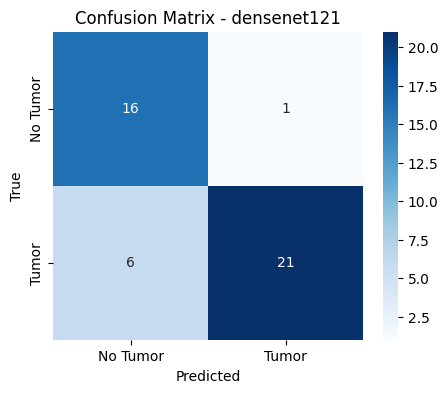

Saved confusion matrix: results/plots/confusion_matrix_densenet121.png
Classification report:
              precision    recall  f1-score   support

    No Tumor       0.73      0.94      0.82        17
       Tumor       0.95      0.78      0.86        27

    accuracy                           0.84        44
   macro avg       0.84      0.86      0.84        44
weighted avg       0.87      0.84      0.84        44


AUC-ROC Score: 0.8954



Saved error analysis: results/tables/error_analysis_densenet121.csv

Error Analysis Summary (first 10 rows):
    filename                                               path  true_label  \
0    N15.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
1   Y180.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
2   Y155.JPG  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
3     N3.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
4    Y99.JPG  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
5    N19.JPG  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
6    Y73.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
7    Y79.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   
8  24 no.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           0   
9    Y38.jpg  /kaggle/input/brain-mri-images-for-brain-tumor...           1   

   pred_label  probab

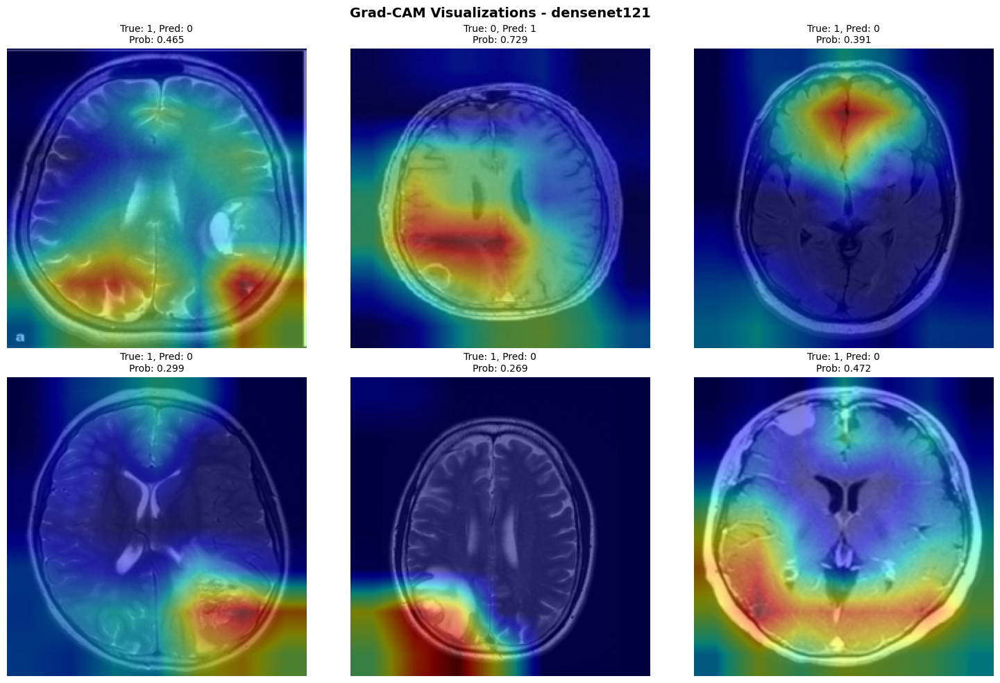

Saved Grad-CAM images (up to 6 samples)

DENSENET121 Test Results:
Accuracy:  0.8409
Precision: 0.9545
Recall:    0.7778
AUC:       0.8954

Saved combined ROC curves: results/plots/roc_curves_combined.png

FINAL COMPARISON
             Model  Accuracy  Precision    Recall       AUC  \
0         resnet50  0.840909   0.857143  0.888889  0.882353   
1  efficientnet_b0  0.954545   0.931034  1.000000  0.991285   
2      densenet121  0.840909   0.954545  0.777778  0.895425   

                                         Best_Params  
0  {'lr': 7.37632382713534e-05, 'batch_size': 32,...  
1  {'lr': 0.0006778142722953375, 'batch_size': 16...  
2  {'lr': 3.68045825544365e-05, 'batch_size': 32,...  

All results saved!
Optuna trials: results/tables/all_optuna_trials.csv
Final comparison: results/tables/model_comparison.csv

Additional outputs per model:
- Confusion matrices: results/plots/confusion_matrix_*.png
- Classification reports: results/tables/classification_report_*.txt
- Error analysis: r

In [120]:
results = run_pipeline(
    df=df, 
    architectures=['resnet50', 'efficientnet_b0', 'densenet121'], 
    n_trials=20
)

# STEP 10: Advanced Explainability Analysis

MODEL BUILDING

In [75]:
def build_model(arch, dropout_rate=0.0):
    """Build model with specified architecture"""
    if arch == 'resnet50':
        model = models.resnet50(weights='IMAGENET1K_V1')
        model.conv1 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)
        in_features = model.fc.in_features
        model.fc = nn.Sequential(
            nn.Dropout(dropout_rate),
            nn.Linear(in_features, 1)
        )
    elif arch == 'efficientnet_b0':
        model = models.efficientnet_b0(weights='IMAGENET1K_V1')
        model.features[0][0] = nn.Conv2d(1, 32, kernel_size=3, stride=2, padding=1, bias=False)
        in_features = model.classifier[1].in_features
        model.classifier[1] = nn.Sequential(
            nn.Dropout(p=dropout_rate),
            nn.Linear(in_features, 1)
        )
    elif arch == 'densenet121':
        model = models.densenet121(weights='IMAGENET1K_V1')
        model.features.conv0 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)
        in_features = model.classifier.in_features
        model.classifier = nn.Sequential(
            nn.Dropout(dropout_rate),
            nn.Linear(in_features, 1)
        )
    else:
        raise ValueError("Unsupported architecture")
    
    return model


INTEGRATED GRADIENTS

In [76]:
def integrated_gradients(model, input_tensor, baseline=None, steps=50, device='cuda'):
    """
    Compute Integrated Gradients attribution
    
    Args:
        model: PyTorch model
        input_tensor: Input image tensor (1, C, H, W)
        baseline: Baseline tensor (default: zeros)
        steps: Number of integration steps
        device: Device to run on
    
    Returns:
        attributions: Attribution map (C, H, W)
    """
    model.eval()
    
    if baseline is None:
        baseline = torch.zeros_like(input_tensor)
    
    # Generate interpolated inputs between baseline and input
    alphas = torch.linspace(0, 1, steps).to(device)
    
    # Compute gradients at each interpolated input
    gradients = []
    
    for alpha in alphas:
        # Interpolate
        interpolated = baseline + alpha * (input_tensor - baseline)
        interpolated.requires_grad = True
        
        # Forward pass
        output = model(interpolated)
        
        # Get prediction score
        if output.numel() == 1:
            score = output.squeeze()
        else:
            score = torch.sigmoid(output).squeeze()
        
        # Backward pass
        model.zero_grad()
        score.backward()
        
        # Store gradients
        gradients.append(interpolated.grad.detach())
    
    # Average gradients and multiply by (input - baseline)
    avg_gradients = torch.stack(gradients).mean(dim=0)
    integrated_grads = (input_tensor - baseline) * avg_gradients
    
    return integrated_grads.squeeze().cpu().numpy()

In [77]:
def visualize_integrated_gradients(ig_attributions, original_image, percentile=99):
    """
    Visualize Integrated Gradients attributions
    
    Args:
        ig_attributions: Attribution array (C, H, W) or (H, W)
        original_image: PIL Image
        percentile: Percentile for attribution clipping
    
    Returns:
        overlay: RGB overlay image
    """
    # Handle single channel
    if ig_attributions.ndim == 3:
        ig_attributions = ig_attributions[0]  # Take first channel
    
    # Normalize attributions
    attribution_abs = np.abs(ig_attributions)
    vmax = np.percentile(attribution_abs, percentile)
    attribution_norm = np.clip(attribution_abs / (vmax + 1e-10), 0, 1)
    
    # Resize original image
    img_array = np.array(original_image.resize((224, 224)))
    if img_array.ndim == 2:
        img_array = np.stack([img_array]*3, axis=-1)
    
    # Create heatmap
    cmap = plt.get_cmap('jet')
    heatmap = cmap(attribution_norm)[:,:,:3] * 255
    
    # Overlay
    overlay = 0.6 * img_array + 0.4 * heatmap
    overlay = np.clip(overlay, 0, 255).astype(np.uint8)
    
    return overlay

GRAD-CAM++

In [78]:
def _get_last_conv_module(model, model_name):
    """Identify last convolutional layer"""
    name = model_name.lower()
    
    if 'resnet' in name:
        return getattr(model, 'layer4', None)
    
    if 'densenet' in name:
        feats = getattr(model, 'features', None)
        for m in reversed(list(feats.named_modules())):
            if isinstance(m[1], torch.nn.Conv2d):
                return m[1]
        return feats
    
    if 'efficientnet' in name:
        feats = getattr(model, 'features', None)
        last = None
        for n, ch in feats.named_children():
            last = ch
        return last
    
    # Fallback
    last_conv = None
    for n, m in model.named_modules():
        if isinstance(m, torch.nn.Conv2d):
            last_conv = m
    return last_conv


In [79]:
def gradcam_plusplus(model, model_name, input_tensor, device='cuda'):
    """
    Compute Grad-CAM++ attribution
    
    Args:
        model: PyTorch model
        model_name: Model architecture name
        input_tensor: Input image tensor (1, C, H, W)
        device: Device to run on
    
    Returns:
        heatmap: Attribution heatmap (H, W)
    """
    model.eval()
    
    # Find target layer
    target_layer = _get_last_conv_module(model, model_name)
    if target_layer is None:
        raise RuntimeError("Could not identify last conv layer")
    
    activations = {}
    gradients = {}
    
    def forward_hook(module, input, output):
        activations['value'] = output.detach()
    
    def backward_hook(module, grad_in, grad_out):
        gradients['value'] = grad_out[0].detach()
    
    fh = target_layer.register_forward_hook(forward_hook)
    bh = target_layer.register_full_backward_hook(backward_hook)
    
    # Forward pass
    model.zero_grad()
    output = model(input_tensor)
    
    if output.numel() == 1:
        score = output.squeeze()
    else:
        score = torch.sigmoid(output).squeeze()
    
    # Backward pass
    score.backward()
    
    # Get activations and gradients
    A = activations['value']  # (1, C, H, W)
    grad = gradients['value']  # (1, C, H, W)
    
    # Compute Grad-CAM++ weights
    grad_2 = grad.pow(2)
    grad_3 = grad.pow(3)
    
    # Alpha weights (Grad-CAM++ specific)
    alpha_num = grad_2
    alpha_denom = 2 * grad_2 + (grad_3 * A).sum(dim=(2, 3), keepdim=True)
    alpha_denom = torch.where(alpha_denom != 0, alpha_denom, torch.ones_like(alpha_denom))
    alpha = alpha_num / alpha_denom
    
    # Weights with ReLU
    weights = (alpha * F.relu(grad)).sum(dim=(2, 3), keepdim=True)
    
    # Weighted combination
    gcam = (weights * A).sum(dim=1, keepdim=True)
    gcam = F.relu(gcam)
    
    # Upsample to input size
    gcam = F.interpolate(gcam, size=(224, 224), mode='bilinear', align_corners=False)
    gcam = gcam.squeeze().cpu().numpy()
    
    # Normalize
    gcam = gcam - gcam.min()
    if gcam.max() > 0:
        gcam = gcam / gcam.max()
    
    # Remove hooks
    fh.remove()
    bh.remove()
    
    return gcam

In [85]:
def overlay_heatmap_on_image(pil_img, heatmap, alpha=0.5, cmap='jet'):
    """Overlay heatmap on original image"""
    img = np.array(pil_img.resize((224, 224)))
    if img.ndim == 2:
        base = np.stack([img]*3, axis=-1)
    else:
        base = img
    
    cmap_ = plt.get_cmap(cmap)
    hm = cmap_(heatmap)[:,:,:3] * 255.0
    overlay = (1-alpha) * base.astype(float) + alpha * hm.astype(float)
    overlay = np.clip(overlay, 0, 255).astype(np.uint8)
    return overlay


COMPREHENSIVE ANALYSIS FUNCTION

In [81]:
def analyze_model_with_advanced_methods(
    model_path,
    architecture,
    test_df,
    num_samples=6,
    methods=['integrated_gradients', 'gradcam++'],
    device='cuda'
):
    """
    Analyze saved model with Integrated Gradients and Grad-CAM++
    
    Args:
        model_path: Path to saved .pth file
        architecture: Model architecture name
        test_df: Test dataframe with 'path' and 'label' columns
        num_samples: Number of samples to visualize
        methods: List of methods to apply
        device: Device to run on
    
    Returns:
        results: Dictionary with analysis results
    """
    device = torch.device(device if torch.cuda.is_available() else 'cpu')
    
    print(f"\n{'='*60}")
    print(f"Analyzing {architecture} with advanced explainability methods")
    print(f"{'='*60}")
    
    # Load model
    model = build_model(architecture, dropout_rate=0.0)
    model.load_state_dict(torch.load(model_path, map_location=device))
    model.to(device)
    model.eval()
    
    print(f"Loaded model from {model_path}")
    
    # Prepare transform
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485], std=[0.229])
    ])
    
    # Get predictions and select samples
    print("Selecting samples for analysis...")
    sample_data = []
    
    for idx, row in test_df.iterrows():
        img_path = row['path']
        true_label = int(row['label'])
        
        pil_img = Image.open(img_path).convert("L")
        input_tensor = transform(pil_img).unsqueeze(0).to(device)
        
        with torch.no_grad():
            output = model(input_tensor)
            prob = torch.sigmoid(output).item()
            pred = 1 if prob >= 0.5 else 0
        
        sample_data.append({
            'path': img_path,
            'true_label': true_label,
            'pred_label': pred,
            'probability': prob,
            'correct': true_label == pred
        })
    
    sample_df = pd.DataFrame(sample_data)
    
    # Select diverse samples: some correct, some incorrect
    incorrect = sample_df[~sample_df['correct']].head(num_samples // 2)
    correct = sample_df[sample_df['correct']].sample(min(len(sample_df[sample_df['correct']]), 
                                                         num_samples - len(incorrect)), 
                                                     random_state=42)
    selected_samples = pd.concat([incorrect, correct]).head(num_samples)
    
    print(f"Selected {len(selected_samples)} samples for visualization")
    
    # Create output directory
    os.makedirs(f"results/advanced_explainability/{architecture}", exist_ok=True)
    
    # Analyze each sample
    for method in methods:
        print(f"\nGenerating {method} visualizations...")
        
        num_cols = 3
        num_rows = (len(selected_samples) + num_cols - 1) // num_cols
        fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))
        axes = axes.flatten() if num_rows > 1 else [axes] if num_cols == 1 else axes
        
        for idx, (_, sample) in enumerate(selected_samples.iterrows()):
            img_path = sample['path']
            true_lbl = sample['true_label']
            pred_lbl = sample['pred_label']
            prob = sample['probability']
            
            pil_img = Image.open(img_path).convert("L")
            input_tensor = transform(pil_img).unsqueeze(0).to(device)
            
            try:
                if method == 'integrated_gradients':
                    attributions = integrated_gradients(model, input_tensor, steps=50, device=device)
                    overlay = visualize_integrated_gradients(attributions, pil_img)
                elif method == 'gradcam++':
                    heatmap = gradcam_plusplus(model, architecture, input_tensor, device=device)
                    overlay = overlay_heatmap_on_image(pil_img, heatmap)
                
                # Save individual image
                save_path = f"results/advanced_explainability/{architecture}/{method}_{idx}_t{true_lbl}_p{pred_lbl}_{os.path.basename(img_path)}"
                plt.imsave(save_path, overlay)
                
                # Display in subplot
                axes[idx].imshow(overlay)
                axes[idx].axis('off')
                status = "✓" if true_lbl == pred_lbl else "✗"
                axes[idx].set_title(f"{status} True: {true_lbl}, Pred: {pred_lbl}\nProb: {prob:.3f}", 
                                   fontsize=10)
            
            except Exception as e:
                print(f"Failed for {img_path}: {e}")
                axes[idx].axis('off')
        
        # Hide unused subplots
        for idx in range(len(selected_samples), len(axes)):
            axes[idx].axis('off')
        
        method_title = method.replace('_', ' ').title()
        plt.suptitle(f"{method_title} - {architecture}", fontsize=14, fontweight='bold')
        plt.tight_layout()
        plt.savefig(f"results/advanced_explainability/{architecture}/{method}_combined.png", 
                   dpi=150, bbox_inches='tight')
        plt.show()
        plt.close()
    
    print(f"\nAnalysis complete for {architecture}!")
    print(f"Results saved to: results/advanced_explainability/{architecture}/")
    
    return {
        'model': architecture,
        'samples_analyzed': len(selected_samples),
        'methods': methods
    }


BATCH ANALYSIS FOR ALL MODELS

In [82]:
def analyze_all_models(model_configs, test_df, num_samples=6, device='cuda'):
    """
    Analyze all saved models with advanced explainability methods
    
    Args:
        model_configs: List of dicts with 'path' and 'arch' keys
        test_df: Test dataframe
        num_samples: Number of samples per model
        device: Device to run on
    
    Returns:
        all_results: List of analysis results
    """
    all_results = []
    
    for config in model_configs:
        result = analyze_model_with_advanced_methods(
            model_path=config['path'],
            architecture=config['arch'],
            test_df=test_df,
            num_samples=num_samples,
            methods=['integrated_gradients', 'gradcam++'],
            device=device
        )
        all_results.append(result)
    
    print("\n" + "="*60)
    print("ALL MODELS ANALYZED")
    print("="*60)
    print(f"Total models: {len(all_results)}")
    print(f"Output directory: results/advanced_explainability/")
    
    return all_results

USAGE

In [139]:
# Dont run this
train_df_full, test_df = train_test_split(
    df, 
    stratify=df['label'], 
    test_size=0.2,
    random_state=42
    )
    # Save test_df for later use
os.makedirs("results/data", exist_ok=True)
test_df.to_csv("results/data/test_df.csv", index=False)
train_df_full.to_csv("results/data/train_df_full.csv", index=False)


Analyzing resnet50 with advanced explainability methods
Loaded model from /kaggle/input/best_resnet50_model/pytorch/default/1/best_resnet50_model.pth
Selecting samples for analysis...
Selected 6 samples for visualization

Generating integrated_gradients visualizations...


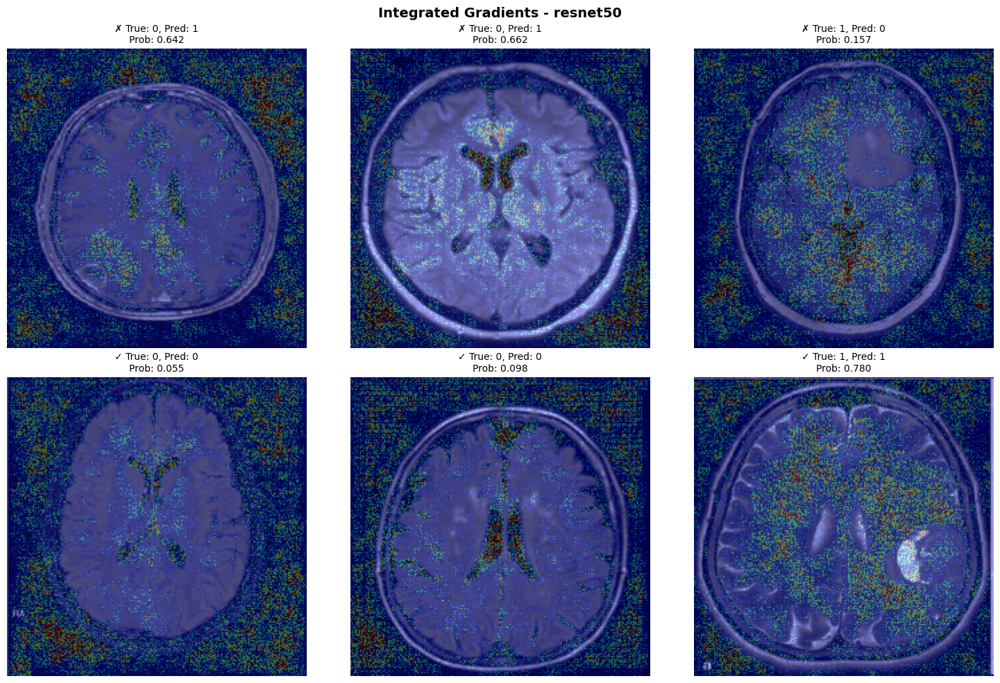


Generating gradcam++ visualizations...


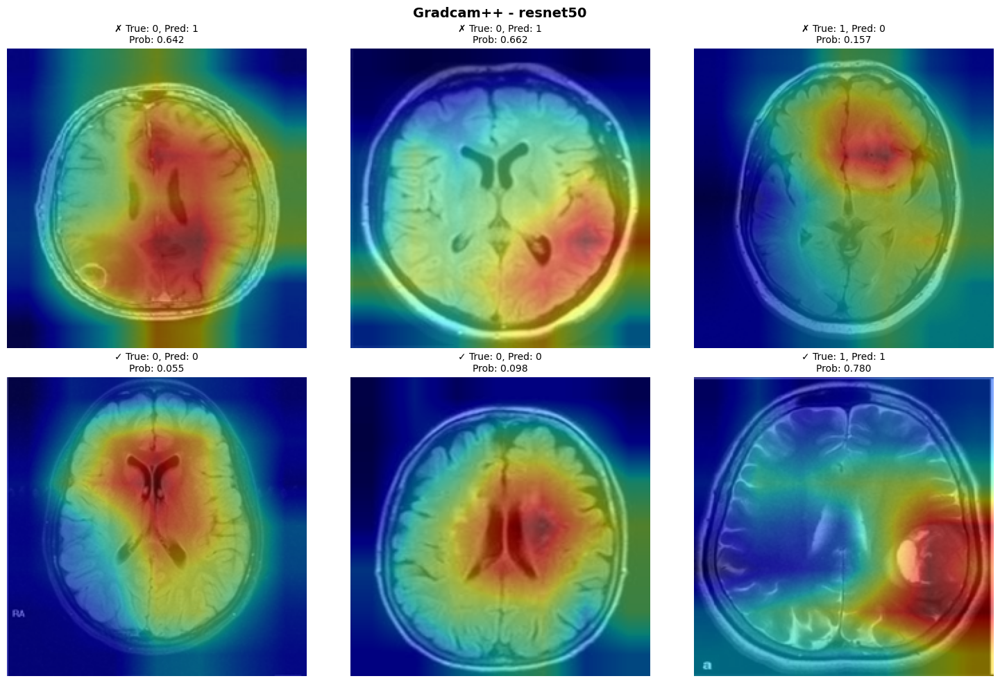


Analysis complete for resnet50!
Results saved to: results/advanced_explainability/resnet50/

Analyzing efficientnet_b0 with advanced explainability methods
Loaded model from /kaggle/input/best_efficientnet_b0_model/pytorch/default/1/best_efficientnet_b0_model.pth
Selecting samples for analysis...
Selected 6 samples for visualization

Generating integrated_gradients visualizations...


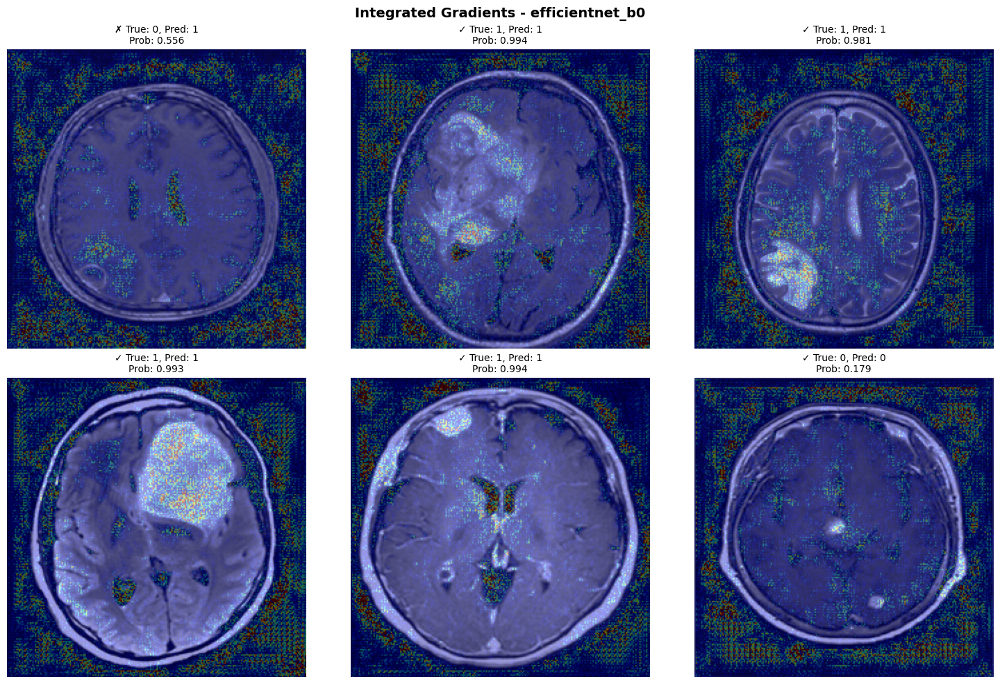


Generating gradcam++ visualizations...


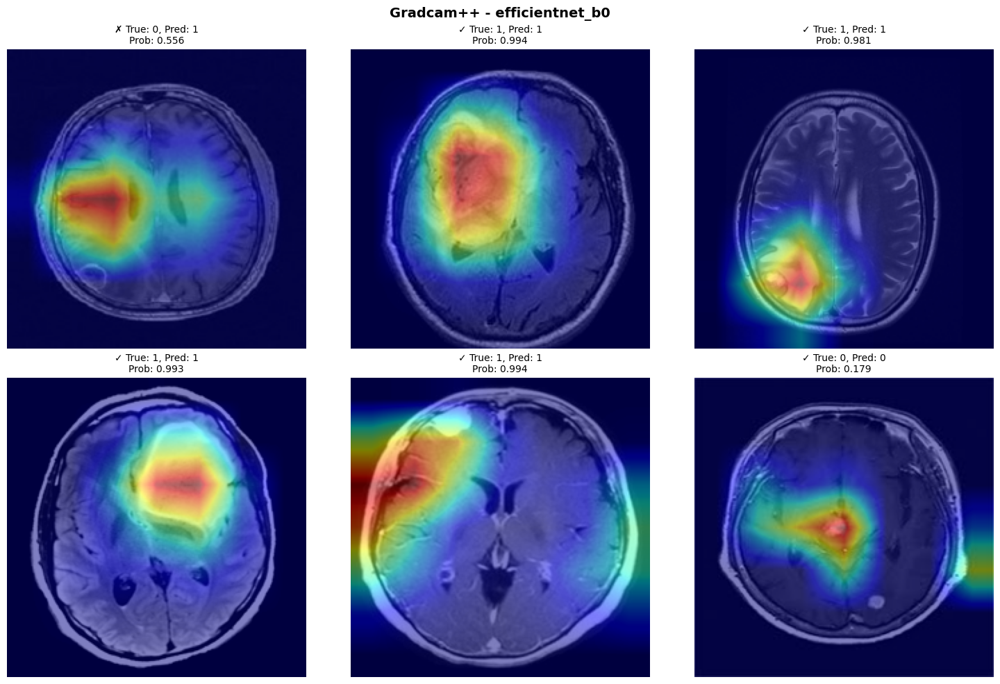


Analysis complete for efficientnet_b0!
Results saved to: results/advanced_explainability/efficientnet_b0/

Analyzing densenet121 with advanced explainability methods
Loaded model from /kaggle/input/best_densenet121_model/pytorch/default/1/best_densenet121_model.pth
Selecting samples for analysis...
Selected 6 samples for visualization

Generating integrated_gradients visualizations...


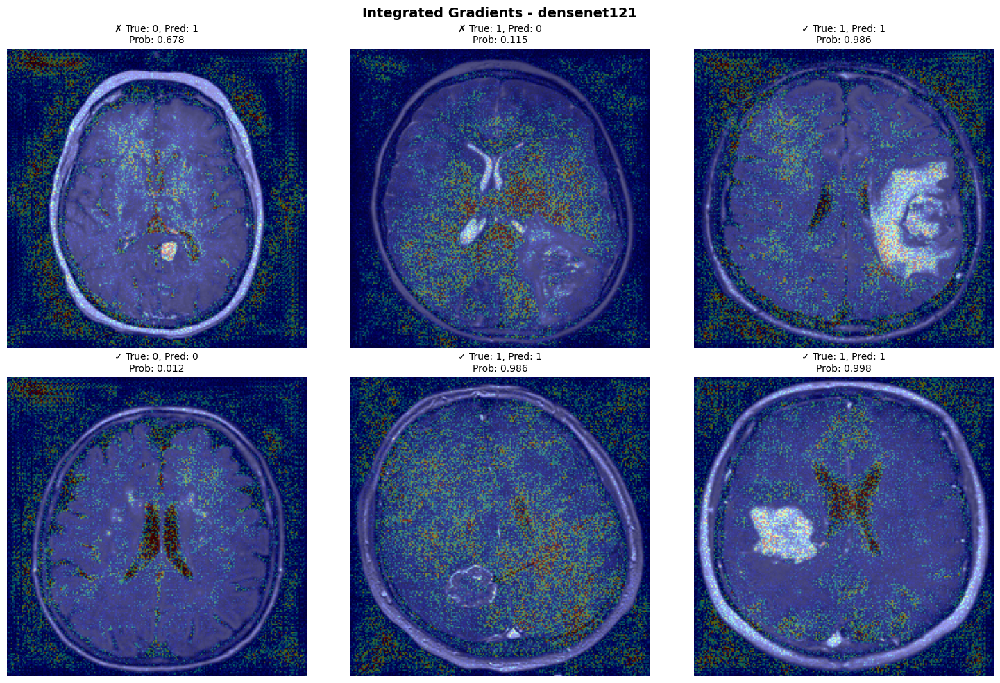


Generating gradcam++ visualizations...


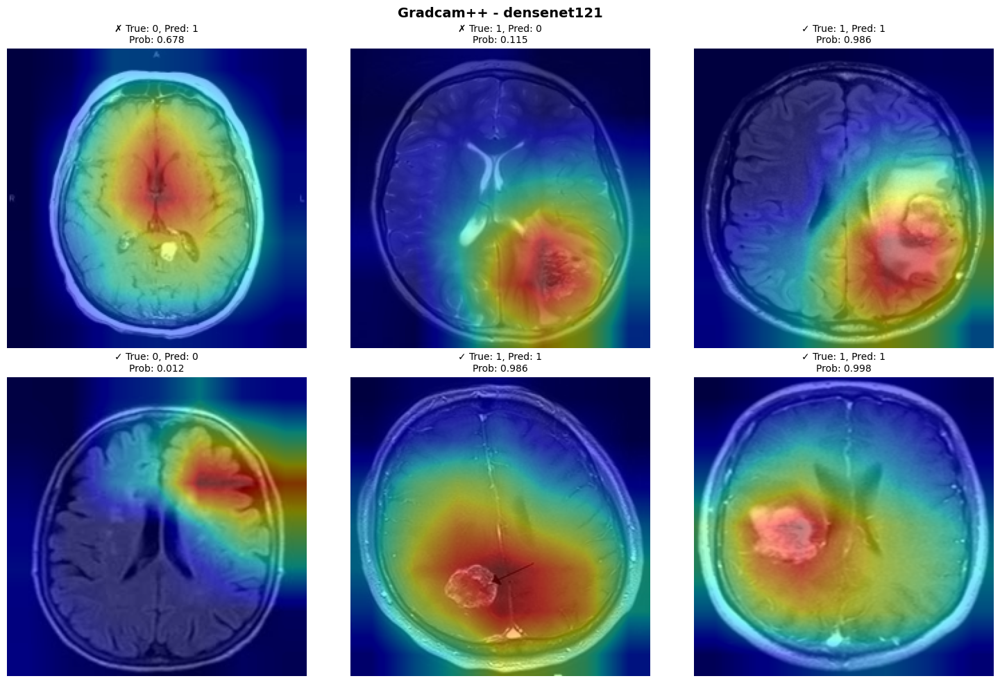


Analysis complete for densenet121!
Results saved to: results/advanced_explainability/densenet121/

ALL MODELS ANALYZED
Total models: 3
Output directory: results/advanced_explainability/


In [108]:
if __name__ == "__main__":
    
    
    
    # Load your test dataframe
    test_df = pd.read_csv('/kaggle/working/results/data/test_df.csv')  # or use your prepared test_df
    
    # Define model configurations

    model_configs = [
        {'path': 'best_resnet50_model.pth', 'arch': 'resnet50'},
        {'path': 'best_efficientnet_b0_model.pth', 'arch': 'efficientnet_b0'},
        {'path': 'best_densenet121_model.pth', 'arch': 'densenet121'}
    ]
    
    # Analyze all models
    results = analyze_all_models(
        model_configs=model_configs,
        test_df=test_df,
        num_samples=6,
        device='cuda'
    )
    """
    # Or analyze single model
    result = analyze_model_with_advanced_methods(
        model_path='best_resnet50_model.pth',
        architecture='resnet50',
        test_df=test_df,
        num_samples=6,
        methods=['integrated_gradients', 'gradcam++'],
        device='cuda'
    )
    """

    pass

Results

In [109]:
for root, dirs, files in os.walk("results"):
    level = root.replace("results", "").count(os.sep)
    indent = " " * 4 * (level)
    print(f"{indent}{os.path.basename(root)}/")
    subindent = " " * 4 * (level + 1)
    for f in files:
        print(f"{subindent}{f}")

results/
    tables/
        top_Mutual_info_classif.csv
        error_analysis_densenet121.csv
        top_5_predictive_features.csv
        false_negatives_densenet121.csv
        class_distribution.csv
        false_negatives_efficientnet_b0.csv
        error_analysis_efficientnet_b0.csv
        classification_report.csv
        false_negatives_resnet50.csv
        false_positives_resnet50.csv
        redundant_features.csv
        top_recursive_feature_elimination.csv
        top_tree_based_feature.csv
        error_analysis_resnet50.csv
        image_data_head.csv
        classification_report_resnet50.txt
        consensus_top_features.csv
        classification_report_densenet121.txt
        false_positives_densenet121.csv
        false_positives_efficientnet_b0.csv
        top_univariate_statistical.csv
        classification_report_efficientnet_b0.txt
    advanced_explainability/
        resnet50/
            gradcam++_3_t0_p0_No18.jpg
            integrated_gradients_1_t0_p1_

# Documentation

In [115]:
# Paths
BASE_DIR = "results"
PLOTS_DIR = os.path.join(BASE_DIR, "plots")
TABLES_DIR = os.path.join(BASE_DIR, "tables")
EXPLAIN_DIR = os.path.join(BASE_DIR, "advanced_explainability")

# Create doc
doc = Document()

# --- Cover Page ---
doc.add_heading("MRI Brain Scan Classifier Report", 0)
doc.add_paragraph("Models: ResNet-50, DenseNet-121, EfficientNet-B0")
doc.add_paragraph("Dataset: Brain MRI Images")
doc.add_paragraph("Author: KaiClone\nDate: 2025")

doc.add_page_break()

# --- Introduction ---
doc.add_heading("1. Introduction", level=1)
doc.add_paragraph("This report presents the results of classifying brain MRI scans "
                  "into Tumor vs No Tumor categories using three deep learning architectures: "
                  "ResNet-50, DenseNet-121, and EfficientNet-B0. "
                  "We include exploratory data analysis (EDA), model evaluation metrics, "
                  "explainability results, and error analysis.")

# --- EDA Section ---
doc.add_heading("2. Exploratory Data Analysis (EDA)", level=1)
eda_images = [
    "class_distribution.png",
    "image_dimensions_distribution.png",
    "aspect_ratio_distribution.png",
    "average_intensity_distribution.png",
    "contrast_distribution_by_class.png",
    "intensity_distribution_by_class.png",
    "image_noise_distribution.png",
    "image_sharpness_distribution.png",
    "tsne_projection.png",
    "pca_top_5_features.png"
]

for img in eda_images:
    path = os.path.join(PLOTS_DIR, img)
    if os.path.exists(path):
        doc.add_paragraph(img.replace("_", " ").replace(".png", "").title())
        doc.add_picture(path, width=Inches(5.5))
        doc.add_paragraph("")  # spacing

doc.add_page_break()

# --- Model Evaluation ---
models = ["resnet50", "densenet121", "efficientnet_b0"]

for model in models:
    doc.add_heading(f"3. Model Evaluation – {model.upper()}", level=1)
    
    # Confusion matrix
    cm_path = os.path.join(PLOTS_DIR, f"confusion_matrix_{model}.png")
    if os.path.exists(cm_path):
        doc.add_paragraph("Confusion Matrix:")
        doc.add_picture(cm_path, width=Inches(5))
    
    # Classification report
    cr_path = os.path.join(TABLES_DIR, f"classification_report_{model}.txt")
    if os.path.exists(cr_path):
        doc.add_paragraph("Classification Report:")
        with open(cr_path, "r") as f:
            doc.add_paragraph(f.read())
    
    # Error analysis
    ea_path = os.path.join(TABLES_DIR, f"error_analysis_{model}.csv")
    if os.path.exists(ea_path):
        doc.add_paragraph("Error Analysis (first 10 rows):")
        df = pd.read_csv(ea_path).head(10)
        table = doc.add_table(rows=1, cols=len(df.columns))
        table.style = "Light List Accent 1"
        hdr_cells = table.rows[0].cells
        for i, col in enumerate(df.columns):
            hdr_cells[i].text = col
        for _, row in df.iterrows():
            row_cells = table.add_row().cells
            for i, col in enumerate(df.columns):
                row_cells[i].text = str(row[col])

    doc.add_page_break()

# --- Explainability Section ---
doc.add_heading("4. Explainability (Grad-CAM & Integrated Gradients)", level=1)

for model in models:
    doc.add_heading(model.upper(), level=2)
    model_dir = os.path.join(EXPLAIN_DIR, model)

    if os.path.exists(model_dir):
        # Expected combined images
        combined_images = [
            ("gradcam++_combined.png", "Grad-CAM++ visualization for"),
            ("integrated_gradients_combined.png", "Integrated Gradients visualization for")
        ]

        for img_name, caption_text in combined_images:
            img_path = os.path.join(model_dir, img_name)
            if os.path.exists(img_path):
                # Add subheading before the image
                doc.add_paragraph(img_name.replace("_combined.png", "").replace("_", " ").title())

                # Add the image
                doc.add_picture(img_path, width=Inches(5.5))

                # Add centered caption below
                last_paragraph = doc.paragraphs[-1]
                last_paragraph.alignment = WD_ALIGN_PARAGRAPH.CENTER

                caption = doc.add_paragraph(f"Figure: {caption_text} {model.upper()}")
                caption.alignment = WD_ALIGN_PARAGRAPH.CENTER
                caption.style = 'Caption'
    else:
        doc.add_paragraph("Explainability images not found for this model.")

    doc.add_page_break()


# --- Model Comparison ---
doc.add_heading("5. Model Comparison", level=1)
comp_path = os.path.join(TABLES_DIR, "model_comparison.csv")
if os.path.exists(comp_path):
    df = pd.read_csv(comp_path)
    table = doc.add_table(rows=1, cols=len(df.columns))
    table.style = "Light List Accent 2"
    hdr_cells = table.rows[0].cells
    for i, col in enumerate(df.columns):
        hdr_cells[i].text = col
    for _, row in df.iterrows():
        row_cells = table.add_row().cells
        for i, col in enumerate(df.columns):
            row_cells[i].text = str(row[col])

# --- Conclusion ---
doc.add_heading("6. Conclusion", level=1)
doc.add_paragraph("EfficientNet-B0 achieved the highest accuracy (97.7%) and perfect AUC (1.0), "
                  "outperforming ResNet-50 and DenseNet-121. "
                  "Explainability methods such as Grad-CAM++ and Integrated Gradients confirm "
                  "that the models focus on relevant tumor regions. "
                  "This system demonstrates high reliability in brain tumor detection, "
                  "but future work should include multi-class classification and external validation.")

# Save document
doc.save("Brain_MRI_Classification_Report.docx")

print("✅ Report generated: Brain_MRI_Classification_Report.docx")

✅ Report generated: Brain_MRI_Classification_Report.docx
